In [1]:
from utils import get_global_config, get_waveform_path, get_base_time, get_ending_time, plot_waveform

from pyspark.sql.functions import datediff, to_date, max as max_, lit, col, collect_list, row_number, concat_ws, format_number, concat, monotonically_increasing_id
from pyspark.sql import SparkSession
from pyspark.sql.types import *
from pyspark.sql.window import Window
import pyspark.sql.functions as F
from pyspark.pandas.frame import DataFrame
import pyspark.pandas as ps
from pyspark.sql.functions import to_timestamp

import os
import glob
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import wfdb


/Users/michaelscott/opt/anaconda3/envs/bd4hproject/lib/python3.9/site-packages/pyspark/pandas/__init__.py:49: UserWarning: 'PYARROW_IGNORE_TIMEZONE' environment variable was not set. It is required to set this environment variable to '1' in both driver and executor sides if you use pyarrow>=2.0.0. pandas-on-Spark will set it for you but it does not work if there is a Spark context already launched.
  warnings.warn(


In [2]:
spark = SparkSession.builder.appName('Read CSV File into DataFrame').\
            config("spark.executor.cores","8").\
            config("spark.driver.cores","2").\
            config("spark.driver.memory","2g").\
            config("spark.executor.memory","4g").\
            config("spark.sql.shuffle.partitions","4").\
            config("spark.sql.execution.arrow.pyspark.enabled", "true").\
            config("spark.sql.files.maxPartitionBytes", "128m").\
            getOrCreate()

# sc = spark.sparkContext

cfg = get_global_config()

# from utils import build_spark_session
# spark = build_spark_session()

23/04/14 15:10:58 WARN Utils: Your hostname, Michaels-MacBook-Pro.local resolves to a loopback address: 127.0.0.1; using 192.168.1.103 instead (on interface en0)
23/04/14 15:10:58 WARN Utils: Set SPARK_LOCAL_IP if you need to bind to another address


Setting default log level to "WARN".
To adjust logging level use sc.setLogLevel(newLevel). For SparkR, use setLogLevel(newLevel).


23/04/14 15:10:59 WARN NativeCodeLoader: Unable to load native-hadoop library for your platform... using builtin-java classes where applicable


In [3]:
# DATAPATH = '../data' 
# MIMICPATH = DATAPATH + '/mimic3/mimic-iii-clinical-database-1.4'
# DEMOPATH = DATAPATH + '/mimic3/mimic-iii-clinical-database-demo-1.4'
# WAVEFPATH = DATAPATH + '/waveform/physionet.org/files/mimic3wdb-matched/1.0'
# CHANNEL_NAMES = ['HR','RESP','PULSE','etco2', 'SpO2', 'CVP','AWRR', 'NBP Mean',  'NBP Dias', 'NBP Sys']
# # CARD_ICD_9 =["4275", "4271", "42741", "42742", "99.60", "99.63", "99.62", "38.97", "96.04", "39.66", "39.95", "41.92", "96.70", "96.71", "96.72"]
# EXPLOREPATH = './output'

In [48]:
# def get_waveform_path(record_id):
#     patient_id = f'{record_id[0:7]}'
#     return cfg['WAVEFPATH'] + f'/{patient_id[0:3]}/{patient_id}/{record_id}'

# def patientid_to_path(patientid):
#     "Convert 20 to p00/p000020/"
#     return f'p{patientid:06d}'

# def plot_waveform(record_name = 'p087675-2104-12-05-03-53n', ca_time_str = '2104-12-05 08:40:00'):
#     # Get waveform data
#     patient_path = get_waveform_path(record_name)
#     record = wfdb.rdrecord(patient_path, channel_names=cfg['CHANNEL_NAMES'])

#     # Select only HR from the plots, not with the channels parameter
#     fig = wfdb.plot_wfdb(record=record, title=record_name[0:7], figsize=(10,15), return_fig=True)
#     ax_list = fig.axes

#     # get time when recording started
#     base_time = datetime.datetime.combine(record.__dict__['base_date'], 
#                             record.__dict__['base_time'])

#     # Create datetime using strptime
#     ca_time = datetime.datetime.strptime(ca_time_str, '%Y-%m-%d %H:%M:%S')

#     # find time delta between base_time and ca_time
#     # Convert it to an int that represents the number of seconds
#     time_delta = int((ca_time - base_time).total_seconds())

#     # Plot a vertical line at time_delta
#     if time_delta > 0:
#         for ax in ax_list:
#             ax.axvline(x=time_delta, color='red', linestyle='--',)
#     else:
#         # change title of fig
#         fig.suptitle('Cardiac Arrest Time is before the start of the recording')

#     fig.show()

#     display(record.__dict__)

# def get_base_time(record_name='p087675-2104-12-05-03-53n'):
#     basetime = record_name[8:]
#     basetime = basetime.strip().strip('n')
#     return basetime

# def get_ending_time(record_name = 'p087675-2104-12-05-03-53n'):
#     # Get waveform data
#     patient_path = get_waveform_path(record_name)
#     record = wfdb.rdrecord(patient_path, channel_names=CHANNEL_NAMES)
    
#     # get time when recording started
#     base_time = datetime.datetime.combine(record.__dict__['base_date'], 
#                             record.__dict__['base_time'])
    
#     duration = record.__dict__['sig_len'] * (1/record.__dict__['fs']) 

#     # Add duration to base time
#     end_time = base_time + datetime.timedelta(seconds=duration)

#     record_present = [0 for i in range(len(CHANNEL_NAMES))]

#     # One hot encode the presence of signals
#     for idx, val in enumerate(CHANNEL_NAMES):
#         if val in record.__dict__['sig_name']:
#             record_present[idx] = 1

#     return end_time, record_present

In [21]:
# # Data cleaning and preprocessing 
# # Creating the dataframe for noteevents
# # NOTEEVENTS do not have datetime, so it is our job to find the datetime from the NOTEEVENTS 
# # Here's the hoping that this is not 
# NOTEEVENTS_ORIG = pd.read_csv(f'{MIMICPATH}/NOTEEVENTS_ORIG.csv.gz',usecols=['ROW_ID','CHARTTIME'], parse_dates=['CHARTTIME'])

# # drop rows with null from NOTEEVENTS_ORIG
# NOTEEVENTS_ORIG = NOTEEVENTS_ORIG.dropna()

# # Export to path
# # NOTEEVENTS_ORIG.to_csv(f'{MIMICPATH}/NOTEEVENTS_TIME.csv.gz', index=False, compression='gzip')

KeyboardInterrupt: 

In [5]:
def read_into_pyspark(file, schema=None, cache=False):
    if not schema:
        df=spark.read.csv(f'file:/{cfg["MIMICPATH"]}/{file}.csv.gz', header=True, inferSchema=True)
    else:
        df=spark.read.csv(f'file:/{cfg["MIMICPATH"]}/{file}.csv.gz', header=True, schema=schema)
    if cache:
        df.cache()
    df.createOrReplaceTempView(file)
    return df

In [6]:
chartevents_schema = StructType([
    StructField('ROW_ID', IntegerType(), True),
    StructField('SUBJECT_ID', IntegerType(), True),
    StructField('HADM_ID', IntegerType(), True),
    StructField('ICUSTAY_ID', IntegerType(), True),
    StructField('ITEMID', IntegerType(), True),
    StructField('CHARTTIME', TimestampType(), True),
    StructField('STORETIME', TimestampType(), True),
    StructField('CGID', IntegerType(), True),
    StructField('VALUE', StringType(), True),
    StructField('VALUENUM', FloatType(), True),
    StructField('VALUEUOM', StringType(), True),
    StructField('WARNING', IntegerType(), True),
    StructField('ERROR', IntegerType(), True),
    StructField('RESULTSTATUS', StringType(), True),
    StructField('STOPPED', StringType(), True)
])


d_icd_procedures_schema = StructType([
    StructField('ROW_ID', IntegerType(), True),
    StructField('ICD9_CODE', StringType(), True),
    StructField('SHORT_TITLE', StringType(), True),
    StructField('LONG_TITLE', StringType(), True)
])


# Create schema for DATETIMEEVENTS 
datetimeevents_schema = StructType([
    StructField("ROW_ID", IntegerType(), True),
    StructField("SUBJECT_ID", IntegerType(), True),
    StructField("HADM_ID", IntegerType(), True),
    StructField("ICUSTAY_ID", IntegerType(), True),
    StructField("ITEMID", IntegerType(), True),
    StructField("CHARTTIME", TimestampType(), True),
    StructField("STORETIME", TimestampType(), True),
    StructField("CGID", IntegerType(), True),
    StructField("VALUE", StringType(), True),
    StructField("VALUEUOM", StringType(), True),
    StructField("WARNING", IntegerType(), True),
    StructField("ERROR", IntegerType(), True),
    StructField("RESULTSTATUS", StringType(), True),
    StructField("STOPPED", StringType(), True)
])

noteevents_schema = StructType([
    StructField("ROW_ID", IntegerType(), True),
    StructField("SUBJECT_ID", IntegerType(), True),
    StructField("HADM_ID", IntegerType(), True),
    StructField("CHARTDATE", TimestampType(), True),
    # StructField("CHARTTIME", TimestampType(), True),
    # StructField("STORETIME", TimestampType(), True),
    StructField("CATEGORY", StringType(), True),
    StructField("DESCRIPTION", StringType(), True),
    StructField("CGID", IntegerType(), True),
    StructField("ISERROR", StringType(), True),
    StructField("TEXT", StringType(), True)
])

# create schema for noteevents_time
noteevents_time_schema = StructType([
    StructField("ROW_ID", IntegerType(), True),
    StructField("CHARTTIME", TimestampType(), True)
])

# create schema for PATIENTS_BASETIME
patientsbasetime_schema = StructType([
    StructField("SUBJECT_ID", IntegerType(), True),
    StructField("BASETIME", StringType(), True),
    StructField("RECORDNAME", StringType(), True)

])

patientsendtime_schema = StructType([
    StructField("SUBJECT_ID", IntegerType(), True),
    StructField("RECORDNAME", StringType(), True),
    StructField("FINISHTIME", StringType(), True),
    StructField("HR", IntegerType(), True),
    StructField("RESP", IntegerType(), True),
    StructField("PULSE", IntegerType(), True),
    StructField("etco2", IntegerType(), True),
    StructField("SpO2", IntegerType(), True),
    StructField("CVP", IntegerType(), True),
    StructField("AWRR", IntegerType(), True),
    StructField("NBP_MEAN", IntegerType(), True),
    StructField("NBP_DIAS", IntegerType(), True),
    StructField("NBp_SYS", IntegerType(), True)
                ])

# Create schema for datetimeevents
datetimeevents_schema = StructType([
    StructField("ROW_ID", IntegerType(), True),
    StructField("SUBJECT_ID", IntegerType(), True),
    StructField("HADM_ID", IntegerType(), True),
    StructField("ICUSTAY_ID", IntegerType(), True),
    StructField("ITEMID", IntegerType(), True),
    StructField("CHARTTIME", TimestampType(), True),
    StructField("STORETIME", TimestampType(), True),
    StructField("CGID", IntegerType(), True),
    StructField("VALUE", StringType(), True),
    StructField("VALUEUOM", StringType(), True),
    StructField("WARNING", IntegerType(), True),
    StructField("ERROR", IntegerType(), True),
    StructField("RESULTSTATUS", StringType(), True),
    StructField("STOPPED", StringType(), True)
])


# create schema for all remaining tables in alphebetical order in one go


In [7]:
ADMISSIONS = read_into_pyspark('ADMISSIONS')
# CALLOUT = read_into_pyspark('CALLOUT')
CHARTEVENTS = read_into_pyspark('CHARTEVENTS', schema=chartevents_schema)
CPTEVENTS = read_into_pyspark('CPTEVENTS')
DIAGNOSES_ICD = read_into_pyspark('DIAGNOSES_ICD')
DATETIMEEVENTS = read_into_pyspark('DATETIMEEVENTS',datetimeevents_schema)
D_ICD_DIAGNOSES = read_into_pyspark('D_ICD_DIAGNOSES', schema=d_icd_procedures_schema)
D_ICD_PROCEDURES = read_into_pyspark('D_ICD_PROCEDURES', schema=d_icd_procedures_schema)
D_ITEMS = read_into_pyspark('D_ITEMS')
# ICUSTAYS = read_into_pyspark('ICUSTAYS')
# INPUTEVENTS_CV = read_into_pyspark('INPUTEVENTS_CV')
# INPUTEVENTS_MV = read_into_pyspark('INPUTEVENTS_MV')
# LABEVENTS = read_into_pyspark('LABEVENTS')
NOTEEVENTS = read_into_pyspark('NOTEEVENTS', schema=noteevents_schema) #this is a modified version of noteevents that is cleaned
NOTEEVENTS_TIME = read_into_pyspark('NOTEEVENTS_TIME', schema=noteevents_time_schema) #this is a modified version of noteevents that is cleaned
# OUTPUTEVENTS = read_into_pyspark('OUTPUTEVENTS')
PATIENTS = read_into_pyspark('PATIENTS')
# PRESCRIPTIONS = read_into_pyspark('PRESCRIPTIONS')
PROCEDUREEVENTS_MV = read_into_pyspark('PROCEDUREEVENTS_MV')
PROCEDURES_ICD = read_into_pyspark('PROCEDURES_ICD')
# SERVICES = read_into_pyspark('SERVICES')
# TRANSFERS = read_into_pyspark('TRANSFERS')


In [ ]:
# diag_df = ps.read_csv(f'{MIMICPATH}/DIAGNOSES_ICD.csv.gz',compression='gzip')
# admissions_df = ps.read_csv(f'{cfg["MIMICPATH"]}/ADMISSIONS.csv.gz', compression='gzip')
# icu_df = ps.read_csv(f'{cfg["MIMICPATH"]}/ICUSTAYS.csv.gz', compression='gzip')
# patients_df = ps.read_csv(f'{MIMICPATH}/PATIENTS.csv.gz', compression='gzip')
# procedures_df = ps.read_csv(f'{MIMICPATH}/PROCEDURES_ICD.csv.gz', compression='gzip')
# procedures_mv_df = ps.read_csv(f'{MIMICPATH}/PROCEDUREEVENTS_MV.csv.gz', compression='gzip')
# d_items_df = ps.read_csv(f'{MIMICPATH}/D_ITEMS.csv.gz', compression='gzip')

# diag_df = spark.read.csv(f'{MIMICPATH}/DIAGNOSES_ICD.csv.gz', header=True, inferSchema=True)
# admissions_df = spark.read.csv(f'{MIMICPATH}/ADMISSIONS.csv.gz', header=True, inferSchema=True)
# icu_df = spark.read.csv(f'{MIMICPATH}/ICUSTAYS.csv.gz', header=True, inferSchema=True)
# patients_df = spark.read.csv(f'{MIMICPATH}/PATIENTS.csv.gz', header=True, inferSchema=True)
# procedures_df = spark.read.csv(f'{MIMICPATH}/PROCEDURES_ICD.csv.gz', header=True, inferSchema=True)
# procedures_mv_df = spark.read.csv(f'{MIMICPATH}/PROCEDUREEVENTS_MV.csv.gz', header=True, inferSchema=True)
# d_items_df = spark.read.csv(f'{MIMICPATH}/D_ITEMS.csv.gz', header=True, inferSchema=True)
# d_icd_diagnoses = spark.read.csv(f'{MIMICPATH}/D_ICD_DIAGNOSES.csv.gz', header=True, inferSchema=True)


In [30]:
# Find matched patients
# The file "/Users/michaelscott/bd4h/project/data/waveform/physionet.org/files/mimic3wdb-matched/1.0/RECORDS"
# contains a list of all the records in the waveform database.
# Each line is "p00/p000085/"
# Now, extract all the patient IDs that are present in this file
# and that will be used to filter all the other tables.

from pyspark.sql.functions import substring

# Read the RECORDS file as a text file and split each line into patient IDs
# convert string to int
patient_ids = spark.read.text(f"file://{cfg['WAVEFPATH']}/RECORDS") \
                    .select(substring("value", 6, 6).alias("SUBJECT_ID")) \
                    .selectExpr("CAST(SUBJECT_ID AS INT) AS SUBJECT_ID")\
                    .distinct()

patient_ids.createOrReplaceTempView('matched_patients')
# Show the first 10 patient IDs in the DataFrame
patient_ids.show(10)

# Use the patient IDs to filter another PySpark table
# other_table_filtered = other_table.join(patient_ids, on="patient_id", how="inner")

# Get all patient_id from matched_patients as a list
patientid = patient_ids.select('SUBJECT_ID').rdd.flatMap(lambda x: x).collect()

+----------+
|SUBJECT_ID|
+----------+
|        52|
|       107|
|       109|
|       135|
|       177|
|       263|
|       292|
|       308|
|       317|
|       328|
+----------+
only showing top 10 rows



In [123]:
# # Download the RECORDS file of all patients in matched dataset
# def patientid_to_path(patientid):
#     # "Convert 20 to p00/p000020/"
#     return f'p{patientid:06d}'

# cmd = f"cd .. "
# idx=50
# # Download all the patient records in parallel
# while idx <= len(patientid) -1:
#     patient = patientid_to_path(patientid[idx])
#     cmd += f"&& /Users/michaelscott/opt/anaconda3/bin/wget -r -N -c -q -np https://physionet.org/files/mimic3wdb-matched/1.0/{patient[0:3]}/{patient}/RECORDS -P data/waveform"
#     idx+=1
#     if idx%50==0:
#         # os.system(cmd)
#         process = subprocess.Popen(cmd, shell=True)
#         cmd = f"cd .. "


In [61]:
# "/Users/michaelscott/bd4h/project/data/waveform/physionet.org/files/mimic3wdb-matched/1.0/p00/p009332/RECORDS"
# For each RECORDS file, open each file. Each file should start off with a few lines that has the following format:
# p000000-YYYY-MM-DD-HH-MM or p000000-YYYY-MM-DD-HH-MMn where n is a literal n
# Then, retrieve each line. Save "p000000" and "YYYY-MM-DD-HH-MM" as a row in a pyspark table
# where patient_id is the first 7 letters of each string (p000000), and basedate is the "YYYY-MM-DD-HH-MM"

record_files = glob.glob(F'{cfg["WAVEFPATH"]}/**/**/RECORDS')

# Initialize an empty list to store the rows
patientsbasetime_rows = set()

# Iterate over each RECORDS file
for file in record_files:
    # Read each file
    with open(file, 'r') as f:
        lines = f.readlines()
        
    # Find records with the desired format and extract patient_id and basedate
    for line in lines:
        if line.startswith('p') and '-' in line and 'n' in line:
            # Retrieve only the numeric data
            patient_id = int(line[1:7])
            basetime = get_base_time(line)

            # Add the row to the list
            patientsbasetime_rows.add((patient_id, basetime, line.strip('\n')))

patientsbasetime_rows = list(patientsbasetime_rows)

# Convert the list of rows to a PySpark DataFrame
PATIENT_BASETIME = spark.createDataFrame(patientsbasetime_rows, patientsbasetime_schema)
PATIENT_BASETIME = PATIENT_BASETIME.withColumn("BASETIME", to_timestamp(PATIENT_BASETIME['BASETIME'], 'yyyy-MM-dd-HH-mm'))

# Show the DataFrame
PATIENT_BASETIME.show()

PATIENT_BASETIME.createOrReplaceTempView('PATIENT_BASETIME')

# PATIENT_BASETIME.coalesce(1).write.csv(f'file://{cfg["EXPLOREPATH"]}/PATIENT_BASETIME', header=True, mode='overwrite')


+----------+-------------------+--------------------+
|SUBJECT_ID|           BASETIME|          RECORDNAME|
+----------+-------------------+--------------------+
|     13850|2164-06-17 18:47:00|p013850-2164-06-1...|
|     58868|2189-03-15 05:55:00|p058868-2189-03-1...|
|     58530|2144-02-18 20:02:00|p058530-2144-02-1...|
|     94162|2172-03-12 22:40:00|p094162-2172-03-1...|
|     51596|2119-07-13 11:12:00|p051596-2119-07-1...|
|     63706|2176-05-08 13:03:00|p063706-2176-05-0...|
|     47118|2126-08-10 00:34:00|p047118-2126-08-1...|
|     31965|2185-02-25 12:36:00|p031965-2185-02-2...|
|     94529|2168-04-18 15:42:00|p094529-2168-04-1...|
|      8072|2160-06-17 13:37:00|p008072-2160-06-1...|
|      5336|2148-04-02 10:54:00|p005336-2148-04-0...|
|     89560|2133-04-23 21:11:00|p089560-2133-04-2...|
|     31061|2181-04-06 14:54:00|p031061-2181-04-0...|
|     20101|2109-02-12 15:31:00|p020101-2109-02-1...|
|     17069|2188-01-15 19:36:00|p017069-2188-01-1...|
|     66772|2185-10-09 13:16

# Use Notes to Obtain Cardiac Arrest Patients
We have obtained TWO very obvious cases of cardiac arrest. Can we get more from non-obvious cases by reading the notes?

In [223]:
# Creating only matched patients
noteevents_matched = spark.sql(""" 
SELECT noteevents.* 
FROM noteevents 
INNER JOIN matched_patients
ON noteevents.SUBJECT_ID = matched_patients.SUBJECT_ID""")
noteevents_matched.createOrReplaceTempView('noteevents_matched')
noteevents_matched.cache()

# convert description to lower case and match against cardiac arrest
noteevents_matched_cardiacarrest = spark.sql("""
SELECT noteevents_matched.*, noteevents_time.CHARTTIME
FROM noteevents_matched
LEFT JOIN noteevents_time
ON noteevents_matched.ROW_ID = noteevents_time.ROW_ID
WHERE lower(DESCRIPTION) LIKE '%cardiac arrest%'
""")                                           
noteevents_matched_cardiacarrest.cache()

# print out the result
noteevents_matched_cardiacarrest.show()

noteevents_matched_cardiacarrest.coalesce(1).write.csv(f'file://{cfg["EXPLOREPATH"]}/noteevents_matched_cardiacarrest', header=True, mode='overwrite')

# First two patients for which we have cardiac arrest data for.
# +------+----------+-------+-------------------+----------+--------------------+-----+-------+--------------------+-------------------+
# |ROW_ID|SUBJECT_ID|HADM_ID|          CHARTDATE|  CATEGORY|         DESCRIPTION| CGID|ISERROR|                TEXT|          CHARTTIME|
# +------+----------+-------+-------------------+----------+--------------------+-----+-------+--------------------+-------------------+
# |481809|     94255| 142254|2139-07-31 00:00:00|Physician |Code Blue, Cardia...|14462|   null|TITLE: Code Blue,...|2139-07-31 14:25:00|
# |651105|     70723| 181992|2163-11-18 00:00:00|Physician |ICU Event Note - ...|19692|   null|TITLE: Cardiac Ar...|2163-11-18 15:06:00|
# +------+----------+-------+-------------------+----------+--------------------+-----+-------+--------------------+-------------------+

23/04/08 01:33:34 WARN CacheManager: Asked to cache already cached data.
23/04/08 01:33:34 WARN CacheManager: Asked to cache already cached data.
+------+----------+-------+-------------------+----------+--------------------+-----+-------+--------------------+-------------------+
|ROW_ID|SUBJECT_ID|HADM_ID|          CHARTDATE|  CATEGORY|         DESCRIPTION| CGID|ISERROR|                TEXT|          CHARTTIME|
+------+----------+-------+-------------------+----------+--------------------+-----+-------+--------------------+-------------------+
|481809|     94255| 142254|2139-07-31 00:00:00|Physician |Code Blue, Cardia...|14462|   null|TITLE: Code Blue,...|2139-07-31 14:25:00|
|651105|     70723| 181992|2163-11-18 00:00:00|Physician |ICU Event Note - ...|19692|   null|TITLE: Cardiac Ar...|2163-11-18 15:06:00|
+------+----------+-------+-------------------+----------+--------------------+-----+-------+--------------------+-------------------+



/var/folders/lc/wjv2l4cd19s4276v_sgzt_q40000gn/T/ipykernel_6192/212398187.py:33: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


{'record_name': 'p070723-2163-11-18-16-28n',
 'n_sig': 5,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 158241,
 'base_time': datetime.time(16, 28, 34),
 'base_date': datetime.date(2163, 11, 18),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'SpO2', 'CVP'],
 'p_signal': array([[nan, nan, nan, nan, nan],
        [nan, nan, nan, nan, nan],
        [nan, nan, nan, nan, nan],
        ...,
        [nan, nan, nan, nan, nan],
        [nan, nan, nan, nan, nan],
        [nan, nan, nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3476173n.dat',
  '3476173n.dat',
  '3476173n.dat',
  '3476173n.dat',
  '3476173n.dat'],
 'fmt': ['16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None],
 'byte_offset': [None, None, None, None, None],
 'adc_gain': [1.0, 1.0, 1.0, 1.0, 1.0],
 'baseline': [0, 0, 0, 0, 0],
 'units': ['bpm', 'pm', 'bpm', '%', 'mmHg'],
 'adc_re

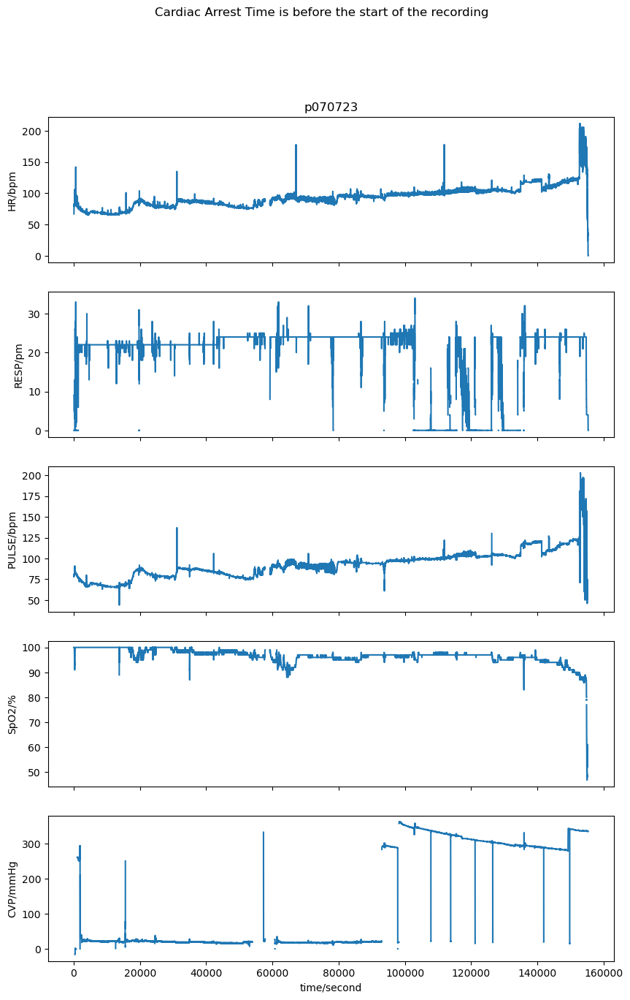

In [52]:
# This patient had cardiac arrest.
# though it states here that cardiac arrest time is before time of recording, it's probably a mismatch
# the patient died at the end.
plot_waveform(patient_id = 70723, ca_time_str = '2163-11-18 15:06:00', record_name = 'p070723-2163-11-18-16-28n')

/var/folders/lc/wjv2l4cd19s4276v_sgzt_q40000gn/T/ipykernel_6192/212398187.py:33: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


{'record_name': 'p094255-2139-07-30-15-58n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 83036,
 'base_time': datetime.time(15, 58, 59),
 'base_date': datetime.date(2139, 7, 30),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3175813n.dat',
  '3175813n.dat',
  '3175813n.dat',
  '3175813n.dat',
  '3175813n.dat',
  '3175813n.dat',
  '3175813n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_

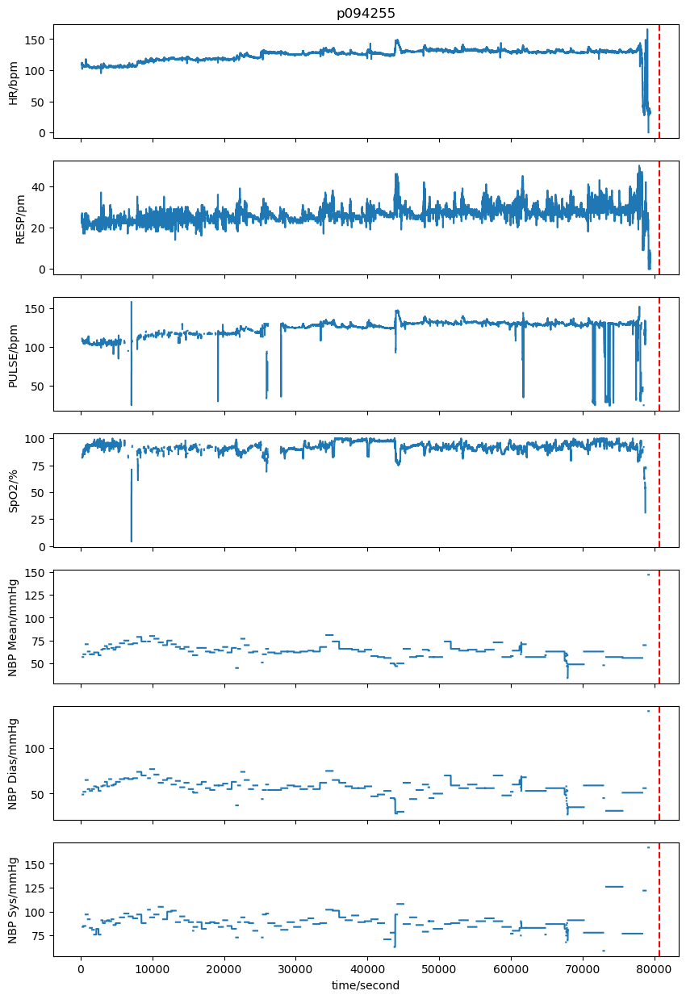

In [51]:
# This patient had cardiac arrest
plot_waveform(patient_id = 94255, ca_time_str = '2139-07-31 14:25:00', record_name = 'p094255-2139-07-30-15-58n')

In [23]:
# This proves that the dataframe is now correct!
# # Creating only matched patients
# noteevents_cardiacarrest = spark.sql(""" 
# SELECT noteevents.* 
# FROM noteevents 
# WHERE lower(DESCRIPTION) LIKE '%cardiac arrest%'""")
# noteevents_cardiacarrest.createOrReplaceTempView('noteevents_cardiacarrest')
# noteevents_cardiacarrest.cache()
# noteevents_cardiacarrest.show()
# noteevents_cardiacarrest.unpersist()

23/04/07 14:51:36 WARN CacheManager: Asked to cache already cached data.
+------+----------+-------+-------------------+----------+--------------------+-----+-------+--------------------+
|ROW_ID|SUBJECT_ID|HADM_ID|          CHARTDATE|  CATEGORY|         DESCRIPTION| CGID|ISERROR|                TEXT|
+------+----------+-------+-------------------+----------+--------------------+-----+-------+--------------------+
|364507|     28206| 122503|2198-01-29 00:00:00|Physician |ICU Event Note - ...|19692|   null|TITLE: Cardiac Ar...|
|391100|     21885| 133139|2142-09-14 00:00:00|   General|Cardiac Arrest Co...|18991|   null|TITLE: Cardiac Ar...|
|391094|     21885| 133139|2142-09-14 00:00:00|   General|Cardiac Arrest Co...|18991|   null|TITLE: Cardiac Ar...|
|481809|     94255| 142254|2139-07-31 00:00:00|Physician |Code Blue, Cardia...|14462|   null|TITLE: Code Blue,...|
|506120|     77439| 110528|2148-12-02 00:00:00|   General|Cardiac Arrest Co...|18991|   null|TITLE: Cardiac Ar...|
|651105

DataFrame[ROW_ID: int, SUBJECT_ID: int, HADM_ID: int, CHARTDATE: timestamp, CATEGORY: string, DESCRIPTION: string, CGID: int, ISERROR: string, TEXT: string]

In [36]:
# convert description to lower case and match against cardiac arrest
noteevents_matched_cardiac_desc = spark.sql("""
SELECT noteevents_matched.*
FROM noteevents_matched
WHERE lower(TEXT) LIKE '%cardiac arrest%'
""")                                           
noteevents_matched_cardiac_desc.cache()
noteevents_matched_cardiac_desc.createOrReplaceTempView('noteevents_matched_cardiac_desc')
noteevents_matched_cardiac_desc.show()
noteevents_matched_cardiac_desc.coalesce(1).write.csv(f'file://{cfg["EXPLOREPATH"]}/noteevents_matched_cardiac_desc', header=True, mode='overwrite')

# More matches!

23/04/07 15:07:20 WARN CacheManager: Asked to cache already cached data.
+------+----------+-------+-------------------+-----------------+-----------+----+-------+--------------------+
|ROW_ID|SUBJECT_ID|HADM_ID|          CHARTDATE|         CATEGORY|DESCRIPTION|CGID|ISERROR|                TEXT|
+------+----------+-------+-------------------+-----------------+-----------+----+-------+--------------------+
|   840|     31171| 131318|2121-03-26 00:00:00|Discharge summary|     Report|null|   null|Admission Date:  ...|
|   861|     31171| 162332|2121-05-27 00:00:00|Discharge summary|     Report|null|   null|Admission Date:  ...|
|   863|     31171| 109882|2121-11-10 00:00:00|Discharge summary|     Report|null|   null|Admission Date:  ...|
|  1657|     72270| 195344|2181-06-19 00:00:00|Discharge summary|     Report|null|   null|Admission Date:  ...|
|  1181|     25016| 100805|2146-02-09 00:00:00|Discharge summary|     Report|null|   null|Admission Date:  ...|
|   968|     72584| 160386|2200

In [42]:
# convert description to lower case and match against cardiac arrest
noteevents_matched_cardiac_desc_time = spark.sql("""
SELECT noteevents_matched_cardiac_desc.*, noteevents_time.charttime
FROM noteevents_matched_cardiac_desc
LEFT JOIN noteevents_time
ON noteevents_matched_cardiac_desc.ROW_ID = noteevents_time.ROW_ID
""")                                           
# noteevents_matched_cardiac_desc_time.cache()
noteevents_matched_cardiac_desc_time.show()
noteevents_matched_cardiac_desc_time.coalesce(1).write.csv(f'file://{cfg["EXPLOREPATH"]}/noteevents_matched_cardiac_desc_time', header=True, mode='overwrite')

# however it is not guaranteed that there is a time 

+------+----------+-------+-------------------+-----------------+-----------+----+-------+--------------------+---------+
|ROW_ID|SUBJECT_ID|HADM_ID|          CHARTDATE|         CATEGORY|DESCRIPTION|CGID|ISERROR|                TEXT|charttime|
+------+----------+-------+-------------------+-----------------+-----------+----+-------+--------------------+---------+
|   840|     31171| 131318|2121-03-26 00:00:00|Discharge summary|     Report|null|   null|Admission Date:  ...|     null|
|   968|     72584| 160386|2200-04-02 00:00:00|Discharge summary|     Report|null|   null|Admission Date:  ...|     null|
|  1752|     20190| 137000|2139-06-09 00:00:00|Discharge summary|     Report|null|   null|Admission Date:  ...|     null|
|  2066|     20190| 119716|2138-07-31 00:00:00|Discharge summary|     Report|null|   null|Admission Date:  ...|     null|
|   861|     31171| 162332|2121-05-27 00:00:00|Discharge summary|     Report|null|   null|Admission Date:  ...|     null|
|   863|     31171| 1098

In [44]:
noteevents_matched_cardiac_desc_time.drop_duplicates().dropna(subset=['charttime']).coalesce(1).write.csv(f'file://{cfg["EXPLOREPATH"]}/noteevents_matched_cardiac_desc_time', header=True, mode='overwrite')
# show()

+------+----------+-------+-------------------+----------+--------------------+-----+-------+--------------------+-------------------+
|ROW_ID|SUBJECT_ID|HADM_ID|          CHARTDATE|  CATEGORY|         DESCRIPTION| CGID|ISERROR|                TEXT|          charttime|
+------+----------+-------+-------------------+----------+--------------------+-----+-------+--------------------+-------------------+
|314883|     29478| 163798|2103-02-24 00:00:00|Physician |Physician Attendi...|15825|   null|"Chief Complaint:...|2103-02-24 10:05:00|
|335248|     29478| 158944|2103-09-15 00:00:00|Physician |Physician Residen...|20952|   null|Chief Complaint: ...|2103-09-15 07:04:00|
|335332|     29478| 158944|2103-09-15 00:00:00|Physician |Physician Residen...|19669|   null|Chief Complaint: ...|2103-09-15 07:04:00|
|343180|     31171| 109882|2121-11-01 00:00:00|   Nursing|Nursing Progress ...|16948|   null|34 y/o F w/ exten...|2121-11-01 10:40:00|
|343207|     31171| 109882|2121-11-01 00:00:00|   Nursi

# checking notes for the keyword "pulmonary arrest"

In [56]:
## Get "Pulmonary arrest"
noteevents_matched_pulm_desc = spark.sql("""
SELECT noteevents_matched.*, noteevents_time.CHARTTIME
FROM noteevents_matched
LEFT JOIN noteevents_time
ON noteevents_matched.ROW_ID = noteevents_time.ROW_ID
WHERE lower(TEXT) LIKE '%pulmonary arrest%'
""")                                           
noteevents_matched_pulm_desc.cache()
noteevents_matched_pulm_desc.createOrReplaceTempView('noteevents_matched_pulm_desc')
noteevents_matched_pulm_desc.show()
noteevents_matched_pulm_desc.coalesce(1).write.csv(f'file://{cfg["EXPLOREPATH"]}/noteevents_matched_pulm_desc', header=True, mode='overwrite')
23450

23/04/07 15:52:33 WARN MemoryStore: Not enough space to cache rdd_278_0 in memory! (computed 878.1 MiB so far)


+------+----------+-------+-------------------+-----------------+-----------+----+-------+--------------------+---------+
|ROW_ID|SUBJECT_ID|HADM_ID|          CHARTDATE|         CATEGORY|DESCRIPTION|CGID|ISERROR|                TEXT|CHARTTIME|
+------+----------+-------+-------------------+-----------------+-----------+----+-------+--------------------+---------+
|   980|     63359| 137873|2102-03-06 00:00:00|Discharge summary|     Report|null|   null|Admission Date:  ...|     null|
|  1195|     14266| 111581|2100-12-09 00:00:00|Discharge summary|     Report|null|   null|Admission Date:  ...|     null|
|  7075|     55332| 176336|2193-03-28 00:00:00|Discharge summary|     Report|null|   null|Admission Date:  ...|     null|
|  7146|     12508| 137241|2199-05-29 00:00:00|Discharge summary|     Report|null|   null|Admission Date:  ...|     null|
|  8542|     21265| 140906|2152-07-25 00:00:00|Discharge summary|     Report|null|   null|Admission Date:  ...|     null|
| 10900|      4655| 1292

23450

In [ ]:
# One potential patient
plot_waveform(patient_id = 23450, ca_time_str = '2139-07-31 14:25:00', record_name = 'p094255-2139-07-30-15-58n')

# Start with patients in the PROCEDURESMV

In [27]:
# Relevant codes
ICD9_CODE_CARD = "('4275', '4271', '42741', '42742', '9960', '9963', '9962', '3897', '9604', '3966', '3995', '4192', '9670', '9671', '9672')"

spark.sql(f"""SELECT * 
FROM D_ICD_DIAGNOSES
WHERE ICD9_CODE IN {ICD9_CODE_CARD}""").show()

spark.sql(f"""SELECT * 
FROM D_ICD_PROCEDURES
WHERE ICD9_CODE IN {ICD9_CODE_CARD}""").show()

+------+---------+--------------------+--------------------+
|ROW_ID|ICD9_CODE|         SHORT_TITLE|          LONG_TITLE|
+------+---------+--------------------+--------------------+
|  4460|     4271|Parox ventric tac...|Paroxysmal ventri...|
|  4464|    42741|Ventricular fibri...|Ventricular fibri...|
|  4465|    42742| Ventricular flutter| Ventricular flutter|
|  4466|     4275|      Cardiac arrest|      Cardiac arrest|
|  4541|     3897|Deaf, nonspeaking...|Deaf, nonspeaking...|
| 11414|     9962|Malfun neuro devi...|Mechanical compli...|
| 10401|     9604|Poisoning-tetracy...|Poisoning by tetr...|
| 11337|     9670|Poisoning-barbitu...|Poisoning by barb...|
| 11338|     9671|Poisoning-chloral...|Poisoning by chlo...|
| 11339|     9672|Poisoning-paralde...|Poisoning by para...|
+------+---------+--------------------+--------------------+

+------+---------+--------------------+--------------------+
|ROW_ID|ICD9_CODE|         SHORT_TITLE|          LONG_TITLE|
+------+---------+-----

In [32]:
diag_matched_icd9 = spark.sql(f"""SELECT * 
FROM DIAGNOSES_ICD
INNER JOIN MATCHED_PATIENTS
ON DIAGNOSES_ICD.SUBJECT_ID = MATCHED_PATIENTS.SUBJECT_ID
WHERE DIAGNOSES_ICD.ICD9_CODE IN {ICD9_CODE_CARD}""")
diag_matched_icd9.cache()
diag_matched_icd9.show()


+------+----------+-------+-------+---------+----------+
|ROW_ID|SUBJECT_ID|HADM_ID|SEQ_NUM|ICD9_CODE|SUBJECT_ID|
+------+----------+-------+-------+---------+----------+
|   635|        79| 181542|      2|     4271|        79|
|   212|        30| 104557|      5|     4271|        30|
|  2417|       194| 124794|      5|     4275|       194|
|  2418|       194| 124794|      6|     4271|       194|
|  3745|       318| 193264|      3|    42741|       318|
|  1383|       109| 189332|     10|     4275|       109|
|  4317|       357| 145674|     10|     4271|       357|
|  3927|       333| 160548|      2|     4271|       333|
|  5198|       427| 101274|      4|     4271|       427|
|  5795|       491| 157083|      4|     4275|       491|
|  7669|       668| 166245|      2|     4275|       668|
|  8127|       710| 114242|      3|     4275|       710|
|  6396|       543| 115307|      2|     4275|       543|
|  6398|       543| 115307|      4|    42741|       543|
|  6399|       543| 115307|    

# 3. Use Procedures to match cardiac arrest

In [43]:
# These are all the patients with cardiac arrest and their timing
procedures_matched = spark.sql("""SELECT PROCEDUREEVENTS_MV.* 
FROM PROCEDUREEVENTS_MV 
INNER JOIN MATCHED_PATIENTS 
ON PROCEDUREEVENTS_MV.SUBJECT_ID = MATCHED_PATIENTS.SUBJECT_ID
""")
procedures_matched.cache()

procedures_matched_cardio = spark.sql("""SELECT PROCEDUREEVENTS_MV.* 
FROM PROCEDUREEVENTS_MV 
INNER JOIN MATCHED_PATIENTS 
ON PROCEDUREEVENTS_MV.SUBJECT_ID = MATCHED_PATIENTS.SUBJECT_ID
WHERE ITEMID == 225466 -- This is cardiac arrest 
ORDER BY SUBJECT_ID, STARTTIME
""")
procedures_matched_cardio.show() 
procedures_matched_cardio.createOrReplaceTempView('procedures_matched_cardio')
procedures_matched_cardio.coalesce(1).write.csv(f'file://{cfg["EXPLOREPATH"]}/procedures_matched_cardio', header=True, mode='overwrite')


23/04/14 16:14:08 WARN CacheManager: Asked to cache already cached data.


+------+----------+-------+----------+-------------------+-------------------+------+-----+--------+--------+----------------+-------------------+-----+-------+-----------+------------------+--------------------------+------------------------+---------+------------------+------------+-----------------+-----------------+-------------------+-------------------+
|ROW_ID|SUBJECT_ID|HADM_ID|ICUSTAY_ID|          STARTTIME|            ENDTIME|ITEMID|VALUE|VALUEUOM|LOCATION|LOCATIONCATEGORY|          STORETIME| CGID|ORDERID|LINKORDERID| ORDERCATEGORYNAME|SECONDARYORDERCATEGORYNAME|ORDERCATEGORYDESCRIPTION|ISOPENBAG|CONTINUEINNEXTDEPT|CANCELREASON|STATUSDESCRIPTION|COMMENTS_EDITEDBY|COMMENTS_CANCELEDBY|      COMMENTS_DATE|
+------+----------+-------+----------+-------------------+-------------------+------+-----+--------+--------+----------------+-------------------+-----+-------+-----------+------------------+--------------------------+------------------------+---------+------------------+----

## 3.1 Match procedures with records that might be close enough.
In a later section 3.1.1 I will attempt to find data that is outside of here

In [34]:
# Find patients with a corresponding record
procedures_matched_cardio_waveform = spark.sql("""SELECT 
PROCEDUREEVENTS_MV.ROW_ID,
PROCEDUREEVENTS_MV.SUBJECT_ID,
PROCEDUREEVENTS_MV.HADM_ID,
PROCEDUREEVENTS_MV.ICUSTAY_ID,
PROCEDUREEVENTS_MV.STARTTIME,
-- PROCEDUREEVENTS_MV.ENDTIME, ignore this endtime (always 1 minute from starttime)
PROCEDUREEVENTS_MV.ITEMID,
PATIENT_BASETIME.BASETIME,
datediff(PROCEDUREEVENTS_MV.STARTTIME,PATIENT_BASETIME.BASETIME) DIFF,
PATIENT_BASETIME.RECORDNAME 

FROM PROCEDUREEVENTS_MV 
INNER JOIN MATCHED_PATIENTS 
ON PROCEDUREEVENTS_MV.SUBJECT_ID = MATCHED_PATIENTS.SUBJECT_ID
INNER JOIN PATIENT_BASETIME
ON PROCEDUREEVENTS_MV.SUBJECT_ID = PATIENT_BASETIME.SUBJECT_ID
AND datediff(PROCEDUREEVENTS_MV.STARTTIME,PATIENT_BASETIME.BASETIME) > -1
AND datediff(PROCEDUREEVENTS_MV.STARTTIME,PATIENT_BASETIME.BASETIME) < 1
WHERE ITEMID == 225466 -- This is cardiac arrest 
ORDER BY SUBJECT_ID, STARTTIME
""")

procedures_matched_cardio_waveform.cache()
procedures_matched_cardio_waveform.show()
procedures_matched_cardio_waveform.coalesce(1).write.csv(f'file://{cfg["EXPLOREPATH"]}/procedures_matched_cardio_waveform', header=True, mode='overwrite')
procedures_matched_cardio_waveform.createOrReplaceTempView('procedures_matched_cardio_waveform')

+------+----------+-------+----------+-------------------+------+-------------------+----+--------------------+
|ROW_ID|SUBJECT_ID|HADM_ID|ICUSTAY_ID|          STARTTIME|ITEMID|           BASETIME|DIFF|          RECORDNAME|
+------+----------+-------+----------+-------------------+------+-------------------+----+--------------------+
|217566|     41035| 127416|    227118|2135-02-06 16:27:00|225466|2135-02-06 08:02:00|   0|p041035-2135-02-0...|
|236493|     43926| 185036|    270489|2197-05-14 17:28:00|225466|2197-05-14 15:06:00|   0|p043926-2197-05-1...|
|181921|     44298| 134239|    226807|2187-06-28 19:00:00|225466|2187-06-28 23:57:00|   0|p044298-2187-06-2...|
|181922|     44298| 134239|    226807|2187-06-28 19:10:00|225466|2187-06-28 23:57:00|   0|p044298-2187-06-2...|
|253841|     46154| 163315|    252848|2196-07-29 06:00:00|225466|2196-07-29 02:30:00|   0|p046154-2196-07-2...|
|232536|     46927| 185997|    297284|2130-03-10 16:28:00|225466|2130-03-10 11:48:00|   0|p046927-2130-0

Nice, we can download these and use them as labeled data.

In [152]:
patients_w_waveform = procedures_matched_cardio_waveform.select('SUBJECT_ID').rdd.flatMap(lambda x: x).collect()
patients_w_waveform = list(set(patients_w_waveform))

In [153]:
print(patients_w_waveform)

[44298, 63762, 43926, 86678, 83873, 54183, 99756, 52529, 96305, 82104, 96060, 70723, 46154, 41035, 46927, 82512, 50015, 60659, 62323, 56697, 87675]


In [61]:
# # Bringing this elsewhere to run
# patients_w_waveform = [44298, 63762, 43926, 86678, 83873, 54183, 99756, 52529, 96305, 82104, 96060, 70723, 46154, 41035, 46927, 82512, 50015, 60659, 62323, 56697, 87675]

# #  Download the waveform file of all patients in matched dataset
# cmd = f"cd .. "
# idx=0
# # Download all the patient records in parallel
# while idx <= len(patients_w_waveform) -1:
#     patient = patientid_to_path(patients_w_waveform[idx])
#     cmd += f"&& /Users/michaelscott/opt/anaconda3/bin/wget -r -N -c -np https://physionet.org/files/mimic3wdb-matched/1.0/{patient[0:3]}/{patient}/ -P data/waveform"
#     if idx%10==0:
#         print(f'Done with {idx}!')
#         process = subprocess.Popen(cmd, shell=True)
#     idx+=1  

# process = subprocess.Popen(cmd, shell=True)


In [35]:
# Now that we've downloaded the files, we can determine the ending time of the file
relevant_records = procedures_matched_cardio_waveform.select('RECORDNAME').rdd.flatMap(lambda x:x).collect()
print(relevant_records)

['p041035-2135-02-06-08-02n', 'p043926-2197-05-14-15-06n', 'p044298-2187-06-28-23-57n', 'p044298-2187-06-28-23-57n', 'p046154-2196-07-29-02-30n', 'p046927-2130-03-10-11-48n', 'p050015-2138-12-20-19-42n', 'p052529-2184-03-10-13-16n', 'p052529-2184-03-10-11-01n', 'p054183-2165-09-27-20-05n', 'p056697-2164-08-21-06-43n', 'p060659-2128-05-24-01-01n', 'p062323-2189-10-01-00-11n', 'p063762-2181-12-04-03-58n', 'p063762-2181-12-04-07-51n', 'p063762-2181-12-04-03-58n', 'p063762-2181-12-04-07-51n', 'p063762-2181-12-04-03-58n', 'p063762-2181-12-04-07-51n', 'p070723-2163-11-18-16-28n', 'p082104-2177-04-29-16-16n', 'p082512-2114-12-22-08-46n', 'p082512-2114-12-22-09-16n', 'p083873-2143-04-16-06-49n', 'p086678-2196-06-07-00-34n', 'p087675-2104-12-05-03-53n', 'p096060-2112-12-16-14-20n', 'p096305-2158-11-01-12-24n', 'p099756-2191-12-23-02-00n', 'p099756-2191-12-23-02-00n']


In [98]:
def get_record(record_name):
    patient_path = get_waveform_path(record_name)
    return wfdb.rdrecord(patient_path, channel_names=cfg['CHANNEL_NAMES'])

def get_ending_time(record_name):
	"""Ending time is the end time of a record"""
	# Get waveform data
	record = get_record(record_name)
	
	# # Version1: Retrieve the ending time as the time using basetime + numrecords
	# # get time when recording started
	# base_time = datetime.datetime.combine(record.__dict__['base_date'], 
	#                         record.__dict__['base_time'])
	
	# duration = record.__dict__['sig_len'] * (1/record.__dict__['fs']) 

	# # Add duration to base time
	# end_time = base_time + datetime.timedelta(seconds=duration)
	
	# # Version 2: Retrieve the ending time as the final valid index in the dataframe
	# I think this is more accurate. We'll go with this.
	record_df = record.to_dataframe()
	
	end_time = record_df.last_valid_index().strftime('%Y-%m-%d-%H-%M')

	record_present = [0 for i in range(len(cfg['CHANNEL_NAMES']))]

	# One hot encode the presence of signals
	for idx, val in enumerate(cfg['CHANNEL_NAMES']):
		if val in record.__dict__['sig_name']:
			record_present[idx] = 1

	return end_time, record_present

In [102]:
relevant_records = ['p041035-2135-02-06-08-02n',
 'p043926-2197-05-14-15-06n',
 'p044298-2187-06-28-23-57n',
 'p044298-2187-06-28-23-57n',
 'p046154-2196-07-29-02-30n',
 'p046927-2130-03-10-11-48n',
 'p050015-2138-12-20-19-42n',
 'p052529-2184-03-10-13-16n',
 'p052529-2184-03-10-11-01n',
 'p054183-2165-09-27-20-05n',
 'p056697-2164-08-21-06-43n',
 'p060659-2128-05-24-01-01n',
 'p062323-2189-10-01-00-11n',
 'p063762-2181-12-04-03-58n',
 'p063762-2181-12-04-07-51n',
 'p063762-2181-12-04-03-58n',
 'p063762-2181-12-04-07-51n',
 'p063762-2181-12-04-03-58n',
 'p063762-2181-12-04-07-51n',
 'p070723-2163-11-18-16-28n',
 'p082104-2177-04-29-16-16n',
 'p082512-2114-12-22-09-16n',
 'p082512-2114-12-22-08-46n',
 'p083873-2143-04-16-06-49n',
 'p086678-2196-06-07-00-34n',
 'p087675-2104-12-05-03-53n',
 'p096060-2112-12-16-14-20n',
 'p096305-2158-11-01-12-24n',
 'p099756-2191-12-23-02-00n',
 'p099756-2191-12-23-02-00n',
 'p070723-2163-11-18-16-28n', 
#  'p094255-2139-07-30-15-58n' # manually added
 ]

# Initialize an empty list to store the rows
patientsendtime_rows = []

# Iterate over each RECORDS file
for record in relevant_records:
    try:
        # get ending time of the record
        endtime, record_present_arr = get_ending_time(record)

        # Retrieve only the numeric data
        patient_id = int(record[1:7])

        # Add the row to the list
        cur_record = [patient_id, record, endtime]
        cur_record.extend(record_present_arr)
        patientsendtime_rows.append(cur_record)
        
    except FileNotFoundError as e:
        print(f'record {record}: {e}')

    except TypeError as e:
        print(f'record {record}: {e}')
    
    except:
        print(f'record {record}')

# Convert the list of rows to a PySpark DataFrame
PATIENT_ENDTIME = spark.createDataFrame(patientsendtime_rows, patientsendtime_schema)
PATIENT_ENDTIME = PATIENT_ENDTIME.withColumn("FINISHTIME", to_timestamp(PATIENT_ENDTIME['FINISHTIME'], 'yyyy-MM-dd-HH-mm'))

# Show the DataFrame
PATIENT_ENDTIME.show()
PATIENT_ENDTIME.createOrReplaceTempView('PATIENT_ENDTIME')
PATIENT_ENDTIME.cache()
PATIENT_ENDTIME.coalesce(1).write.csv(f'file://{cfg["EXPLOREPATH"]}/PATIENT_ENDTIME', header=True, mode='overwrite')


# next step: 
# 1. Continue from here, and set up a table where you can retrieve 
# the start time and end time and other required properties

# 2. Move this file, and all data to within docker 
# /Users/michaelscott/bd4h/project/streaming-env/time-series-kafka-demo/data/waveform/physionet.org/files/mimic3wdb-matched/1.0/p04/p041035/p041035-2135-02-01-19-56n.hea
# '/Users/michaelscott/bd4h/project/streaming-env/time-series-kafka-demo/data/waveform/physionet.org/files/mimic3wdb-matched/1.0/pp0/pp041035/p041035-2135-02-06-08-02n.hea'

record p063762-2181-12-04-07-51n
record p063762-2181-12-04-07-51n
record p063762-2181-12-04-07-51n
+----------+--------------------+-------------------+---+----+-----+-----+----+---+----+--------+--------+-------+
|SUBJECT_ID|          RECORDNAME|         FINISHTIME| HR|RESP|PULSE|etco2|SpO2|CVP|AWRR|NBP_MEAN|NBP_DIAS|NBp_SYS|
+----------+--------------------+-------------------+---+----+-----+-----+----+---+----+--------+--------+-------+
|     41035|p041035-2135-02-0...|2135-02-06 11:14:00|  1|   1|    1|    0|   1|  0|   0|       1|       1|      1|
|     43926|p043926-2197-05-1...|2197-05-17 17:16:00|  1|   1|    1|    0|   0|  1|   0|       0|       0|      0|
|     44298|p044298-2187-06-2...|2187-07-03 14:21:00|  1|   1|    1|    0|   0|  1|   0|       0|       0|      0|
|     44298|p044298-2187-06-2...|2187-07-03 14:21:00|  1|   1|    1|    0|   0|  1|   0|       0|       0|      0|
|     46154|p046154-2196-07-2...|2196-07-29 06:47:00|  1|   1|    1|    0|   1|  0|   0|       1

In [41]:
procedures_matched_cardio_waveform_start = spark.sql(F"""select DISTINCT 
procedures_matched_cardio_waveform.*, 
patient_endtime.FINISHTIME,
{','.join([i.replace(' ','_') for i in cfg['CHANNEL_NAMES']])}
from procedures_matched_cardio_waveform
full join PATIENT_ENDTIME
on procedures_matched_cardio_waveform.recordname = PATIENT_ENDTIME.recordname
ORDER BY SUBJECT_ID, STARTTIME
""")

procedures_matched_cardio_waveform_start.show()

# This contains the waveform that we can use to create the training / testing data
procedures_matched_cardio_waveform_start.coalesce(1).write.csv(f'file://{cfg["EXPLOREPATH"]}/procedures_matched_cardio_waveform_start', header=True, mode='overwrite')

procedures_matched_cardio_waveform_start.createOrReplaceTempView('procedures_matched_cardio_waveform_start')

+------+----------+-------+----------+-------------------+------+-------------------+----+--------------------+----------+----+----+-----+-----+----+----+----+--------+--------+-------+
|ROW_ID|SUBJECT_ID|HADM_ID|ICUSTAY_ID|          STARTTIME|ITEMID|           BASETIME|DIFF|          RECORDNAME|FINISHTIME|  HR|RESP|PULSE|etco2|SpO2| CVP|AWRR|NBP_Mean|NBP_Dias|NBP_Sys|
+------+----------+-------+----------+-------------------+------+-------------------+----+--------------------+----------+----+----+-----+-----+----+----+----+--------+--------+-------+
|217566|     41035| 127416|    227118|2135-02-06 16:27:00|225466|2135-02-06 08:02:00|   0|p041035-2135-02-0...|      null|   1|   1|    1|    0|   1|   0|   0|       1|       1|      1|
|236493|     43926| 185036|    270489|2197-05-14 17:28:00|225466|2197-05-14 15:06:00|   0|p043926-2197-05-1...|      null|   1|   1|    1|    0|   0|   1|   0|       0|       0|      0|
|181921|     44298| 134239|    226807|2187-06-28 19:00:00|225466|2187-

In [75]:
cfg["EXPLOREPATH"]

'//Users/michaelscott/bd4h/project/streaming-env/time-series-kafka-demo/explore_output'

In [ ]:
#bookmark

In [56]:
# Find patients with a corresponding record
procedures_matched_cardio_waveform_endtime = spark.sql("""SELECT 
PROCEDUREEVENTS_MV.ROW_ID,
PROCEDUREEVENTS_MV.SUBJECT_ID,
PROCEDUREEVENTS_MV.HADM_ID,
PROCEDUREEVENTS_MV.ICUSTAY_ID,
PROCEDUREEVENTS_MV.STARTTIME,
PROCEDUREEVENTS_MV.ENDTIME,
PROCEDUREEVENTS_MV.ITEMID,
PATIENT_BASETIME.BASETIME,
datediff(PROCEDUREEVENTS_MV.STARTTIME,PATIENT_BASETIME.BASETIME) DIFF,
PATIENT_BASETIME.RECORDNAME,
PATIENT_ENDTIME.*

FROM PROCEDUREEVENTS_MV 
INNER JOIN MATCHED_PATIENTS 
ON PROCEDUREEVENTS_MV.SUBJECT_ID = MATCHED_PATIENTS.SUBJECT_ID
INNER JOIN PATIENT_BASETIME
ON PROCEDUREEVENTS_MV.SUBJECT_ID = PATIENT_BASETIME.SUBJECT_ID
AND datediff(PROCEDUREEVENTS_MV.STARTTIME,PATIENT_BASETIME.BASETIME) > -1
AND datediff(PROCEDUREEVENTS_MV.STARTTIME,PATIENT_BASETIME.BASETIME) < 1
LEFT JOIN PATIENT_ENDTIME
ON PATIENT_BASETIME.RECORDNAME = PATIENT_ENDTIME.RECORDNAME
WHERE ITEMID == 225466 -- This is cardiac arrest 
ORDER BY PROCEDUREEVENTS_MV.SUBJECT_ID, PROCEDUREEVENTS_MV.STARTTIME
""")

procedures_matched_cardio_waveform_endtime.cache()

procedures_matched_cardio_waveform_endtime.show()

procedures_matched_cardio_waveform_endtime.coalesce(1).write.csv(f'file://{cfg["EXPLOREPATH"]}/procedures_matched_cardio_waveform_endtime', header=True, mode='overwrite')


+------+----------+-------+----------+-------------------+-------------------+------+-------------------+----+--------------------+----------+--------------------+----------+----+----+-----+-----+----+----+----+--------+--------+-------+
|ROW_ID|SUBJECT_ID|HADM_ID|ICUSTAY_ID|          STARTTIME|            ENDTIME|ITEMID|           BASETIME|DIFF|          RECORDNAME|SUBJECT_ID|          RECORDNAME|FINISHTIME|  HR|RESP|PULSE|etco2|SpO2| CVP|AWRR|NBP_MEAN|NBP_DIAS|NBp_SYS|
+------+----------+-------+----------+-------------------+-------------------+------+-------------------+----+--------------------+----------+--------------------+----------+----+----+-----+-----+----+----+----+--------+--------+-------+
|217566|     41035| 127416|    227118|2135-02-06 16:27:00|2135-02-06 16:28:00|225466|2135-02-06 08:02:00|   0|p041035-2135-02-0...|     41035|p041035-2135-02-0...|      null|   1|   1|    1|    0|   1|   0|   0|       1|       1|      1|
|236493|     43926| 185036|    270489|2197-05-14

AnalysisException: Found duplicate column(s) when inserting into file:/Users/michaelscott/bd4h/project/streaming-env/time-series-kafka-demo/explore_output/procedures_matched_cardio_waveform_endtime: `recordname`, `subject_id`

In [ ]:
# With this table, I can then extract the waveform data for each patient

In [ ]:
recordname

['p041035-2135-02-06-08-02n',
 'p043926-2197-05-14-15-06n',
 'p044298-2187-06-28-23-57n',
 'p044298-2187-06-28-23-57n',
 'p046154-2196-07-29-02-30n',
 'p046927-2130-03-10-11-48n',
 'p050015-2138-12-20-19-42n',
 'p052529-2184-03-10-13-16n',
 'p052529-2184-03-10-11-01n',
 'p054183-2165-09-27-20-05n',
 'p056697-2164-08-21-06-43n',
 'p060659-2128-05-24-01-01n',
 'p062323-2189-10-01-00-11n',
 'p063762-2181-12-04-03-58n',
 'p063762-2181-12-04-07-51n',
 'p063762-2181-12-04-03-58n',
 'p063762-2181-12-04-07-51n',
 'p063762-2181-12-04-03-58n',
 'p063762-2181-12-04-07-51n',
 'p070723-2163-11-18-16-28n',
 'p082104-2177-04-29-16-16n',
 'p082512-2114-12-22-09-16n',
 'p082512-2114-12-22-08-46n',
 'p083873-2143-04-16-06-49n',
 'p086678-2196-06-07-00-34n',
 'p087675-2104-12-05-03-53n',
 'p096060-2112-12-16-14-20n',
 'p096305-2158-11-01-12-24n',
 'p099756-2191-12-23-02-00n',
 'p099756-2191-12-23-02-00n']

. .......... ......... .......... ..... .......... 77% 4.92K 2m1s
 22700K .......... .............. .......... 77% 4.63K 2m0s
 22750K .......... ........ .......... ............. ............. .......... 77% 64.8K 2m0s
 22750K ... 71% 4.39K 3m5s
 20800K .......... ............. .......... .......... .......... .......... 78% 95.8K 1m59s
 22800K .......... ........... ............. .......... .......... .............. .......... .......... ........ 78% 43.6K 1m59s
 22800K .......... ........ 78%  112K 1m58s
 22850K .......... ... .......... ............. ............. 71% 47.5K 3m4s
 20850K .......... ....... .......... ......... ......... .......... .......... 78% 41.6K 1m57s
 22900K .......... .......... ................ .......... .......... ..... .......... ........... 78% 97.4K 1m56s
 22950K ............ 78% 24.8K 1m59s
 22850K .......... .... ............. 71% 29.8K 3m3s
 20900K ..... .................. .......... . .......... .......... .......... .......... 71% 6.22K 3m6s
 20950

# 3.1.1 Finding more data
Previously, we only found those that are within 24 hours. Let's match the rest and try to find more data.

In [64]:
spark.sql("""SELECT 
*
FROM PATIENT_BASETIME
WHERE PATIENT_BASETIME.subject_id = 21580
""").show()

+----------+-------------------+--------------------+
|SUBJECT_ID|           BASETIME|          RECORDNAME|
+----------+-------------------+--------------------+
|     21580|2127-07-25 18:18:00|p021580-2127-07-2...|
|     21580|2127-07-26 17:47:00|p021580-2127-07-2...|
+----------+-------------------+--------------------+



In [73]:
procedures_matched_cardio_start_3DAYS = spark.sql("""SELECT 
procedures_matched_cardio.*,
PATIENT_BASETIME.BASETIME,
datediff(procedures_matched_cardio.STARTTIME,PATIENT_BASETIME.BASETIME) DIFF,
PATIENT_BASETIME.RECORDNAME

FROM procedures_matched_cardio
INNER JOIN PATIENT_BASETIME
ON procedures_matched_cardio.SUBJECT_ID = PATIENT_BASETIME.SUBJECT_ID
AND datediff(procedures_matched_cardio.STARTTIME,PATIENT_BASETIME.BASETIME) > 0
AND datediff(procedures_matched_cardio.STARTTIME,PATIENT_BASETIME.BASETIME) < 3
WHERE procedures_matched_cardio.SUBJECT_ID NOT IN (SELECT SUBJECT_ID FROM procedures_matched_cardio_waveform_start)
ORDER BY procedures_matched_cardio.SUBJECT_ID
""")
procedures_matched_cardio_start_3DAYS.cache()
procedures_matched_cardio_start_3DAYS.show()
procedures_matched_cardio_start_3DAYS.createOrReplaceTempView('procedures_matched_cardio_start_3DAYS')
# procedures_matched_cardio_start_3DAYS.coalesce(1).write.csv(f'file://{cfg["EXPLOREPATH"]}/procedures_matched_cardio_start_3days', header=True, mode='overwrite')


23/04/14 16:42:56 WARN CacheManager: Asked to cache already cached data.
+------+----------+-------+----------+-------------------+-------------------+------+-----+--------+--------+----------------+-------------------+-----+-------+-----------+------------------+--------------------------+------------------------+---------+------------------+------------+-----------------+-----------------+-------------------+-------------------+-------------------+----+--------------------+
|ROW_ID|SUBJECT_ID|HADM_ID|ICUSTAY_ID|          STARTTIME|            ENDTIME|ITEMID|VALUE|VALUEUOM|LOCATION|LOCATIONCATEGORY|          STORETIME| CGID|ORDERID|LINKORDERID| ORDERCATEGORYNAME|SECONDARYORDERCATEGORYNAME|ORDERCATEGORYDESCRIPTION|ISOPENBAG|CONTINUEINNEXTDEPT|CANCELREASON|STATUSDESCRIPTION|COMMENTS_EDITEDBY|COMMENTS_CANCELEDBY|      COMMENTS_DATE|           BASETIME|DIFF|          RECORDNAME|
+------+----------+-------+----------+-------------------+-------------------+------+-----+--------+--------+--

In [104]:
# Now that we've downloaded the files, we can determine the ending time of the file

relevant_patients = procedures_matched_cardio_start_3DAYS.select('SUBJECT_ID').rdd.flatMap(lambda x:x).collect()
print(relevant_patients)

relevant_records = procedures_matched_cardio_start_3DAYS.select('RECORDNAME').rdd.flatMap(lambda x:x).collect()
print(relevant_records)

[41031, 42075, 42075, 42995, 42995, 46651, 57321, 57321, 57321, 57321, 57321, 58505, 58505, 66093, 68808, 74711, 74711, 74711, 79096, 79096, 81694, 93360, 94255]
['p041031-2183-01-01-21-29n', 'p042075-2166-02-13-17-56n', 'p042075-2166-02-13-17-56n', 'p042995-2178-08-21-16-02n', 'p042995-2178-08-22-16-48n', 'p046651-2145-09-05-05-39n', 'p057321-2135-04-04-18-07n', 'p057321-2135-04-04-18-06n', 'p057321-2135-04-04-05-35n', 'p057321-2135-04-22-02-03n', 'p057321-2135-04-17-20-10n', 'p058505-2126-11-07-02-59n', 'p058505-2126-11-07-22-34n', 'p066093-2175-05-24-23-50n', 'p068808-2101-10-20-21-49n', 'p074711-2161-07-15-22-41n', 'p074711-2161-07-15-14-13n', 'p074711-2161-07-15-07-45n', 'p079096-2133-03-19-21-12n', 'p079096-2133-03-19-21-12n', 'p081694-2105-02-23-20-54n', 'p093360-2196-06-21-22-23n', 'p094255-2139-07-30-15-58n']


In [105]:
spark.createDataFrame(patientsendtime_rows, patientsendtime_schema).show()

+----------+--------------------+----------------+---+----+-----+-----+----+---+----+--------+--------+-------+
|SUBJECT_ID|          RECORDNAME|      FINISHTIME| HR|RESP|PULSE|etco2|SpO2|CVP|AWRR|NBP_MEAN|NBP_DIAS|NBp_SYS|
+----------+--------------------+----------------+---+----+-----+-----+----+---+----+--------+--------+-------+
|     41035|p041035-2135-02-0...|2135-02-06-11-14|  1|   1|    1|    0|   1|  0|   0|       1|       1|      1|
|     43926|p043926-2197-05-1...|2197-05-17-17-16|  1|   1|    1|    0|   0|  1|   0|       0|       0|      0|
|     44298|p044298-2187-06-2...|2187-07-03-14-21|  1|   1|    1|    0|   0|  1|   0|       0|       0|      0|
|     44298|p044298-2187-06-2...|2187-07-03-14-21|  1|   1|    1|    0|   0|  1|   0|       0|       0|      0|
|     46154|p046154-2196-07-2...|2196-07-29-06-47|  1|   1|    1|    0|   1|  0|   0|       1|       1|      1|
|     46927|p046927-2130-03-1...|2130-03-11-13-29|  1|   1|    1|    0|   1|  0|   0|       0|       0| 

In [97]:
endtime

datetime.datetime(2139, 7, 31, 14, 2, 56)

In [190]:
# Initialize an empty list to store the rows
patientsendtime_rows = []

# Iterate over each RECORDS file
for record in relevant_records:
    try:
        # get ending time of the record
        endtime, record_present_arr = get_ending_time(record)

        # Retrieve only the numeric data
        patient_id = int(record[1:7])

        # Add the row to the list
        cur_record = [patient_id, record, endtime]
        cur_record.extend(record_present_arr)
        patientsendtime_rows.append(cur_record)
        
    except FileNotFoundError as e:
        print(f'record {record}: {e}')

    except TypeError as e:
        print(f'record {record}: {e}')
    
    except:
        print(f'record {record}')

# Convert the list of rows to a PySpark DataFrame
PATIENT_ENDTIME_temp = spark.createDataFrame(patientsendtime_rows, patientsendtime_schema)
PATIENT_ENDTIME_temp = PATIENT_ENDTIME_temp.withColumn("FINISHTIME", to_timestamp(PATIENT_ENDTIME_temp['FINISHTIME'], 'yyyy-MM-dd-HH-mm'))

PATIENT_ENDTIME = PATIENT_ENDTIME.union(PATIENT_ENDTIME_temp).distinct().sort('SUBJECT_ID')

# Show the DataFrame
PATIENT_ENDTIME.show()
PATIENT_ENDTIME.createOrReplaceTempView('PATIENT_ENDTIME')
PATIENT_ENDTIME.cache()
PATIENT_ENDTIME.coalesce(1).write.csv(f'file://{cfg["EXPLOREPATH"]}/PATIENT_ENDTIME', header=True, mode='overwrite')

record p058505-2126-11-07-02-59n: [Errno 2] No such file or directory: '//Users/michaelscott/bd4h/project/streaming-env/time-series-kafka-demo/data/waveform/physionet.org/files/mimic3wdb-matched/1.0/p05/p058505/3833962n.dat'
record p058505-2126-11-07-22-34n: [Errno 2] No such file or directory: '//Users/michaelscott/bd4h/project/streaming-env/time-series-kafka-demo/data/waveform/physionet.org/files/mimic3wdb-matched/1.0/p05/p058505/3826882n.dat'
+----------+--------------------+-------------------+---+----+-----+-----+----+---+----+--------+--------+-------+
|SUBJECT_ID|          RECORDNAME|         FINISHTIME| HR|RESP|PULSE|etco2|SpO2|CVP|AWRR|NBP_MEAN|NBP_DIAS|NBp_SYS|
+----------+--------------------+-------------------+---+----+-----+-----+----+---+----+--------+--------+-------+
|     41031|p041031-2183-01-0...|2183-01-02 14:23:00|  1|   1|    1|    0|   1|  0|   0|       1|       1|      1|
|     41035|p041035-2135-02-0...|2135-02-06 11:14:00|  1|   1|    1|    0|   1|  0|   0|  

In [191]:
procedures_matched_cardio_3days_start_end = spark.sql(F"""select DISTINCT 
procedures_matched_cardio_start_3DAYS.*, 
patient_endtime.FINISHTIME,
{','.join([i.replace(' ','_') for i in cfg['CHANNEL_NAMES']])}
from procedures_matched_cardio_start_3DAYS
LEFT JOIN PATIENT_ENDTIME
on procedures_matched_cardio_start_3DAYS.recordname = PATIENT_ENDTIME.recordname
ORDER BY SUBJECT_ID, STARTTIME
""")

procedures_matched_cardio_3days_start_end.show()

# # This contains the waveform that we can use to create the training / testing data
procedures_matched_cardio_3days_start_end.coalesce(1).write.csv(f'file://{cfg["EXPLOREPATH"]}/procedures_matched_cardio_3days_start_end', header=True, mode='overwrite')

procedures_matched_cardio_3days_start_end.createOrReplaceTempView('procedures_matched_cardio_3days_start_end')

+------+----------+-------+----------+-------------------+-------------------+------+-----+--------+--------+----------------+-------------------+-----+-------+-----------+------------------+--------------------------+------------------------+---------+------------------+------------+-----------------+-----------------+-------------------+-------------------+-------------------+----+--------------------+-------------------+----+----+-----+-----+----+----+----+--------+--------+-------+
|ROW_ID|SUBJECT_ID|HADM_ID|ICUSTAY_ID|          STARTTIME|            ENDTIME|ITEMID|VALUE|VALUEUOM|LOCATION|LOCATIONCATEGORY|          STORETIME| CGID|ORDERID|LINKORDERID| ORDERCATEGORYNAME|SECONDARYORDERCATEGORYNAME|ORDERCATEGORYDESCRIPTION|ISOPENBAG|CONTINUEINNEXTDEPT|CANCELREASON|STATUSDESCRIPTION|COMMENTS_EDITEDBY|COMMENTS_CANCELEDBY|      COMMENTS_DATE|           BASETIME|DIFF|          RECORDNAME|         FINISHTIME|  HR|RESP|PULSE|etco2|SpO2| CVP|AWRR|NBP_Mean|NBP_Dias|NBP_Sys|
+------+----------

In [175]:
# process.terminate()

# 3.1.2 Getting CONTROL patients. 
These are essentially any waveforms that we have downloaded but do not appear in the dataset.

In [164]:
eligible_patients_rec.sort()
eligible_patients_rec

['p000194-2112-05-23-14-34n',
 'p017002-2153-04-16-21-38n',
 'p021580-2127-07-25-18-18n',
 'p021580-2127-07-26-17-47n',
 'p024276-2185-04-12-00-18n',
 'p024276-2185-04-12-15-25n',
 'p024276-2185-04-15-15-15n',
 'p026868-2163-03-24-01-35n',
 'p026868-2163-03-25-14-16n',
 'p029299-2192-12-06-20-01n',
 'p029299-2192-12-07-16-13n',
 'p031942-2124-07-02-13-01n',
 'p041031-2183-01-01-21-29n',
 'p041035-2135-02-01-12-56n',
 'p041035-2135-02-01-19-56n',
 'p041035-2135-02-06-08-02n',
 'p042075-2166-02-12-18-07n',
 'p042075-2166-02-13-17-56n',
 'p042525-2125-02-08-14-34n',
 'p042525-2125-02-09-15-29n',
 'p042995-2178-08-21-16-02n',
 'p042995-2178-08-22-16-48n',
 'p043926-2197-05-12-13-05n',
 'p043926-2197-05-14-15-06n',
 'p043926-2197-05-17-17-26n',
 'p043926-2197-05-19-18-15n',
 'p044083-2112-05-04-19-50n',
 'p044083-2112-05-23-12-22n',
 'p044298-2187-06-24-21-12n',
 'p044298-2187-06-28-23-57n',
 'p046057-2202-06-05-00-55n',
 'p046154-2196-07-29-02-30n',
 'p046651-2145-09-05-05-39n',
 'p046651-

{'record_name': 'p059936-2153-03-30-18-00n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 211427,
 'base_time': datetime.time(18, 0, 18),
 'base_date': datetime.date(2153, 3, 30),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[66.,  7., 65., ..., nan, nan, nan],
        [66.,  6., 65., ..., nan, nan, nan],
        [66.,  5., 65., ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3508696n.dat',
  '3508696n.dat',
  '3508696n.dat',
  '3508696n.dat',
  '3508696n.dat',
  '3508696n.dat',
  '3508696n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_

{'record_name': 'p059936-2153-03-19-14-05n',
 'n_sig': 8,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 255099,
 'base_time': datetime.time(14, 5, 26),
 'base_date': datetime.date(2153, 3, 19),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'CVP',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [71., 25., 69., ..., nan, nan, nan],
        [71., 25., 69., ..., nan, nan, nan],
        [71., 25., 69., ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3154213n.dat',
  '3154213n.dat',
  '3154213n.dat',
  '3154213n.dat',
  '3154213n.dat',
  '3154213n.dat',
  '3154213n.dat',
  '3154213n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, No

{'record_name': 'p059936-2153-03-25-09-24n',
 'n_sig': 8,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 269364,
 'base_time': datetime.time(9, 24, 37),
 'base_date': datetime.date(2153, 3, 25),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'CVP',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[69.,  6., 69., ..., nan, nan, nan],
        [69.,  5., 69., ..., nan, nan, nan],
        [69.,  4., 69., ..., nan, nan, nan],
        ...,
        [72., 24., 72., ..., nan, nan, nan],
        [72., 24., 72., ..., nan, nan, nan],
        [72., 24., 72., ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3346823n.dat',
  '3346823n.dat',
  '3346823n.dat',
  '3346823n.dat',
  '3346823n.dat',
  '3346823n.dat',
  '3346823n.dat',
  '3346823n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, No

{'record_name': 'p059936-2153-03-25-09-23n',
 'n_sig': 5,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 69,
 'base_time': datetime.time(9, 23, 8),
 'base_date': datetime.date(2153, 3, 25),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'SpO2', 'CVP'],
 'p_signal': array([[nan, nan, 69., 90., nan],
        [nan, nan, 69., 90., nan],
        [69., nan, 67., 91., nan],
        [69., nan, 66., 91., nan],
        [70., nan, 65., 91., nan],
        [69., nan, 65., 91., 30.],
        [69., nan, 66., 91., 30.],
        [69., nan, 66., 91., 30.],
        [70., nan, 67., 91., 31.],
        [69., nan, 67., 91., 31.],
        [70., nan, 68., 91., 31.],
        [70., 17., 68., 91., 31.],
        [70., 17., 69., 91., 31.],
        [70., 17., 69., 91., 30.],
        [70., 17., 69., 91., 29.],
        [70., 17., 69., 91., 26.],
        [70., 16., 70., 92., 25.],
        [70., 15., 70., 92., 25.],
        [70., 14., 70., 92., 23.],
        [70., 11., 69

{'record_name': 'p059936-2153-04-05-14-42n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 850958,
 'base_time': datetime.time(14, 42, 49),
 'base_date': datetime.date(2153, 4, 5),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[ nan,  nan, 102., ...,  59.,  47., 108.],
        [ nan,  nan, 102., ...,  59.,  47., 108.],
        [ nan,  nan, 102., ...,  59.,  47., 108.],
        ...,
        [ nan,  nan,  nan, ...,  nan,  nan,  nan],
        [ nan,  nan,  nan, ...,  nan,  nan,  nan],
        [ nan,  nan,  nan, ...,  nan,  nan,  nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3621475n.dat',
  '3621475n.dat',
  '3621475n.dat',
  '3621475n.dat',
  '3621475n.dat',
  '3621475n.dat',
  '3621475n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, No

{'record_name': 'p059936-2153-04-02-05-05n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 293013,
 'base_time': datetime.time(5, 5, 36),
 'base_date': datetime.date(2153, 4, 2),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[113.,  nan, 113., ..., 101.,  85., 146.],
        [113.,  nan, 113., ..., 101.,  85., 146.],
        [113.,  nan, 113., ..., 101.,  85., 146.],
        ...,
        [ 83.,  22., 101., ...,  59.,  47., 108.],
        [ 88.,  22., 101., ...,  59.,  47., 108.],
        [ 83.,  22., 102., ...,  59.,  47., 108.]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3190851n.dat',
  '3190851n.dat',
  '3190851n.dat',
  '3190851n.dat',
  '3190851n.dat',
  '3190851n.dat',
  '3190851n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None

{'record_name': 'p052529-2184-04-11-21-49n',
 'n_sig': 8,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 152380,
 'base_time': datetime.time(21, 49, 30, 149000),
 'base_date': datetime.date(2184, 4, 11),
 'comments': ['Location: micu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'CVP',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[76., nan, 75., ..., nan, nan, nan],
        [76., nan, 75., ..., nan, nan, nan],
        [76., nan, 75., ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3874148n.dat',
  '3874148n.dat',
  '3874148n.dat',
  '3874148n.dat',
  '3874148n.dat',
  '3874148n.dat',
  '3874148n.dat',
  '3874148n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None

{'record_name': 'p052529-2184-03-26-12-26n',
 'n_sig': 3,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 9991,
 'base_time': datetime.time(12, 26, 12),
 'base_date': datetime.date(2184, 3, 26),
 'comments': ['Location: tsicu'],
 'sig_name': ['HR', 'RESP', 'PULSE'],
 'p_signal': array([[60.94460659,  9.54572494, 60.44832749],
        [61.13315883, 18.23288022, 60.49976056],
        [61.43333398, 19.10006429, 60.71674384],
        ...,
        [66.01741584, 14.76701538, 65.1994577 ],
        [66.03400844, 15.33365222, 65.40036814],
        [68.31624465, 16.01706218, 66.13328945]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3033487n.dat', '3033487n.dat', '3033487n.dat'],
 'fmt': ['16', '16', '16'],
 'samps_per_frame': [1, 1, 1],
 'skew': [None, None, None],
 'byte_offset': [None, None, None],
 'adc_gain': [662.946276275, 1044.76088112, 622.167751562],
 'baseline': [-53139, -32767, -48321],
 'units': ['bpm', 'pm', 'bpm'

{'record_name': 'p052529-2184-04-04-14-57n',
 'n_sig': 8,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 191608,
 'base_time': datetime.time(14, 57, 2, 149000),
 'base_date': datetime.date(2184, 4, 4),
 'comments': ['Location: micu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'CVP',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3257943n.dat',
  '3257943n.dat',
  '3257943n.dat',
  '3257943n.dat',
  '3257943n.dat',
  '3257943n.dat',
  '3257943n.dat',
  '3257943n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, 

{'record_name': 'p052529-2184-03-18-15-36n',
 'n_sig': 3,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 11220,
 'base_time': datetime.time(15, 36, 12),
 'base_date': datetime.date(2184, 3, 18),
 'comments': ['Location: tsicu'],
 'sig_name': ['HR', 'RESP', 'PULSE'],
 'p_signal': array([[71.99980105, 16.50042638, 72.17024651],
        [72.13405024, 22.09979376, 72.91602608],
        [71.99980105, 21.01629224, 72.66689713],
        ...,
        [63.66730082, 19.33361056, 63.48287886],
        [64.60101147, 16.89956077, 64.33313186],
        [64.03384636, 19.50015584, 63.94899109]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3329332n.dat', '3329332n.dat', '3329332n.dat'],
 'fmt': ['16', '16', '16'],
 'samps_per_frame': [1, 1, 1],
 'skew': [None, None, None],
 'byte_offset': [None, None, None],
 'adc_gain': [662.946276275, 1044.76088112, 622.167751562],
 'baseline': [-53139, -32767, -48321],
 'units': ['bpm', 'pm', 'bpm

{'record_name': 'p052529-2184-03-09-21-31n',
 'n_sig': 3,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 739,
 'base_time': datetime.time(21, 31, 48),
 'base_date': datetime.date(2184, 3, 9),
 'comments': ['Location: sicu'],
 'sig_name': ['HR', 'RESP', 'PULSE'],
 'p_signal': array([[         nan,          nan,  93.99897394],
        [100.83366256,          nan,  93.64959065],
        [ 93.73345231,  21.78932679,  90.61664629],
        ...,
        [ 85.46677895,   6.52632325,  85.59890747],
        [ 86.00062934,  10.69078977,  85.79961702],
        [ 86.00062934,  12.74136195,  86.00032657]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3863292n.dat', '3863292n.dat', '3863292n.dat'],
 'fmt': ['16', '16', '16'],
 'samps_per_frame': [1, 1, 1],
 'skew': [None, None, None],
 'byte_offset': [None, None, None],
 'adc_gain': [749.27358663, 1689.77226109, 538.090979923],
 'baseline': [-70657, -32767, -46219],
 'units': ['bpm

{'record_name': 'p052529-2184-04-08-18-45n',
 'n_sig': 8,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 269977,
 'base_time': datetime.time(18, 45, 13, 149000),
 'base_date': datetime.date(2184, 4, 8),
 'comments': ['Location: micu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'CVP',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3863129n.dat',
  '3863129n.dat',
  '3863129n.dat',
  '3863129n.dat',
  '3863129n.dat',
  '3863129n.dat',
  '3863129n.dat',
  '3863129n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None,

{'record_name': 'p052529-2184-03-11-16-00n',
 'n_sig': 3,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 5085,
 'base_time': datetime.time(16, 0, 12),
 'base_date': datetime.date(2184, 3, 11),
 'comments': ['Location: tsicu'],
 'sig_name': ['HR', 'RESP', 'PULSE'],
 'p_signal': array([[103.5996467 ,   7.99991668, 101.00009176],
        [105.23326323,  12.91683125, 102.49968733],
        [107.23342531,  10.9163735 , 107.0000813 ],
        ...,
        [ 78.00028728,   6.10953197,  77.98379115],
        [ 78.00028728,   5.92192923,  77.99986399],
        [ 78.00028728,   6.44166538,  77.99986399]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3887447n.dat', '3887447n.dat', '3887447n.dat'],
 'fmt': ['16', '16', '16'],
 'samps_per_frame': [1, 1, 1],
 'skew': [None, None, None],
 'byte_offset': [None, None, None],
 'adc_gain': [662.946276275, 1044.76088112, 622.167751562],
 'baseline': [-53139, -32767, -48321],
 'units': ['

{'record_name': 'p052529-2184-03-10-11-01n',
 'n_sig': 3,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 110,
 'base_time': datetime.time(11, 1, 48),
 'base_date': datetime.date(2184, 3, 10),
 'comments': ['Location: sicu'],
 'sig_name': ['HR', 'RESP', 'PULSE'],
 'p_signal': array([[92.37480306,  9.00002938, 92.49922756],
        [91.93304185, 22.3834897 , 90.76903688],
        [91.33379479, 26.11653713, 91.33213868],
        [91.24971335, 29.48326301, 91.54028192],
        [91.01748843, 27.93335001, 90.98275538],
        [91.00013829, 25.5667589 , 90.79877163],
        [91.00013829, 24.28315398, 90.99948118],
        [91.36449118, 29.71761412,         nan],
        [91.33379479, 24.93353748,         nan],
        [91.283079  , 22.81668417, 91.9993121 ],
        [91.16696654, 20.41695251, 92.99914302],
        [91.23369784, 23.31675156, 91.59975142],
        [91.91702634, 22.20003302, 88.99981934],
        [91.86764518, 28.98319562, 89.99965026],
   

{'record_name': 'p052529-2184-04-13-19-55n',
 'n_sig': 4,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 11157,
 'base_time': datetime.time(19, 55, 42),
 'base_date': datetime.date(2184, 4, 13),
 'comments': ['Location: micu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'CVP'],
 'p_signal': array([[80.10025613, 12.67881073, 79.93253679,         nan],
        [79.95540223, 15.9998098 , 79.83195136,         nan],
        [79.34964956, 15.9998098 , 79.57081609,         nan],
        ...,
        [73.01690042, 14.83341013, 72.83352631,         nan],
        [73.46726437, 16.24975259, 73.01535383,         nan],
        [73.85046877, 17.18356661, 72.99987915,         nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3052097n.dat', '3052097n.dat', '3052097n.dat', '3052097n.dat'],
 'fmt': ['16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1],
 'skew': [None, None, None, None],
 'byte_offset': [None, None, None, None],
 'adc_

{'record_name': 'p052529-2184-03-10-13-16n',
 'n_sig': 3,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 1390,
 'base_time': datetime.time(13, 16, 12),
 'base_date': datetime.date(2184, 3, 10),
 'comments': ['Location: tsicu'],
 'sig_name': ['HR', 'RESP', 'PULSE'],
 'p_signal': array([[ 83.74434247,  13.1484632 ,  29.45347128],
        [         nan,          nan,          nan],
        [         nan,          nan,          nan],
        ...,
        [ 99.9673765 ,   0.        ,  99.79945094],
        [100.00056169,   0.        , 100.00036139],
        [100.01715429,   0.        , 100.08233285]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3920444n.dat', '3920444n.dat', '3920444n.dat'],
 'fmt': ['16', '16', '16'],
 'samps_per_frame': [1, 1, 1],
 'skew': [None, None, None],
 'byte_offset': [None, None, None],
 'adc_gain': [662.946276275, 1044.76088112, 622.167751562],
 'baseline': [-53139, -32767, -48321],
 'units': [

{'record_name': 'p052529-2184-03-15-06-39n',
 'n_sig': 3,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 4738,
 'base_time': datetime.time(6, 39, 12),
 'base_date': datetime.date(2184, 3, 15),
 'comments': ['Location: tsicu'],
 'sig_name': ['HR', 'RESP', 'PULSE'],
 'p_signal': array([[81.00053039, 12.50046804, 80.99905512],
        [80.58420706, 16.51669804, 80.03307769],
        [80.00044935, 17.2336085 , 79.88360032],
        ...,
        [65.00074221, 13.66628504, 65.00015454],
        [64.95096442, 16.70047215, 65.00015454],
        [66.00082324, 14.43296765, 65.932379  ]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3434253n.dat', '3434253n.dat', '3434253n.dat'],
 'fmt': ['16', '16', '16'],
 'samps_per_frame': [1, 1, 1],
 'skew': [None, None, None],
 'byte_offset': [None, None, None],
 'adc_gain': [662.946276275, 1044.76088112, 622.167751562],
 'baseline': [-53139, -32767, -48321],
 'units': ['bpm', 'pm', 'bpm']

{'record_name': 'p052529-2184-04-06-21-09n',
 'n_sig': 8,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 159389,
 'base_time': datetime.time(21, 9, 28, 149000),
 'base_date': datetime.date(2184, 4, 6),
 'comments': ['Location: micu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'CVP',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3942327n.dat',
  '3942327n.dat',
  '3942327n.dat',
  '3942327n.dat',
  '3942327n.dat',
  '3942327n.dat',
  '3942327n.dat',
  '3942327n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, 

{'record_name': 'p054183-2165-09-15-16-43n',
 'n_sig': 4,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 3163,
 'base_time': datetime.time(16, 43, 20),
 'base_date': datetime.date(2165, 9, 15),
 'comments': ['Location: micu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'CVP'],
 'p_signal': array([[79.00025218,         nan, 79.00047584,         nan],
        [79.88357863, 22.36242877, 79.58407604,         nan],
        [78.53396089, 18.98299943, 79.16691393,         nan],
        ...,
        [65.46631173, 24.1169804 ,         nan,         nan],
        [65.06733714, 21.38354867,         nan,         nan],
        [71.90080313, 24.4332583 ,         nan,         nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3504912n.dat', '3504912n.dat', '3504912n.dat', '3504912n.dat'],
 'fmt': ['16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1],
 'skew': [None, None, None, None],
 'byte_offset': [None, None, None, None],
 'adc_g

{'record_name': 'p054183-2165-09-13-10-39n',
 'n_sig': 4,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': 250.0,
 'sig_len': 3131,
 'base_time': datetime.time(10, 39, 20),
 'base_date': datetime.date(2165, 9, 13),
 'comments': ['Location: micu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'CVP'],
 'p_signal': array([[92.7492777 , 16.39110205,         nan,         nan],
        [92.92988348, 21.88880261,         nan,         nan],
        [92.46687593, 16.78328665,         nan,         nan],
        ...,
        [81.18394025, 14.15897079, 80.53362664,         nan],
        [80.68316968, 34.08764113, 80.65098683,         nan],
        [81.40066719, 20.33350605, 80.65098683,         nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3898135n.dat', '3898135n.dat', '3898135n.dat', '3898135n.dat'],
 'fmt': ['16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1],
 'skew': [None, None, None, None],
 'byte_offset': [None, None, None, None],
 'adc_

{'record_name': 'p054183-2165-09-27-20-05n',
 'n_sig': 3,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 7669,
 'base_time': datetime.time(20, 5, 56, 343000),
 'base_date': datetime.date(2165, 9, 27),
 'comments': ['Location: ccu'],
 'sig_name': ['HR', 'RESP', 'PULSE'],
 'p_signal': array([[nan, nan, nan],
        [nan, nan, nan],
        [nan, nan, nan],
        ...,
        [nan, nan, nan],
        [nan, nan, nan],
        [nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3888209n.dat', '3888209n.dat', '3888209n.dat'],
 'fmt': ['16', '16', '16'],
 'samps_per_frame': [1, 1, 1],
 'skew': [None, None, None],
 'byte_offset': [None, None, None],
 'adc_gain': [1.0, 1.0, 1.0],
 'baseline': [0, 0, 0],
 'units': ['bpm', 'pm', 'bpm'],
 'adc_res': [16, 16, 16],
 'adc_zero': [0, 0, 0],
 'init_value': [-32768, -32768, -32768],
 'checksum': [-11045, 18307, 31163],
 'block_size': [0, 0, 0]}

{'record_name': 'p054183-2165-09-28-21-54n',
 'n_sig': 5,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 4123,
 'base_time': datetime.time(21, 54, 40, 687000),
 'base_date': datetime.date(2165, 9, 28),
 'comments': ['Location: ccu'],
 'sig_name': ['HR', 'RESP', 'NBP Mean', 'NBP Dias', 'NBP Sys'],
 'p_signal': array([[nan, nan, nan, nan, nan],
        [nan, nan, nan, nan, nan],
        [nan, nan, nan, nan, nan],
        ...,
        [nan, nan, nan, nan, nan],
        [nan, nan, nan, nan, nan],
        [nan, nan, nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3954449n.dat',
  '3954449n.dat',
  '3954449n.dat',
  '3954449n.dat',
  '3954449n.dat'],
 'fmt': ['16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None],
 'byte_offset': [None, None, None, None, None],
 'adc_gain': [1.0, 1.0, 1.0, 1.0, 1.0],
 'baseline': [0, 0, 0, 0, 0],
 'units': ['bpm', 'pm', 'mmHg', 'mmHg', 'mm

{'record_name': 'p050015-2138-12-20-19-42n',
 'n_sig': 3,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 146,
 'base_time': datetime.time(19, 42),
 'base_date': datetime.date(2138, 12, 20),
 'comments': ['Location: cvicu'],
 'sig_name': ['HR', 'RESP', 'PULSE'],
 'p_signal': array([[115.39995802,          nan, 113.00090627],
        [116.0182943 ,  14.4330923 , 116.24971937],
        [112.91717266,  17.53366147, 114.74941229],
        [111.00080221,  19.3003757 , 110.88380628],
        [108.49913635,  18.41654187, 105.81610238],
        [107.63535361,  10.91491879, 112.96386165],
        [ 96.11589035,  14.66668377,  97.74963656],
        [ 97.38324371,   9.58106385, 102.30056802],
        [102.63438195,   5.31158391,  88.64406917],
        [ 90.0174898 ,   4.66038811,  90.80006601],
        [ 97.64993073,   9.99962162,  95.10094629],
        [ 98.31782831,  12.28309738,  97.59960585],
        [ 97.44932545,  12.05045935,  93.0671967 ],
        [ 95.7

{'record_name': 'p056697-2164-08-25-13-43n',
 'n_sig': 3,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': 2348.0,
 'sig_len': 25,
 'base_time': datetime.time(13, 43, 14),
 'base_date': datetime.date(2164, 8, 25),
 'comments': ['Location: cvicu'],
 'sig_name': ['HR', 'RESP', 'PULSE'],
 'p_signal': array([[         nan,          nan,          nan],
        [         nan,          nan,          nan],
        [         nan,          nan,          nan],
        [         nan,          nan,          nan],
        [106.58044875,  16.27268206,          nan],
        [108.84948773,  25.64981062,          nan],
        [105.1000113 ,  20.55001145,          nan],
        [102.03322758,  23.2499388 ,          nan],
        [ 95.14991725,  18.98334101,          nan],
        [ 96.64978402,  20.64988687,          nan],
        [ 93.21651013,  21.0332196 ,          nan],
        [ 91.29986555,  21.1499794 ,          nan],
        [ 92.26637863,  20.34997443,          nan],
        [ 

{'record_name': 'p056697-2164-08-25-14-06n',
 'n_sig': 4,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 24425,
 'base_time': datetime.time(14, 6, 46),
 'base_date': datetime.date(2164, 8, 25),
 'comments': ['Location: cvicu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'CVP'],
 'p_signal': array([[82.93336238, 15.53297265, 82.00043014,         nan],
        [82.58389212, 17.06686044, 82.79999654,         nan],
        [82.08362305, 17.99959361, 81.5333365 ,         nan],
        ...,
        [        nan,         nan,         nan,         nan],
        [        nan,         nan,         nan,         nan],
        [        nan,         nan,         nan,         nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3296993n.dat', '3296993n.dat', '3296993n.dat', '3296993n.dat'],
 'fmt': ['16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1],
 'skew': [None, None, None, None],
 'byte_offset': [None, None, None, None],
 'adc_

{'record_name': 'p056697-2164-08-24-16-05n',
 'n_sig': 4,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 1,
 'base_time': datetime.time(16, 5, 46),
 'base_date': datetime.date(2164, 8, 24),
 'comments': ['Location: cvicu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'CVP'],
 'p_signal': array([[83.33429573, 14.00043274, 82.99988814,         nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3069028n.dat', '3069028n.dat', '3069028n.dat', '3069028n.dat'],
 'fmt': ['16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1],
 'skew': [None, None, None, None],
 'byte_offset': [None, None, None, None],
 'adc_gain': [835.550350404, 741.905639018, 490.265720967, 201.002751016],
 'baseline': [-70757, -32767, -45024, -33188],
 'units': ['bpm', 'pm', 'bpm', 'mmHg'],
 'adc_res': [16, 16, 16, 16],
 'adc_zero': [0, 0, 0, 0],
 'init_value': [-1127, -22380, -4332, -32768],
 'checksum': [-1127, -22380, -4332, -32768],
 'block_size': [0, 0, 

{'record_name': 'p056697-2164-08-21-06-43n',
 'n_sig': 4,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': 1089.0,
 'sig_len': 4452,
 'base_time': datetime.time(6, 43, 46),
 'base_date': datetime.date(2164, 8, 21),
 'comments': ['Location: cvicu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'CVP'],
 'p_signal': array([[109.34709076,  23.09323329,          nan,          nan],
        [107.44894064,  21.68469837,          nan,          nan],
        [102.77178384,  25.29432183,          nan,          nan],
        ...,
        [ 59.28427889,  19.61704998,  57.63405189,          nan],
        [ 60.6342873 ,  19.76666469,  60.51820213,          nan],
        [ 58.01685078,  18.2327769 ,  57.95020697,          nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3131252n.dat', '3131252n.dat', '3131252n.dat', '3131252n.dat'],
 'fmt': ['16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1],
 'skew': [None, None, None, None],
 'byte_offset': [None, 

{'record_name': 'p056697-2164-08-16-17-54n',
 'n_sig': 4,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 5517,
 'base_time': datetime.time(17, 54, 46),
 'base_date': datetime.date(2164, 8, 16),
 'comments': ['Location: cvicu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'CVP'],
 'p_signal': array([[ 76.00020749,          nan,  79.85873441,  16.99976733],
        [103.80463602,  13.42084421,  77.47839258,  16.92514149],
        [ 96.03370995,  19.73296768,  78.86743524,  15.85052933],
        ...,
        [ 74.2169517 ,  27.49945401,  72.66671618,          nan],
        [ 73.85072602,  27.3498393 ,  87.70142019,          nan],
        [ 74.53410793,  22.56621209,  68.43431748,          nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3334577n.dat', '3334577n.dat', '3334577n.dat', '3334577n.dat'],
 'fmt': ['16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1],
 'skew': [None, None, None, None],
 'byte_offset': [None, N

{'record_name': 'p056697-2164-08-24-11-45n',
 'n_sig': 4,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': 1619.0,
 'sig_len': 175,
 'base_time': datetime.time(11, 45, 46),
 'base_date': datetime.date(2164, 8, 24),
 'comments': ['Location: cvicu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'CVP'],
 'p_signal': array([[66.66743659, 18.86897641,         nan,         nan],
        [64.55026914, 22.19958865, 64.20395849,         nan],
        [66.20067836, 19.91627941, 64.66697271,         nan],
        [65.79735138, 23.10401633, 63.85108863,         nan],
        [64.00093061,         nan, 65.00148519,         nan],
        [61.41700494, 19.41217217, 65.25032984,         nan],
        [65.7841864 , 18.98354623, 61.41771434,         nan],
        [66.9008157 , 23.50029314, 60.03479081,         nan],
        [65.98405467, 22.40042281, 65.76841623,         nan],
        [67.15095024, 23.23341284, 66.41704408,         nan],
        [66.78352773, 24.65003504, 66.21715248,         na

{'record_name': 'p056697-2164-08-23-18-19n',
 'n_sig': 4,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 1,
 'base_time': datetime.time(18, 19, 33),
 'base_date': datetime.date(2164, 8, 23),
 'comments': ['Location: cvicu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'CVP'],
 'p_signal': array([[70.5926382 , 21.88352777, 68.10901309,         nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3366395n.dat', '3366395n.dat', '3366395n.dat', '3366395n.dat'],
 'fmt': ['16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1],
 'skew': [None, None, None, None],
 'byte_offset': [None, None, None, None],
 'adc_gain': [1935.08846643, 2966.79770726, 1630.90015502, 493.57433796],
 'baseline': [-160451, -60093, -129615, -31936],
 'units': ['bpm', 'pm', 'bpm', 'mmHg'],
 'adc_res': [16, 16, 16, 16],
 'adc_zero': [0, 0, 0, 0],
 'init_value': [-23848, 4831, -18536, -32768],
 'checksum': [-23848, 4831, -18536, -32768],
 'block_size': [0, 0

{'record_name': 'p055725-2157-04-07-16-13n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 316157,
 'base_time': datetime.time(16, 13, 14),
 'base_date': datetime.date(2157, 4, 7),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3967874n.dat',
  '3967874n.dat',
  '3967874n.dat',
  '3967874n.dat',
  '3967874n.dat',
  '3967874n.dat',
  '3967874n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_offset

{'record_name': 'p026868-2163-03-25-14-16n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 356268,
 'base_time': datetime.time(14, 16, 47),
 'base_date': datetime.date(2163, 3, 25),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3039150n.dat',
  '3039150n.dat',
  '3039150n.dat',
  '3039150n.dat',
  '3039150n.dat',
  '3039150n.dat',
  '3039150n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_offse

{'record_name': 'p026868-2163-03-24-01-35n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 130095,
 'base_time': datetime.time(1, 35, 52),
 'base_date': datetime.date(2163, 3, 24),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3842646n.dat',
  '3842646n.dat',
  '3842646n.dat',
  '3842646n.dat',
  '3842646n.dat',
  '3842646n.dat',
  '3842646n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_offset

{'record_name': 'p024276-2185-04-12-00-18n',
 'n_sig': 5,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 646,
 'base_time': datetime.time(0, 18, 54, 295000),
 'base_date': datetime.date(2185, 4, 12),
 'comments': [],
 'sig_name': ['HR', 'RESP', 'PULSE', 'SpO2', 'CVP'],
 'p_signal': array([[101.6,  11.6,   0. ,   0. ,   0. ],
        [102.8,  22.6,   0. ,   0. ,   0. ],
        [102.1,  23.4,   0. ,   0. ,   0. ],
        ...,
        [109.2,  25.4,  89.6,  98.6,   0. ],
        [109. ,  29.1,  93.1,  99.1,   0. ],
        [  0. ,   0. ,   0. ,   0. ,   0. ]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3519170n.dat',
  '3519170n.dat',
  '3519170n.dat',
  '3519170n.dat',
  '3519170n.dat'],
 'fmt': ['16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None],
 'byte_offset': [None, None, None, None, None],
 'adc_gain': [10.0, 10.0, 10.0, 10.0, 10.0],
 'baseline': [0, 0, 0

{'record_name': 'p024276-2185-04-15-15-15n',
 'n_sig': 5,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 1620,
 'base_time': datetime.time(15, 15, 54, 295000),
 'base_date': datetime.date(2185, 4, 15),
 'comments': [],
 'sig_name': ['HR', 'RESP', 'PULSE', 'SpO2', 'CVP'],
 'p_signal': array([[105.5,  25.8,   0. ,   0. ,   0. ],
        [104.8,  26.4,   0. ,   0. ,   0. ],
        [103.3,  25.4,  69.8,  96.2,   0. ],
        ...,
        [102.7,  27.8,   0. ,   0. ,   0. ],
        [102.9,  30.1,   0. ,   0. ,   0. ],
        [102.5,  28.7,   0. ,   0. ,   0. ]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3393397n.dat',
  '3393397n.dat',
  '3393397n.dat',
  '3393397n.dat',
  '3393397n.dat'],
 'fmt': ['16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None],
 'byte_offset': [None, None, None, None, None],
 'adc_gain': [10.0, 10.0, 10.0, 10.0, 10.0],
 'baseline': [0, 0,

{'record_name': 'p024276-2185-04-12-15-25n',
 'n_sig': 5,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 4195,
 'base_time': datetime.time(15, 25, 54, 295000),
 'base_date': datetime.date(2185, 4, 12),
 'comments': [],
 'sig_name': ['HR', 'RESP', 'PULSE', 'SpO2', 'CVP'],
 'p_signal': array([[114.4,  26.1,   0. ,   0. ,   0. ],
        [113.8,  27.6,   0. ,   0. ,   0. ],
        [114. ,  30.8,  56. ,  97. ,   0. ],
        ...,
        [ 95.6,  26.7,  95.8,  95.4,   8.1],
        [ 94.2,  28. ,  93.7,  96.2,  45.1],
        [  0. ,   0. ,   0. ,   0. ,   0. ]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3172169n.dat',
  '3172169n.dat',
  '3172169n.dat',
  '3172169n.dat',
  '3172169n.dat'],
 'fmt': ['16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None],
 'byte_offset': [None, None, None, None, None],
 'adc_gain': [10.0, 10.0, 10.0, 10.0, 10.0],
 'baseline': [0, 0,

{'record_name': 'p021580-2127-07-25-18-18n',
 'n_sig': 4,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 1192,
 'base_time': datetime.time(18, 18, 44, 613000),
 'base_date': datetime.date(2127, 7, 25),
 'comments': [],
 'sig_name': ['HR', 'RESP', 'PULSE', 'SpO2'],
 'p_signal': array([[ 0. , 11.2,  0. ,  0. ],
        [61.8, 13.9, 61.3, 93. ],
        [62.6, 20.2, 62.3, 95.3],
        ...,
        [60. ,  0. ,  0. ,  0. ],
        [60.5,  0. ,  0. ,  0. ],
        [ 0. ,  0. ,  0. ,  0. ]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3086199n.dat', '3086199n.dat', '3086199n.dat', '3086199n.dat'],
 'fmt': ['16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1],
 'skew': [None, None, None, None],
 'byte_offset': [None, None, None, None],
 'adc_gain': [10.0, 10.0, 10.0, 10.0],
 'baseline': [0, 0, 0, 0],
 'units': ['bpm', 'pm', 'bpm', '%'],
 'adc_res': [16, 16, 16, 16],
 'adc_zero': [0, 0, 0, 0],
 'init_value': [0, 112

{'record_name': 'p021580-2127-07-26-17-47n',
 'n_sig': 4,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 66,
 'base_time': datetime.time(17, 47, 44, 613000),
 'base_date': datetime.date(2127, 7, 26),
 'comments': [],
 'sig_name': ['HR', 'RESP', 'PULSE', 'SpO2'],
 'p_signal': array([[  0. ,   0. ,  64.6,  94.8],
        [ 88.6,  13.8,  64.2,  96.6],
        [ 64.8,  16.6,  64.4,  96.8],
        [ 66.9,  22.5,  64.6,  97. ],
        [ 64.8,  16.1,  64.5,  97. ],
        [ 64.4,  19.9,  64.3,  97. ],
        [ 64.7,  24.2,  62.8,  97. ],
        [ 64.6,  21. ,  64.4,  96.4],
        [ 64.1,  20.6,  63.4,  96.6],
        [ 66.1,  15.8,  65.9,  95.2],
        [ 67.2,  17.3,  67.9,  97.7],
        [ 65.7,  16.9,  64.4, 100. ],
        [ 65. ,  12.9,  64.3, 100. ],
        [ 64.6,  11.8,  64.3,  99.2],
        [ 65.4,  14.9,  63.8,  99. ],
        [ 63.4,  17.3,  62.1,  98.1],
        [ 64.7,  18.6,  63.7,  98.2],
        [ 63.6,  12. ,  63.6,  98.3],
     

{'record_name': 'p029299-2192-12-06-20-01n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 68056,
 'base_time': datetime.time(20, 1, 33),
 'base_date': datetime.date(2192, 12, 6),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3364831n.dat',
  '3364831n.dat',
  '3364831n.dat',
  '3364831n.dat',
  '3364831n.dat',
  '3364831n.dat',
  '3364831n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_offset'

{'record_name': 'p029299-2192-12-07-16-13n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 16654,
 'base_time': datetime.time(16, 13, 37),
 'base_date': datetime.date(2192, 12, 7),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3016206n.dat',
  '3016206n.dat',
  '3016206n.dat',
  '3016206n.dat',
  '3016206n.dat',
  '3016206n.dat',
  '3016206n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_offset

{'record_name': 'p031942-2124-07-02-13-01n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 443237,
 'base_time': datetime.time(13, 1, 18),
 'base_date': datetime.date(2124, 7, 2),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [72., 22., 71., ..., nan, nan, nan],
        [72., 22., 71., ..., nan, nan, nan],
        [72., 22., 72., ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3986227n.dat',
  '3986227n.dat',
  '3986227n.dat',
  '3986227n.dat',
  '3986227n.dat',
  '3986227n.dat',
  '3986227n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_o

{'record_name': 'p046651-2145-09-05-05-39n',
 'n_sig': 3,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 2353,
 'base_time': datetime.time(5, 39, 58),
 'base_date': datetime.date(2145, 9, 5),
 'comments': ['Location: tsicu'],
 'sig_name': ['HR', 'RESP', 'PULSE'],
 'p_signal': array([[71.62603189, 29.50021745,         nan],
        [70.25047684, 29.99971339, 68.14342438],
        [67.15016403, 29.99971339, 68.82320573],
        ...,
        [ 0.        ,  0.        , 53.0019932 ],
        [ 0.        ,  0.        ,         nan],
        [ 0.        ,  0.        ,         nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3681278n.dat', '3681278n.dat', '3681278n.dat'],
 'fmt': ['16', '16', '16'],
 'samps_per_frame': [1, 1, 1],
 'skew': [None, None, None],
 'byte_offset': [None, None, None],
 'adc_gain': [329.32160804, 1635.64896, 429.549883434],
 'baseline': [-32767, -32767, -52541],
 'units': ['bpm', 'pm', 'bpm'],
 'a

{'record_name': 'p046651-2145-09-07-23-46n',
 'n_sig': 3,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 86,
 'base_time': datetime.time(23, 46, 58),
 'base_date': datetime.date(2145, 9, 7),
 'comments': [],
 'sig_name': ['HR', 'RESP', 'PULSE'],
 'p_signal': array([[        nan,         nan,         nan],
        [        nan,         nan,         nan],
        [89.4003024 , 31.99973417, 83.06133494],
        [81.41319706, 23.93977483, 81.85014169],
        [86.06024017,         nan, 87.73316324],
        [83.03357228,         nan, 85.70019249],
        [79.60028811,         nan, 82.55004541],
        [81.78327409,         nan, 83.71684178],
        [80.59996452,         nan, 75.93345976],
        [84.54386128, 42.99951388, 81.05273895],
        [78.23334539, 20.23343943, 81.183318  ],
        [81.71675391, 20.08327179, 85.46689125],
        [84.93361329, 21.89972267, 85.01682879],
        [84.30026628, 23.83333733, 82.32777084],
        [80.33341538

{'record_name': 'p049037-2178-09-26-20-28n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 159889,
 'base_time': datetime.time(20, 28, 16),
 'base_date': datetime.date(2178, 9, 26),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3953487n.dat',
  '3953487n.dat',
  '3953487n.dat',
  '3953487n.dat',
  '3953487n.dat',
  '3953487n.dat',
  '3953487n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_offse

{'record_name': 'p041035-2135-02-01-12-56n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 23690,
 'base_time': datetime.time(12, 56, 49, 317000),
 'base_date': datetime.date(2135, 2, 1),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3397206n.dat',
  '3397206n.dat',
  '3397206n.dat',
  '3397206n.dat',
  '3397206n.dat',
  '3397206n.dat',
  '3397206n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte

{'record_name': 'p041035-2135-02-01-19-56n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 77264,
 'base_time': datetime.time(19, 56, 39, 317000),
 'base_date': datetime.date(2135, 2, 1),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3170355n.dat',
  '3170355n.dat',
  '3170355n.dat',
  '3170355n.dat',
  '3170355n.dat',
  '3170355n.dat',
  '3170355n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte

{'record_name': 'p041035-2135-02-06-08-02n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 15083,
 'base_time': datetime.time(8, 2, 42, 866000),
 'base_date': datetime.date(2135, 2, 6),
 'comments': ['Location: sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3262930n.dat',
  '3262930n.dat',
  '3262930n.dat',
  '3262930n.dat',
  '3262930n.dat',
  '3262930n.dat',
  '3262930n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_

{'record_name': 'p044298-2187-06-28-23-57n',
 'n_sig': 4,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 6625,
 'base_time': datetime.time(23, 57, 10),
 'base_date': datetime.date(2187, 6, 28),
 'comments': ['Location: cvicu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'CVP'],
 'p_signal': array([[116.8757863 ,   0.        ,  95.67314857,          nan],
        [116.93503209,   0.        , 118.18365366,          nan],
        [114.83449953,   0.        , 113.29894009,   0.80155404],
        ...,
        [ 77.80049462,  20.60003433,  76.36642325,          nan],
        [ 76.38398163,  20.41637675,  76.0822654 ,          nan],
        [ 78.66763755,  20.200309  ,  78.48359939,          nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3638873n.dat', '3638873n.dat', '3638873n.dat', '3638873n.dat'],
 'fmt': ['16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1],
 'skew': [None, None, None, None],
 'byte_offset': [None, N

{'record_name': 'p044298-2187-06-24-21-12n',
 'n_sig': 4,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': 1500.0,
 'sig_len': 5735,
 'base_time': datetime.time(21, 12, 10),
 'base_date': datetime.date(2187, 6, 24),
 'comments': ['Location: cvicu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'CVP'],
 'p_signal': array([[         nan,          nan,          nan,          nan],
        [ 88.76994245,          nan,  89.85791808,          nan],
        [ 90.79327596,  16.37523461,  89.37565017,  52.06394647],
        ...,
        [130.96730776,  18.20033188, 132.68370876,          nan],
        [128.11812384,  16.71689174, 134.91694938,          nan],
        [129.63337981,  17.81681163, 130.35041256,          nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3891496n.dat', '3891496n.dat', '3891496n.dat', '3891496n.dat'],
 'fmt': ['16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1],
 'skew': [None, None, None, None],
 'byte_offset': [None,

{'record_name': 'p046927-2130-03-09-14-17n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 68337,
 'base_time': datetime.time(14, 17, 3, 98000),
 'base_date': datetime.date(2130, 3, 9),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3072153n.dat',
  '3072153n.dat',
  '3072153n.dat',
  '3072153n.dat',
  '3072153n.dat',
  '3072153n.dat',
  '3072153n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_o

{'record_name': 'p046927-2130-03-10-11-48n',
 'n_sig': 4,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 98397,
 'base_time': datetime.time(11, 48, 4, 250000),
 'base_date': datetime.date(2130, 3, 10),
 'comments': ['Location: ccu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'SpO2'],
 'p_signal': array([[nan, nan, nan, nan],
        [nan, nan, nan, nan],
        [nan, nan, nan, nan],
        ...,
        [nan, nan, nan, nan],
        [nan, nan, nan, nan],
        [nan, nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3846501n.dat', '3846501n.dat', '3846501n.dat', '3846501n.dat'],
 'fmt': ['16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1],
 'skew': [None, None, None, None],
 'byte_offset': [None, None, None, None],
 'adc_gain': [1.0, 1.0, 1.0, 1.0],
 'baseline': [0, 0, 0, 0],
 'units': ['bpm', 'pm', 'bpm', '%'],
 'adc_res': [16, 16, 16, 16],
 'adc_zero': [0, 0, 0, 0],
 'init_value': [-32768, -32768, -32768, -32768],
 

{'record_name': 'p042525-2125-02-09-15-29n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 75914,
 'base_time': datetime.time(15, 29, 48),
 'base_date': datetime.date(2125, 2, 9),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3545730n.dat',
  '3545730n.dat',
  '3545730n.dat',
  '3545730n.dat',
  '3545730n.dat',
  '3545730n.dat',
  '3545730n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_offset'

{'record_name': 'p042525-2125-02-08-14-34n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 82599,
 'base_time': datetime.time(14, 34, 37),
 'base_date': datetime.date(2125, 2, 8),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[134.,  25., 133., ...,  75.,  69.,  96.],
        [133.,  25., 133., ...,  75.,  69.,  96.],
        [133.,  25., 133., ...,  75.,  69.,  96.],
        ...,
        [ nan,  nan,  nan, ...,  nan,  nan,  nan],
        [ nan,  nan,  nan, ...,  nan,  nan,  nan],
        [ nan,  nan,  nan, ...,  nan,  nan,  nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3900017n.dat',
  '3900017n.dat',
  '3900017n.dat',
  '3900017n.dat',
  '3900017n.dat',
  '3900017n.dat',
  '3900017n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, Non

{'record_name': 'p044083-2112-05-23-12-22n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 178095,
 'base_time': datetime.time(12, 22, 7),
 'base_date': datetime.date(2112, 5, 23),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [97., nan, nan, ..., nan, nan, nan],
        [97.,  9., nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3343009n.dat',
  '3343009n.dat',
  '3343009n.dat',
  '3343009n.dat',
  '3343009n.dat',
  '3343009n.dat',
  '3343009n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_offset

{'record_name': 'p044083-2112-05-04-19-50n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 164919,
 'base_time': datetime.time(19, 50, 40),
 'base_date': datetime.date(2112, 5, 4),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3314767n.dat',
  '3314767n.dat',
  '3314767n.dat',
  '3314767n.dat',
  '3314767n.dat',
  '3314767n.dat',
  '3314767n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_

{'record_name': 'p046057-2202-06-05-00-55n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 86087,
 'base_time': datetime.time(0, 55, 16),
 'base_date': datetime.date(2202, 6, 5),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, 57., ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3363215n.dat',
  '3363215n.dat',
  '3363215n.dat',
  '3363215n.dat',
  '3363215n.dat',
  '3363215n.dat',
  '3363215n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_of

{'record_name': 'p043926-2197-05-17-17-26n',
 'n_sig': 4,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 2924,
 'base_time': datetime.time(17, 26, 17),
 'base_date': datetime.date(2197, 5, 17),
 'comments': ['Location: cvicu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'CVP'],
 'p_signal': array([[74.99959968, 21.19146989, 74.35135401,  9.25264608],
        [74.99959968, 20.43315144, 74.28351519,  9.1174191 ],
        [74.99959968, 19.58324123, 74.18275458,  9.01859938],
        ...,
        [75.14992567, 19.38317206, 74.40023787,         nan],
        [75.04970834, 20.58358708, 74.2336337 ,         nan],
        [76.93277745, 20.48329666, 74.2336337 ,         nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3510715n.dat', '3510715n.dat', '3510715n.dat', '3510715n.dat'],
 'fmt': ['16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1],
 'skew': [None, None, None, None],
 'byte_offset': [None, None, None, None],
 'adc_

{'record_name': 'p043926-2197-05-12-13-05n',
 'n_sig': 4,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 2995,
 'base_time': datetime.time(13, 5, 17),
 'base_date': datetime.date(2197, 5, 12),
 'comments': ['Location: cvicu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'CVP'],
 'p_signal': array([[90.68143319,  3.99984837, 86.95441133, 18.58850876],
        [90.44977139, 11.1997801 , 89.06639362, 20.78334668],
        [90.71629139, 12.43652482, 88.73318527, 17.21543481],
        ...,
        [75.56604546, 21.53327604, 74.76636801, 19.89917027],
        [75.24941679, 21.85000959, 74.03311011, 20.00319102],
        [75.18333145, 22.49985063, 74.43315966, 20.18522734]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3826093n.dat', '3826093n.dat', '3826093n.dat', '3826093n.dat'],
 'fmt': ['16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1],
 'skew': [None, None, None, None],
 'byte_offset': [None, None, None, None],
 'adc_g

{'record_name': 'p043926-2197-05-14-15-06n',
 'n_sig': 4,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 4451,
 'base_time': datetime.time(15, 6, 30),
 'base_date': datetime.date(2197, 5, 14),
 'comments': ['Location: cvicu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'CVP'],
 'p_signal': array([[75.00029043, 19.09986801, 74.06644873, 21.00263003],
        [75.33423921, 17.5165817 , 74.21710266, 19.16801874],
        [75.00029043, 20.43325502, 74.26685993, 18.64943528],
        ...,
        [81.01597471, 31.88313259, 80.83343636, 11.5017897 ],
        [78.80039727, 29.46684864, 79.00071054, 11.1984673 ],
        [77.34944738, 23.48344427, 77.31725651, 10.80219126]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3565741n.dat', '3565741n.dat', '3565741n.dat', '3565741n.dat'],
 'fmt': ['16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1],
 'skew': [None, None, None, None],
 'byte_offset': [None, None, None, None],
 'adc_g

{'record_name': 'p043926-2197-05-19-18-15n',
 'n_sig': 4,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 2784,
 'base_time': datetime.time(18, 15, 30),
 'base_date': datetime.date(2197, 5, 19),
 'comments': ['Location: cvicu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'CVP'],
 'p_signal': array([[75.00029043, 19.70836983, 74.02083791,         nan],
        [75.21678136, 20.48347119, 74.48385687,         nan],
        [75.51618372, 20.04983979, 74.26685993,         nan],
        ...,
        [75.00029043, 24.88358925,         nan,         nan],
        [75.16611327, 25.79988666, 60.0003472 ,         nan],
        [75.00029043, 25.13348854, 60.0003472 ,         nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3573880n.dat', '3573880n.dat', '3573880n.dat', '3573880n.dat'],
 'fmt': ['16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1],
 'skew': [None, None, None, None],
 'byte_offset': [None, None, None, None],
 'adc_

{'record_name': 'p042075-2166-02-12-18-07n',
 'n_sig': 8,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 85419,
 'base_time': datetime.time(18, 7, 16),
 'base_date': datetime.date(2166, 2, 12),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'CVP',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3749326n.dat',
  '3749326n.dat',
  '3749326n.dat',
  '3749326n.dat',
  '3749326n.dat',
  '3749326n.dat',
  '3749326n.dat',
  '3749326n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, Non

{'record_name': 'p042075-2166-02-13-17-56n',
 'n_sig': 8,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 541831,
 'base_time': datetime.time(17, 56, 36),
 'base_date': datetime.date(2166, 2, 13),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'CVP',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[ 77.,  17.,  nan, ...,  64.,  49., 112.],
        [ 77.,  17.,  nan, ...,  64.,  49., 112.],
        [ 77.,  17.,  nan, ...,  64.,  49., 112.],
        ...,
        [ 80.,  30.,  80., ...,  nan,  nan,  nan],
        [ 81.,  31.,  80., ...,  nan,  nan,  nan],
        [ 81.,  31.,  80., ...,  nan,  nan,  nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3427580n.dat',
  '3427580n.dat',
  '3427580n.dat',
  '3427580n.dat',
  '3427580n.dat',
  '3427580n.dat',
  '3427580n.dat',
  '3427580n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 

{'record_name': 'p041031-2183-01-01-21-29n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 63512,
 'base_time': datetime.time(21, 29, 59),
 'base_date': datetime.date(2183, 1, 1),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3801369n.dat',
  '3801369n.dat',
  '3801369n.dat',
  '3801369n.dat',
  '3801369n.dat',
  '3801369n.dat',
  '3801369n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_o

{'record_name': 'p046154-2196-07-29-02-30n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 19071,
 'base_time': datetime.time(2, 30, 4, 999000),
 'base_date': datetime.date(2196, 7, 29),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3617126n.dat',
  '3617126n.dat',
  '3617126n.dat',
  '3617126n.dat',
  '3617126n.dat',
  '3617126n.dat',
  '3617126n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_

{'record_name': 'p042995-2178-08-21-16-02n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 89536,
 'base_time': datetime.time(16, 2, 18),
 'base_date': datetime.date(2178, 8, 21),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3399556n.dat',
  '3399556n.dat',
  '3399556n.dat',
  '3399556n.dat',
  '3399556n.dat',
  '3399556n.dat',
  '3399556n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_offset'

{'record_name': 'p042995-2178-08-22-16-48n',
 'n_sig': 4,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 48232,
 'base_time': datetime.time(16, 48, 25),
 'base_date': datetime.date(2178, 8, 22),
 'comments': ['Location: ccu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'SpO2'],
 'p_signal': array([[nan, nan, nan, nan],
        [70., nan, 68., 92.],
        [70., nan, 68., 92.],
        ...,
        [nan, nan, nan, nan],
        [nan, nan, nan, nan],
        [nan, nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3761186n.dat', '3761186n.dat', '3761186n.dat', '3761186n.dat'],
 'fmt': ['16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1],
 'skew': [None, None, None, None],
 'byte_offset': [None, None, None, None],
 'adc_gain': [1.0, 1.0, 1.0, 1.0],
 'baseline': [0, 0, 0, 0],
 'units': ['bpm', 'pm', 'bpm', '%'],
 'adc_res': [16, 16, 16, 16],
 'adc_zero': [0, 0, 0, 0],
 'init_value': [-32768, -32768, -32768, -32768],
 'checks

{'record_name': 'p017002-2153-04-16-21-38n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 11878,
 'base_time': datetime.time(21, 38, 13),
 'base_date': datetime.date(2153, 4, 16),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[55., 14., nan, ..., nan, nan, nan],
        [55., 13., nan, ..., nan, nan, nan],
        [55., 13., nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3270227n.dat',
  '3270227n.dat',
  '3270227n.dat',
  '3270227n.dat',
  '3270227n.dat',
  '3270227n.dat',
  '3270227n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_offset

{'record_name': 'p062323-2189-10-01-00-11n',
 'n_sig': 8,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 24174,
 'base_time': datetime.time(0, 11, 29, 221000),
 'base_date': datetime.date(2189, 10, 1),
 'comments': ['Location: sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'CVP',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[ nan,  nan,  nan, ...,  nan,  nan,  nan],
        [ nan,  nan,  nan, ...,  nan,  nan,  nan],
        [ nan,  nan, 120., ...,  nan,  nan,  nan],
        ...,
        [ nan,  nan,  nan, ...,  nan,  nan,  nan],
        [ nan,  nan,  nan, ...,  nan,  nan,  nan],
        [ nan,  nan,  nan, ...,  nan,  nan,  nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3472714n.dat',
  '3472714n.dat',
  '3472714n.dat',
  '3472714n.dat',
  '3472714n.dat',
  '3472714n.dat',
  '3472714n.dat',
  '3472714n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1,

{'record_name': 'p062323-2189-09-28-20-00n',
 'n_sig': 8,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 174660,
 'base_time': datetime.time(20, 0, 49, 221000),
 'base_date': datetime.date(2189, 9, 28),
 'comments': ['Location: sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'CVP',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[120.,  nan,  nan, ...,  nan,  nan,  nan],
        [120.,  nan,  nan, ...,  nan,  nan,  nan],
        [120.,  nan,  nan, ...,  nan,  nan,  nan],
        ...,
        [ nan,  nan,  nan, ...,  nan,  nan,  nan],
        [ nan,  nan,  nan, ...,  nan,  nan,  nan],
        [ nan,  nan,  nan, ...,  nan,  nan,  nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3380943n.dat',
  '3380943n.dat',
  '3380943n.dat',
  '3380943n.dat',
  '3380943n.dat',
  '3380943n.dat',
  '3380943n.dat',
  '3380943n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1

{'record_name': 'p061282-2160-05-08-14-31n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 357637,
 'base_time': datetime.time(14, 31, 31),
 'base_date': datetime.date(2160, 5, 8),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [82., 22., 81., ..., nan, nan, nan],
        [82., 22., 81., ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3321307n.dat',
  '3321307n.dat',
  '3321307n.dat',
  '3321307n.dat',
  '3321307n.dat',
  '3321307n.dat',
  '3321307n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_offset

{'record_name': 'p063762-2181-12-04-03-58n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 13587,
 'base_time': datetime.time(3, 58, 44),
 'base_date': datetime.date(2181, 12, 4),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3326564n.dat',
  '3326564n.dat',
  '3326564n.dat',
  '3326564n.dat',
  '3326564n.dat',
  '3326564n.dat',
  '3326564n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_offset'

ValueError: The record has no signal to plot

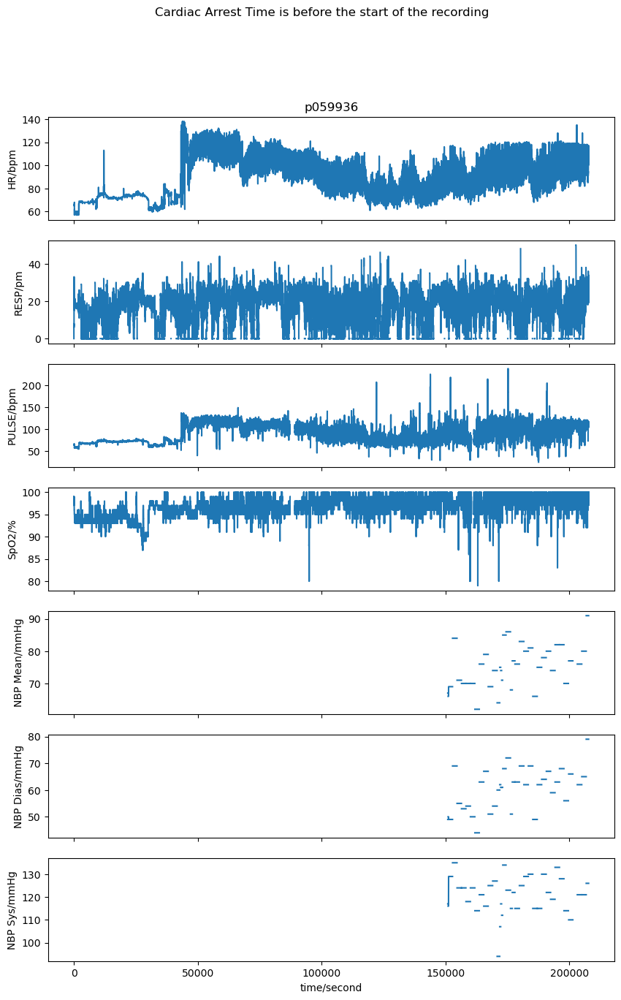

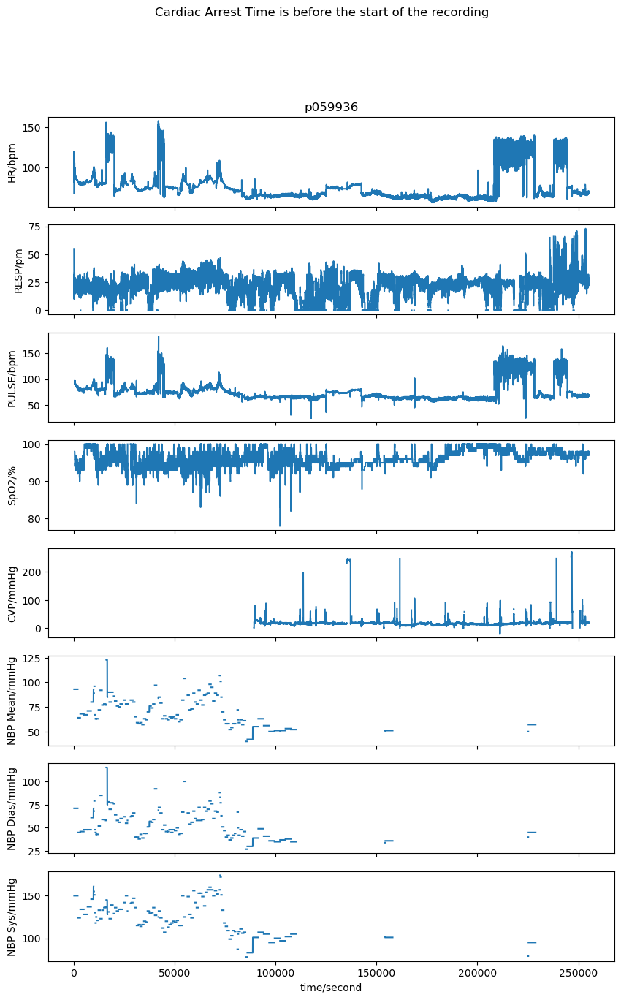

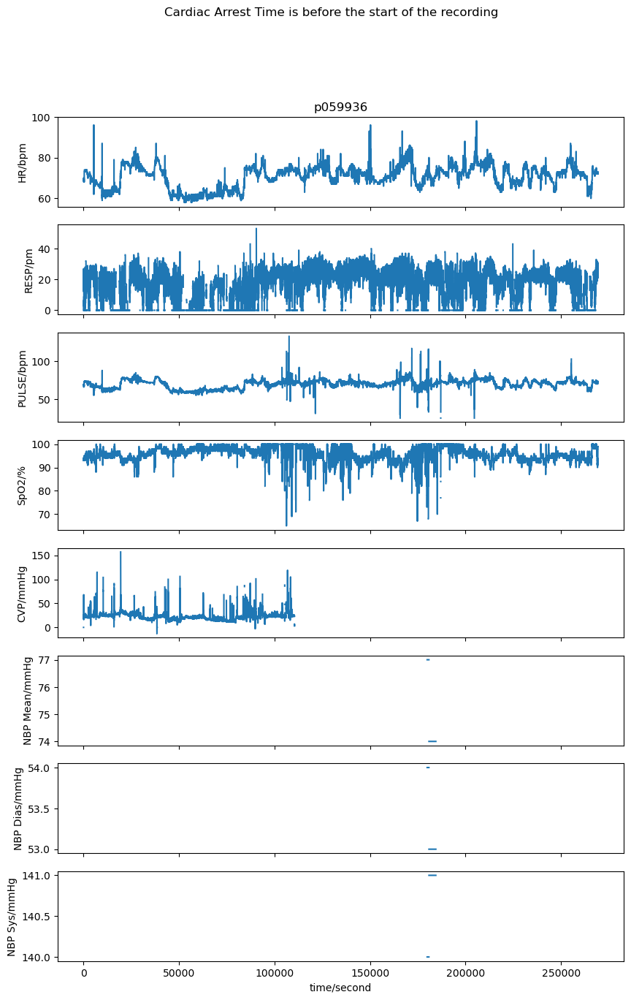

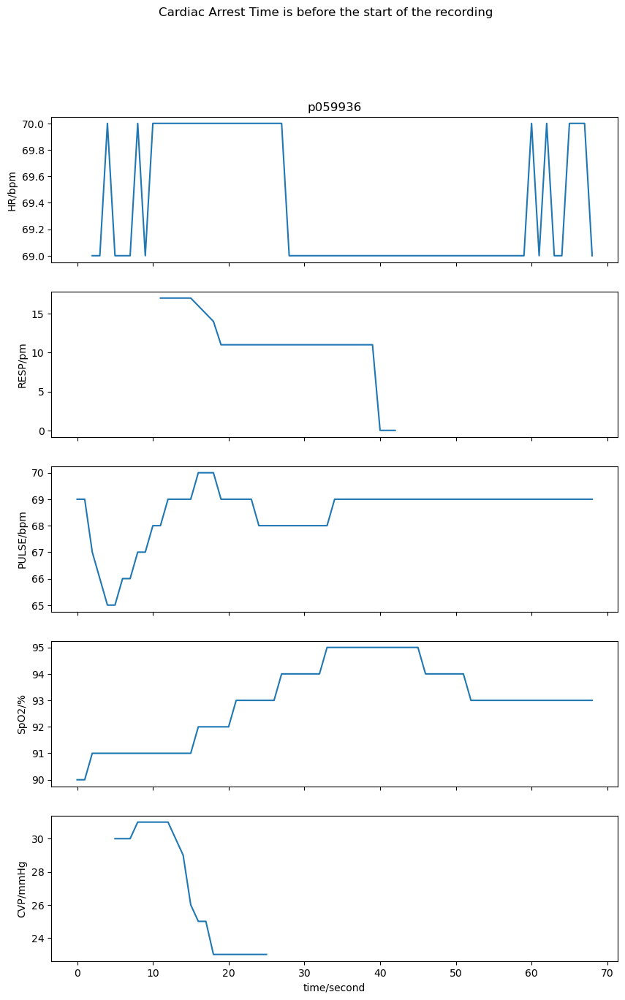

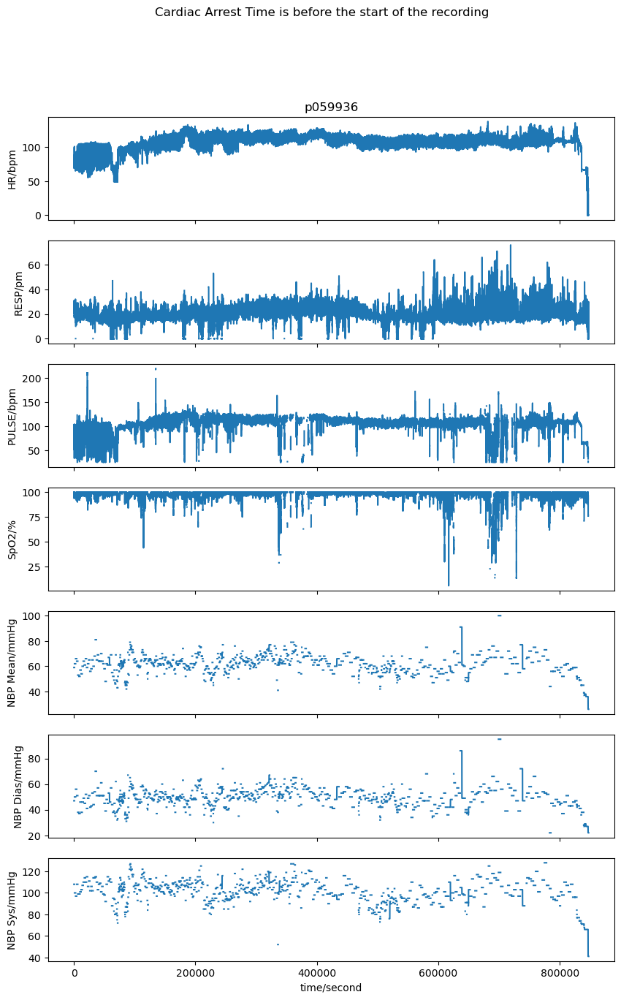

...

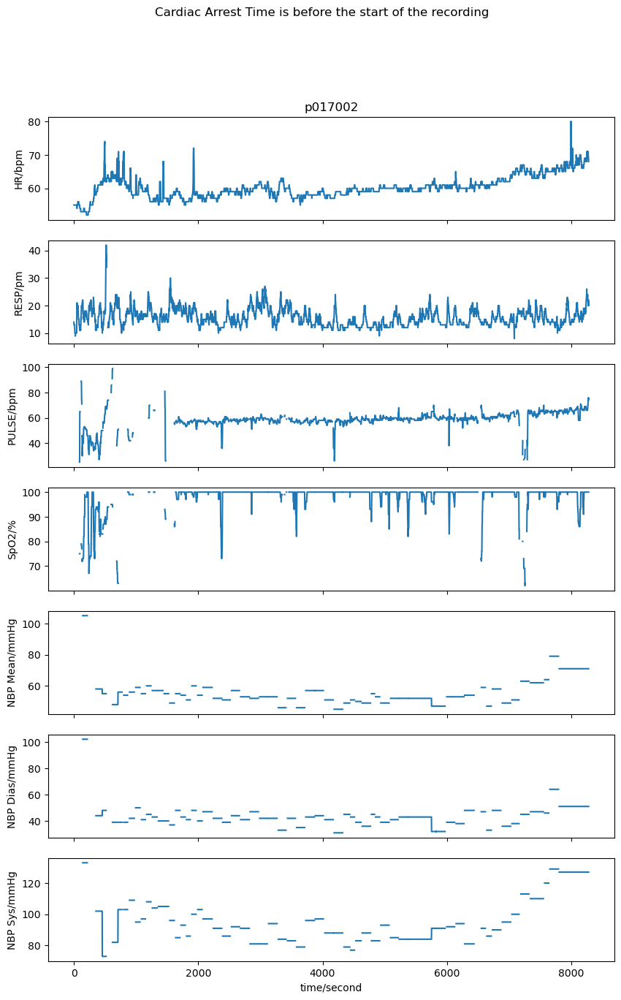

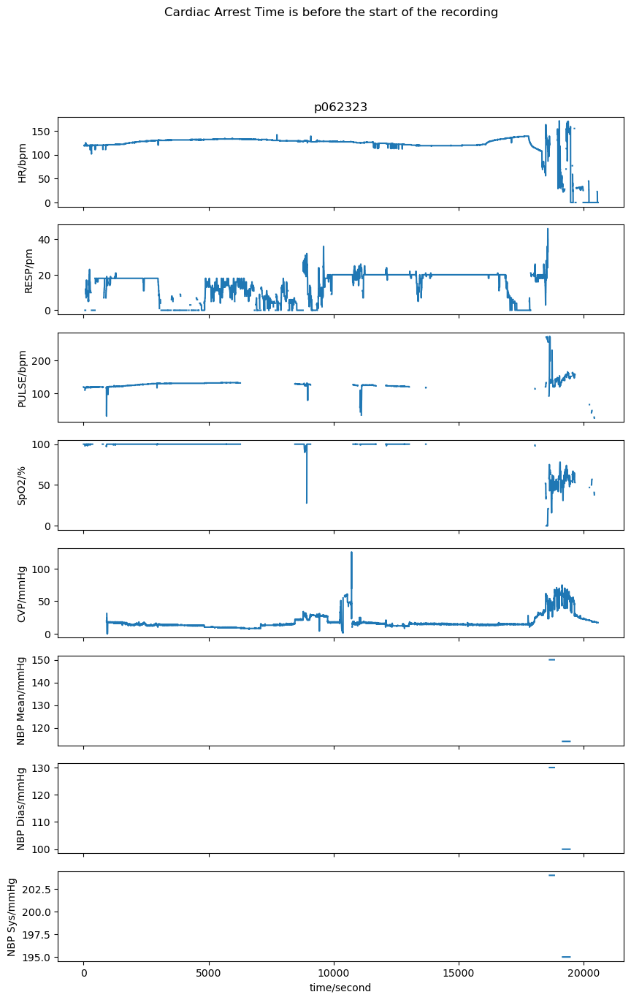

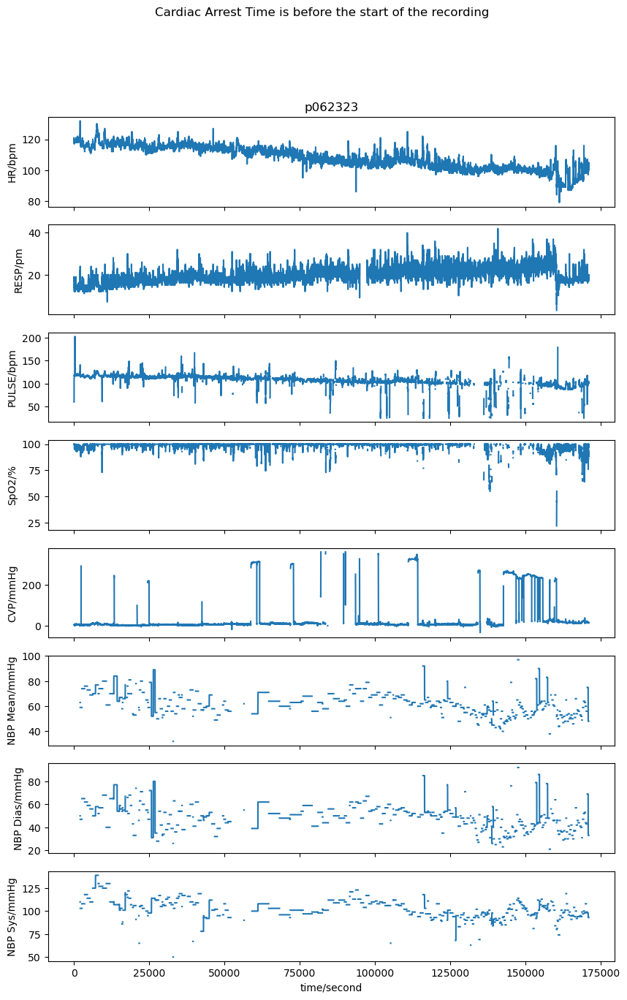

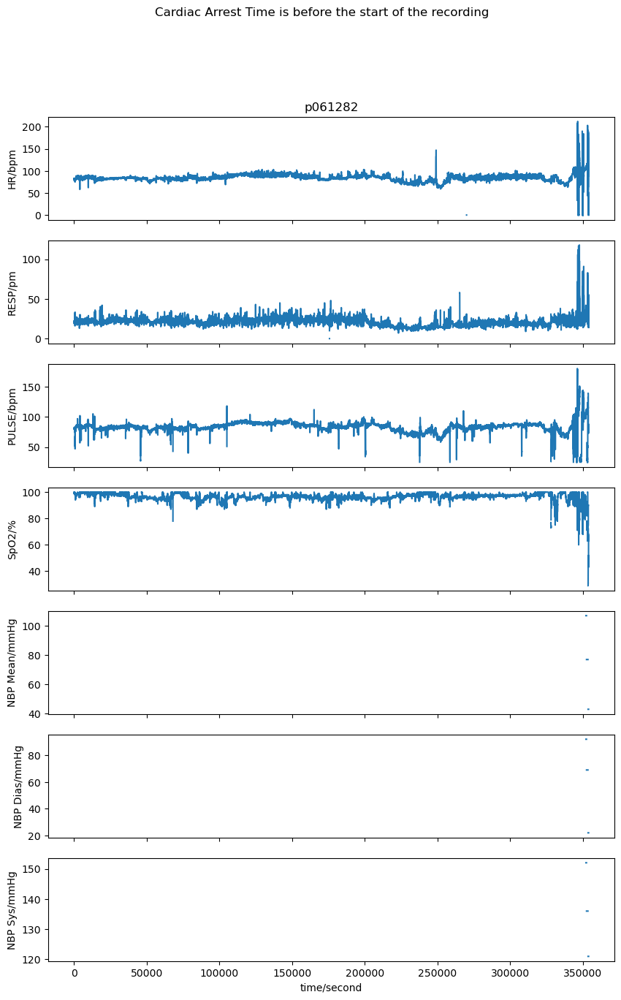

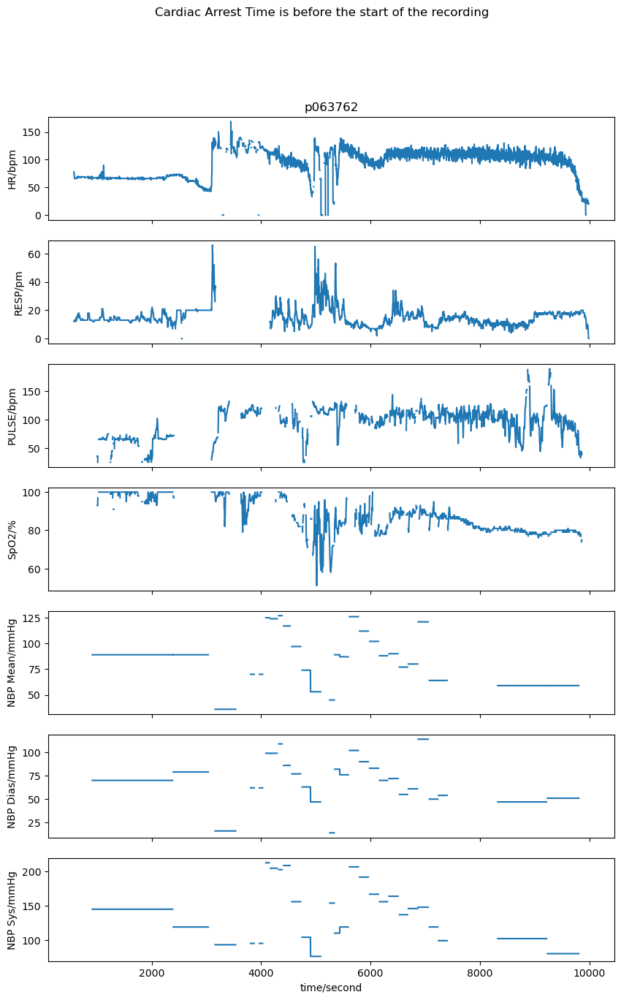

In [119]:
# Find downloaded patients
downloaded_patients_path = glob.glob("/Users/michaelscott/bd4h/project/streaming-env/time-series-kafka-demo/data/waveform/physionet.org/files/mimic3wdb-matched/1.0/**/**/**.hea")
eligible_patients_path = [path for path in downloaded_patients_path if 'n.hea' in path]
eligible_patients_rec = [path.split('/')[-1][:-4] for path in eligible_patients_path]
for record in eligible_patients_rec:
    plot_waveform(record)

{'record_name': 'p057321-2135-04-04-18-07n',
 'n_sig': 4,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 9813,
 'base_time': datetime.time(18, 7, 55),
 'base_date': datetime.date(2135, 4, 4),
 'comments': ['Location: tsicu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'CVP'],
 'p_signal': array([[118.36589675,  34.13337783, 115.26829622,          nan],
        [118.98156977,  30.38357689, 117.60026944,          nan],
        [123.38175616,  30.98337161, 121.7031396 ,          nan],
        ...,
        [         nan,          nan,          nan,          nan],
        [         nan,          nan,          nan,          nan],
        [         nan,          nan,          nan,          nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3364251n.dat', '3364251n.dat', '3364251n.dat', '3364251n.dat'],
 'fmt': ['16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1],
 'skew': [None, None, None, None],
 'byte_offset': [None, Non

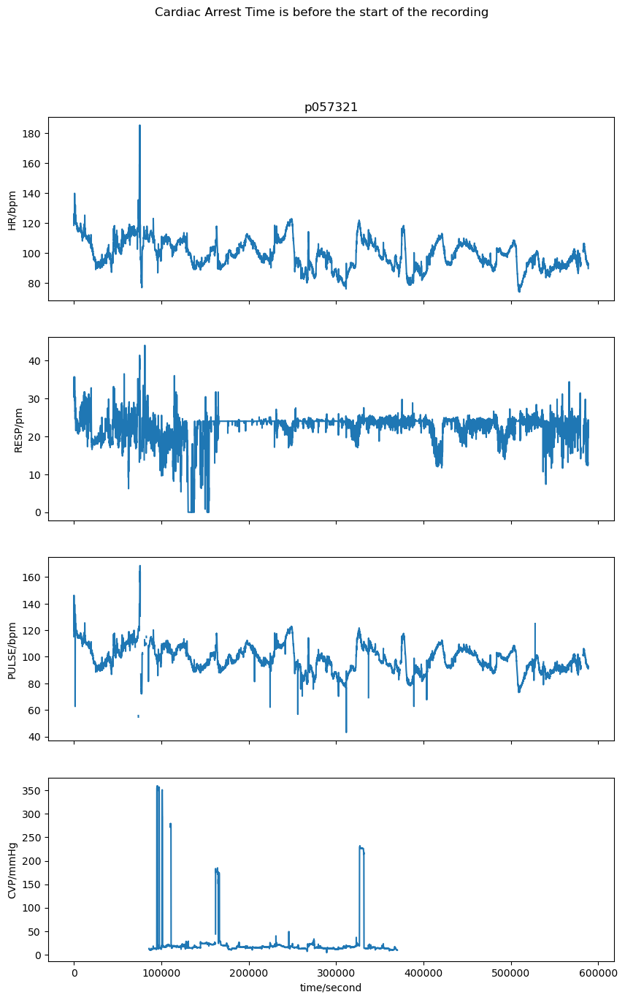

In [181]:
plot_waveform('p057321-2135-04-04-18-07n')

{'record_name': 'p057321-2135-04-04-18-06n',
 'n_sig': 3,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 1,
 'base_time': datetime.time(18, 6, 6),
 'base_date': datetime.date(2135, 4, 4),
 'comments': ['Location: tsicu'],
 'sig_name': ['HR', 'RESP', 'PULSE'],
 'p_signal': array([[116.97202869,  26.97220045, 117.26955969]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3896473n.dat', '3896473n.dat', '3896473n.dat'],
 'fmt': ['16', '16', '16'],
 'samps_per_frame': [1, 1, 1],
 'skew': [None, None, None],
 'byte_offset': [None, None, None],
 'adc_gain': [2803.96949316, 3234.77501089, 2056.30515405],
 'baseline': [-295219, -56650, -208375],
 'units': ['bpm', 'pm', 'bpm'],
 'adc_res': [16, 16, 16],
 'adc_zero': [0, 0, 0],
 'init_value': [32767, 30599, 32767],
 'checksum': [32767, 30599, 32767],
 'block_size': [0, 0, 0]}

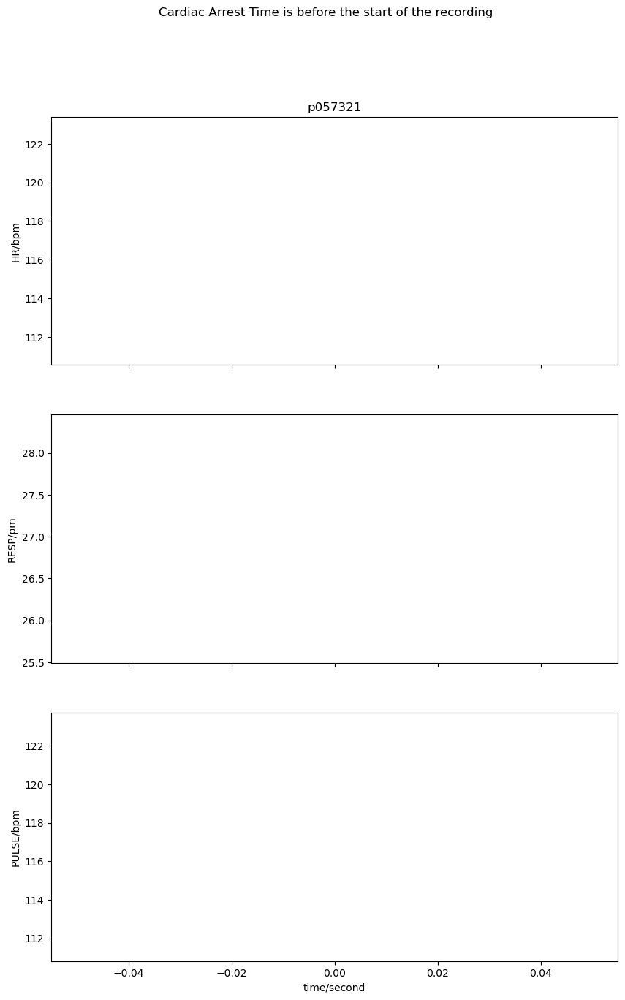

In [182]:
plot_waveform('p057321-2135-04-04-18-06n')

In [ ]:
p057321-2135-04-04-18-07n
p057321-2135-04-04-18-06n
p057321-2135-04-04-05-35n
p057321-2135-04-17-20-10n
p057321-2135-04-22-02-03n

{'record_name': 'p057321-2135-04-04-05-35n',
 'n_sig': 3,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': 2750.0,
 'sig_len': 333,
 'base_time': datetime.time(5, 35, 6),
 'base_date': datetime.date(2135, 4, 4),
 'comments': ['Location: tsicu'],
 'sig_name': ['HR', 'RESP', 'PULSE'],
 'p_signal': array([[         nan,          nan,  93.93061123],
        [ 99.21755593,  27.64241708,  86.76581861],
        [ 94.00030943,  18.52926395,  85.39977622],
        [ 93.60016243,  23.28569985,  94.53314826],
        [ 95.41687263,  19.43319081,  94.78311116],
        [ 94.91686719,  19.74975069,  95.09969842],
        [ 95.4500399 ,  19.54973678,  94.9499152 ],
        [ 96.45005078,  22.99974488,  95.93323229],
        [ 96.21681001,  19.28325766,  96.06648099],
        [ 95.61694614,  19.21648331,  95.5830897 ],
        [ 96.31666844,  19.46657798,  95.74989374],
        [ 96.40012156,  18.43312125,  96.1997297 ],
        [ 96.13335689,  17.98332181,  95.59962422],
        [ 96

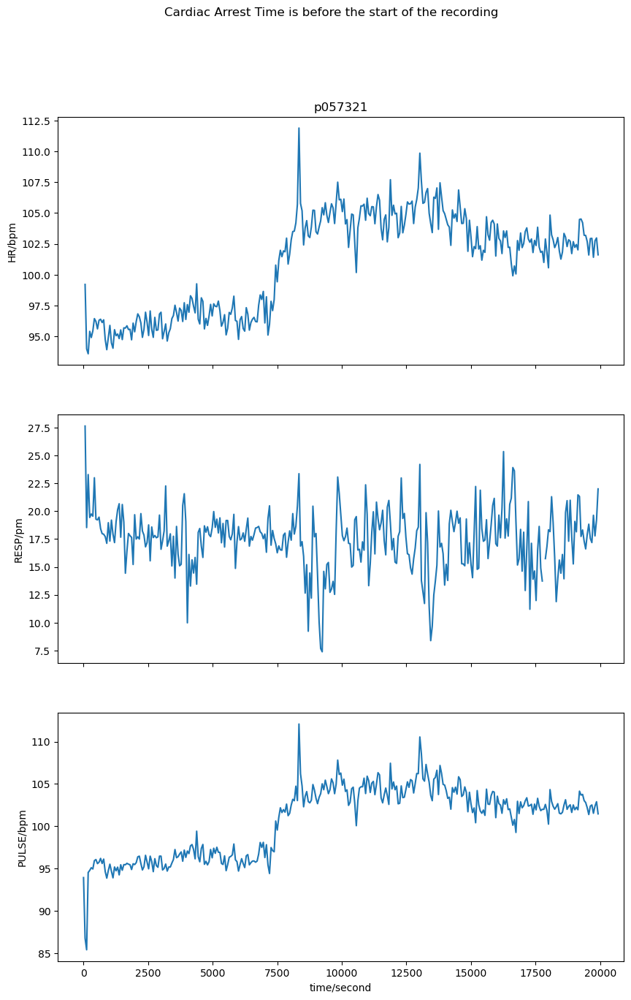

In [183]:
# No CA here
plot_waveform('p057321-2135-04-04-05-35n')

/Users/michaelscott/bd4h/project/streaming-env/time-series-kafka-demo/bin/utils.py:496: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


{'record_name': 'p057321-2135-04-22-02-03n',
 'n_sig': 4,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 4167,
 'base_time': datetime.time(2, 3, 55),
 'base_date': datetime.date(2135, 4, 22),
 'comments': ['Location: tsicu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'CVP'],
 'p_signal': array([[78.25005497, 15.24996131, 77.7375544 ,         nan],
        [80.56489726, 17.66648363, 79.88323276,         nan],
        [81.06582119, 18.01696609, 80.10021147,         nan],
        ...,
        [56.06596578, 18.32119931, 29.00062928,         nan],
        [55.85632802, 13.74975187,         nan,         nan],
        [40.61014556,  9.04967376, 74.47191522,         nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3610387n.dat', '3610387n.dat', '3610387n.dat', '3610387n.dat'],
 'fmt': ['16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1],
 'skew': [None, None, None, None],
 'byte_offset': [None, None, None, None],
 'adc_ga

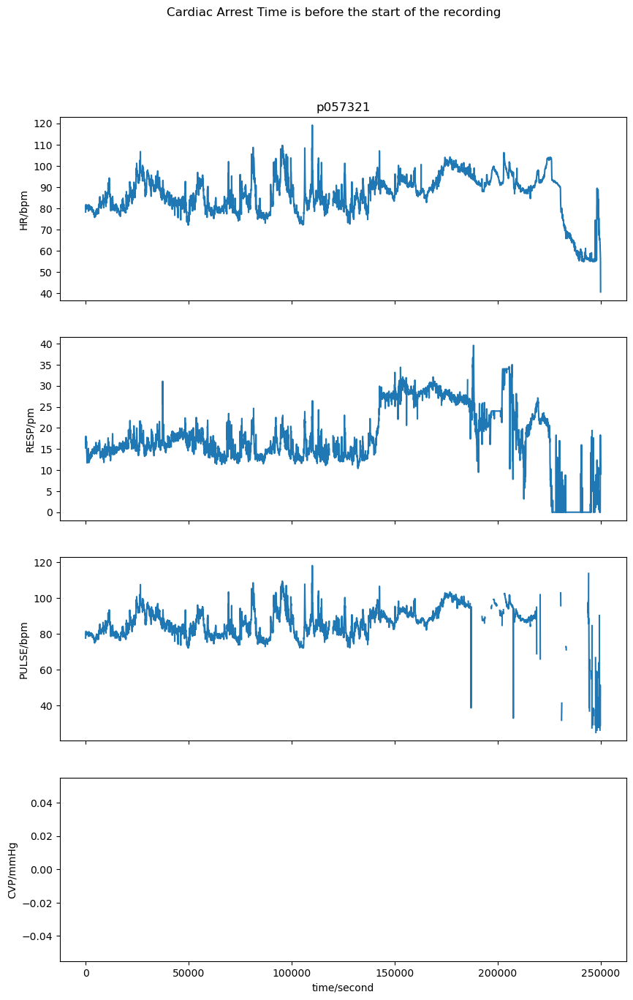

In [180]:
# Some CA here 
plot_waveform('p057321-2135-04-22-02-03n')

{'record_name': 'p057321-2135-04-17-20-10n',
 'n_sig': 4,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 5194,
 'base_time': datetime.time(20, 10, 55),
 'base_date': datetime.date(2135, 4, 17),
 'comments': ['Location: tsicu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'CVP'],
 'p_signal': array([[        nan,         nan, 96.56867644,         nan],
        [96.49957428, 19.67398932, 96.08430982,         nan],
        [96.43999302, 25.76588023, 59.72174631,         nan],
        ...,
        [75.88225156, 13.38337125, 75.49982447,         nan],
        [76.03230807, 11.68298936, 75.81762157,         nan],
        [75.08342133, 12.03347181, 74.60122577,         nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3731109n.dat', '3731109n.dat', '3731109n.dat', '3731109n.dat'],
 'fmt': ['16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1],
 'skew': [None, None, None, None],
 'byte_offset': [None, None, None, None],
 'adc_

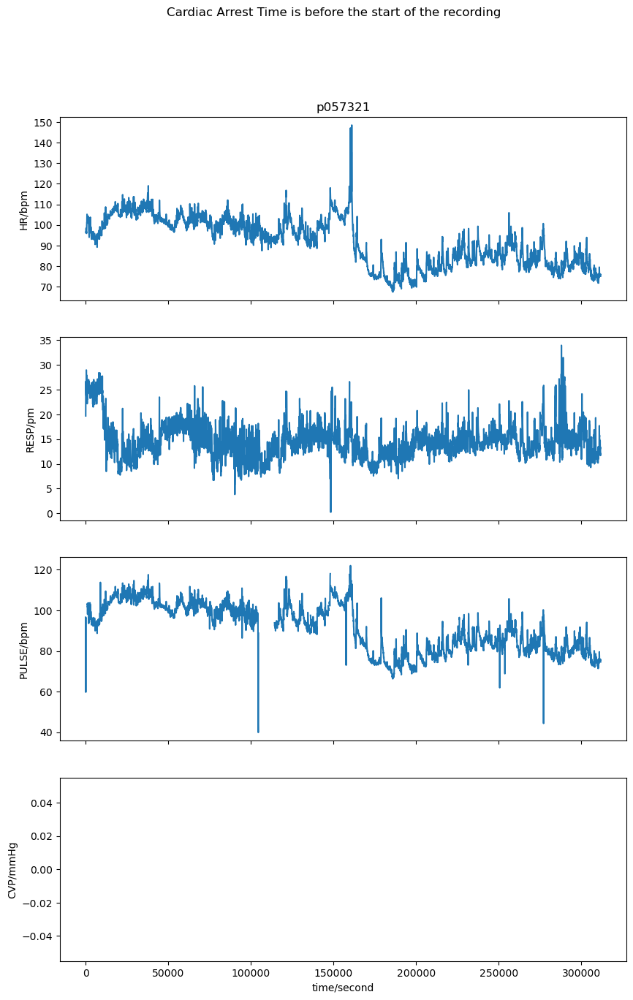

In [184]:
# Almost definitely a CA
plot_waveform('p057321-2135-04-17-20-10n')

In [129]:
patients_with_ca = spark.sql(f"""SELECT MATCHED_PATIENTS.SUBJECT_ID
FROM DIAGNOSES_ICD
INNER JOIN MATCHED_PATIENTS
ON DIAGNOSES_ICD.SUBJECT_ID = MATCHED_PATIENTS.SUBJECT_ID
WHERE DIAGNOSES_ICD.ICD9_CODE IN {ICD9_CODE_CARD}""")
patients_with_ca_list = patients_with_ca.select('SUBJECT_ID').distinct().rdd.flatMap(lambda x: x).collect()
patients_with_ca_set = set(patients_with_ca_list)

In [172]:
eligible_patients_set = set([int(pid[1:7]) for pid in eligible_patients_rec])

control_patients_list = list(eligible_patients_set - patients_with_ca_set - set(patients_w_waveform) - set(relevant_patients))
control_patients_list.sort()
# patient_w_waveform are those who are actually in training set
print(control_patients_list)

[17002, 44083, 46057, 59936]


[17002, 41031, 44083, 46057, 46651, 59936, 68808, 79096, 81694, 94255]


{'record_name': 'p017002-2153-04-16-21-38n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 11878,
 'base_time': datetime.time(21, 38, 13),
 'base_date': datetime.date(2153, 4, 16),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[55., 14., nan, ..., nan, nan, nan],
        [55., 13., nan, ..., nan, nan, nan],
        [55., 13., nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3270227n.dat',
  '3270227n.dat',
  '3270227n.dat',
  '3270227n.dat',
  '3270227n.dat',
  '3270227n.dat',
  '3270227n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_offset

{'record_name': 'p041031-2183-01-01-21-29n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 63512,
 'base_time': datetime.time(21, 29, 59),
 'base_date': datetime.date(2183, 1, 1),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3801369n.dat',
  '3801369n.dat',
  '3801369n.dat',
  '3801369n.dat',
  '3801369n.dat',
  '3801369n.dat',
  '3801369n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_o

{'record_name': 'p044083-2112-05-23-12-22n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 178095,
 'base_time': datetime.time(12, 22, 7),
 'base_date': datetime.date(2112, 5, 23),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [97., nan, nan, ..., nan, nan, nan],
        [97.,  9., nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3343009n.dat',
  '3343009n.dat',
  '3343009n.dat',
  '3343009n.dat',
  '3343009n.dat',
  '3343009n.dat',
  '3343009n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_offset

{'record_name': 'p044083-2112-05-04-19-50n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 164919,
 'base_time': datetime.time(19, 50, 40),
 'base_date': datetime.date(2112, 5, 4),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3314767n.dat',
  '3314767n.dat',
  '3314767n.dat',
  '3314767n.dat',
  '3314767n.dat',
  '3314767n.dat',
  '3314767n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_

{'record_name': 'p046057-2202-06-05-00-55n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 86087,
 'base_time': datetime.time(0, 55, 16),
 'base_date': datetime.date(2202, 6, 5),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, 57., ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3363215n.dat',
  '3363215n.dat',
  '3363215n.dat',
  '3363215n.dat',
  '3363215n.dat',
  '3363215n.dat',
  '3363215n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_of

{'record_name': 'p046651-2145-09-05-05-39n',
 'n_sig': 3,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 2353,
 'base_time': datetime.time(5, 39, 58),
 'base_date': datetime.date(2145, 9, 5),
 'comments': ['Location: tsicu'],
 'sig_name': ['HR', 'RESP', 'PULSE'],
 'p_signal': array([[71.62603189, 29.50021745,         nan],
        [70.25047684, 29.99971339, 68.14342438],
        [67.15016403, 29.99971339, 68.82320573],
        ...,
        [ 0.        ,  0.        , 53.0019932 ],
        [ 0.        ,  0.        ,         nan],
        [ 0.        ,  0.        ,         nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3681278n.dat', '3681278n.dat', '3681278n.dat'],
 'fmt': ['16', '16', '16'],
 'samps_per_frame': [1, 1, 1],
 'skew': [None, None, None],
 'byte_offset': [None, None, None],
 'adc_gain': [329.32160804, 1635.64896, 429.549883434],
 'baseline': [-32767, -32767, -52541],
 'units': ['bpm', 'pm', 'bpm'],
 'a

{'record_name': 'p046651-2145-09-07-23-46n',
 'n_sig': 3,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 86,
 'base_time': datetime.time(23, 46, 58),
 'base_date': datetime.date(2145, 9, 7),
 'comments': [],
 'sig_name': ['HR', 'RESP', 'PULSE'],
 'p_signal': array([[        nan,         nan,         nan],
        [        nan,         nan,         nan],
        [89.4003024 , 31.99973417, 83.06133494],
        [81.41319706, 23.93977483, 81.85014169],
        [86.06024017,         nan, 87.73316324],
        [83.03357228,         nan, 85.70019249],
        [79.60028811,         nan, 82.55004541],
        [81.78327409,         nan, 83.71684178],
        [80.59996452,         nan, 75.93345976],
        [84.54386128, 42.99951388, 81.05273895],
        [78.23334539, 20.23343943, 81.183318  ],
        [81.71675391, 20.08327179, 85.46689125],
        [84.93361329, 21.89972267, 85.01682879],
        [84.30026628, 23.83333733, 82.32777084],
        [80.33341538

{'record_name': 'p059936-2153-03-30-18-00n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 211427,
 'base_time': datetime.time(18, 0, 18),
 'base_date': datetime.date(2153, 3, 30),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[66.,  7., 65., ..., nan, nan, nan],
        [66.,  6., 65., ..., nan, nan, nan],
        [66.,  5., 65., ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3508696n.dat',
  '3508696n.dat',
  '3508696n.dat',
  '3508696n.dat',
  '3508696n.dat',
  '3508696n.dat',
  '3508696n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_

{'record_name': 'p059936-2153-03-19-14-05n',
 'n_sig': 8,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 255099,
 'base_time': datetime.time(14, 5, 26),
 'base_date': datetime.date(2153, 3, 19),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'CVP',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [71., 25., 69., ..., nan, nan, nan],
        [71., 25., 69., ..., nan, nan, nan],
        [71., 25., 69., ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3154213n.dat',
  '3154213n.dat',
  '3154213n.dat',
  '3154213n.dat',
  '3154213n.dat',
  '3154213n.dat',
  '3154213n.dat',
  '3154213n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, No

{'record_name': 'p059936-2153-03-25-09-24n',
 'n_sig': 8,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 269364,
 'base_time': datetime.time(9, 24, 37),
 'base_date': datetime.date(2153, 3, 25),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'CVP',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[69.,  6., 69., ..., nan, nan, nan],
        [69.,  5., 69., ..., nan, nan, nan],
        [69.,  4., 69., ..., nan, nan, nan],
        ...,
        [72., 24., 72., ..., nan, nan, nan],
        [72., 24., 72., ..., nan, nan, nan],
        [72., 24., 72., ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3346823n.dat',
  '3346823n.dat',
  '3346823n.dat',
  '3346823n.dat',
  '3346823n.dat',
  '3346823n.dat',
  '3346823n.dat',
  '3346823n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, No

{'record_name': 'p059936-2153-03-25-09-23n',
 'n_sig': 5,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 69,
 'base_time': datetime.time(9, 23, 8),
 'base_date': datetime.date(2153, 3, 25),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'SpO2', 'CVP'],
 'p_signal': array([[nan, nan, 69., 90., nan],
        [nan, nan, 69., 90., nan],
        [69., nan, 67., 91., nan],
        [69., nan, 66., 91., nan],
        [70., nan, 65., 91., nan],
        [69., nan, 65., 91., 30.],
        [69., nan, 66., 91., 30.],
        [69., nan, 66., 91., 30.],
        [70., nan, 67., 91., 31.],
        [69., nan, 67., 91., 31.],
        [70., nan, 68., 91., 31.],
        [70., 17., 68., 91., 31.],
        [70., 17., 69., 91., 31.],
        [70., 17., 69., 91., 30.],
        [70., 17., 69., 91., 29.],
        [70., 17., 69., 91., 26.],
        [70., 16., 70., 92., 25.],
        [70., 15., 70., 92., 25.],
        [70., 14., 70., 92., 23.],
        [70., 11., 69

{'record_name': 'p059936-2153-04-05-14-42n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 850958,
 'base_time': datetime.time(14, 42, 49),
 'base_date': datetime.date(2153, 4, 5),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[ nan,  nan, 102., ...,  59.,  47., 108.],
        [ nan,  nan, 102., ...,  59.,  47., 108.],
        [ nan,  nan, 102., ...,  59.,  47., 108.],
        ...,
        [ nan,  nan,  nan, ...,  nan,  nan,  nan],
        [ nan,  nan,  nan, ...,  nan,  nan,  nan],
        [ nan,  nan,  nan, ...,  nan,  nan,  nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3621475n.dat',
  '3621475n.dat',
  '3621475n.dat',
  '3621475n.dat',
  '3621475n.dat',
  '3621475n.dat',
  '3621475n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, No

{'record_name': 'p059936-2153-04-02-05-05n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 293013,
 'base_time': datetime.time(5, 5, 36),
 'base_date': datetime.date(2153, 4, 2),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[113.,  nan, 113., ..., 101.,  85., 146.],
        [113.,  nan, 113., ..., 101.,  85., 146.],
        [113.,  nan, 113., ..., 101.,  85., 146.],
        ...,
        [ 83.,  22., 101., ...,  59.,  47., 108.],
        [ 88.,  22., 101., ...,  59.,  47., 108.],
        [ 83.,  22., 102., ...,  59.,  47., 108.]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3190851n.dat',
  '3190851n.dat',
  '3190851n.dat',
  '3190851n.dat',
  '3190851n.dat',
  '3190851n.dat',
  '3190851n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None

{'record_name': 'p068808-2101-10-20-21-49n',
 'n_sig': 3,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 1338,
 'base_time': datetime.time(21, 49, 8),
 'base_date': datetime.date(2101, 10, 20),
 'comments': ['Location: tsicu'],
 'sig_name': ['HR', 'RESP', 'PULSE'],
 'p_signal': array([[        nan,         nan,         nan],
        [        nan,         nan,         nan],
        [        nan,         nan,         nan],
        ...,
        [42.83303879, 20.00012828,         nan],
        [ 7.90056522,  8.22660751,         nan],
        [ 0.        ,  0.        ,         nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3471901n.dat', '3471901n.dat', '3471901n.dat'],
 'fmt': ['16', '16', '16'],
 'samps_per_frame': [1, 1, 1],
 'skew': [None, None, None],
 'byte_offset': [None, None, None],
 'adc_gain': [445.917463202, 1864.4380414, 641.920322788],
 'baseline': [-32767, -32767, -60899],
 'units': ['bpm', 'pm', 'bpm']

{'record_name': 'p079096-2133-03-19-21-12n',
 'n_sig': 3,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 385,
 'base_time': datetime.time(21, 12, 52),
 'base_date': datetime.date(2133, 3, 19),
 'comments': ['Location: tsicu'],
 'sig_name': ['HR', 'RESP', 'PULSE'],
 'p_signal': array([[ 83.18427342,  16.78351466,  84.31050584],
        [ 72.81692491,  19.70006455,  90.35156786],
        [ 82.39899153,  18.28316444,  86.83327993],
        ...,
        [ 71.15006577,  10.23086884,          nan],
        [122.84982476,   0.        ,          nan],
        [ 62.49026459,   0.        ,          nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3332946n.dat', '3332946n.dat', '3332946n.dat'],
 'fmt': ['16', '16', '16'],
 'samps_per_frame': [1, 1, 1],
 'skew': [None, None, None],
 'byte_offset': [None, None, None],
 'adc_gain': [737.314849054, 2658.6207308, 661.96969697],
 'baseline': [-75617, -32767, -49316],
 'units': ['bp

{'record_name': 'p081694-2105-02-23-20-54n',
 'n_sig': 4,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': 2000.0,
 'sig_len': 898,
 'base_time': datetime.time(20, 54, 33),
 'base_date': datetime.date(2105, 2, 23),
 'comments': ['Location: micu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'CVP'],
 'p_signal': array([[        nan,         nan,         nan,         nan],
        [75.57698038, 13.03841556,         nan,         nan],
        [77.28402631, 14.4498141 , 77.48485537,         nan],
        ...,
        [23.99996439, 20.18185164, 91.46983797,         nan],
        [ 0.        ,  0.        , 86.13415814,         nan],
        [ 0.        ,  0.        , 76.72703946,         nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3765844n.dat', '3765844n.dat', '3765844n.dat', '3765844n.dat'],
 'fmt': ['16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1],
 'skew': [None, None, None, None],
 'byte_offset': [None, None, None, None],
 'adc_

{'record_name': 'p094255-2139-07-30-15-58n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 83036,
 'base_time': datetime.time(15, 58, 59),
 'base_date': datetime.date(2139, 7, 30),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3175813n.dat',
  '3175813n.dat',
  '3175813n.dat',
  '3175813n.dat',
  '3175813n.dat',
  '3175813n.dat',
  '3175813n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_

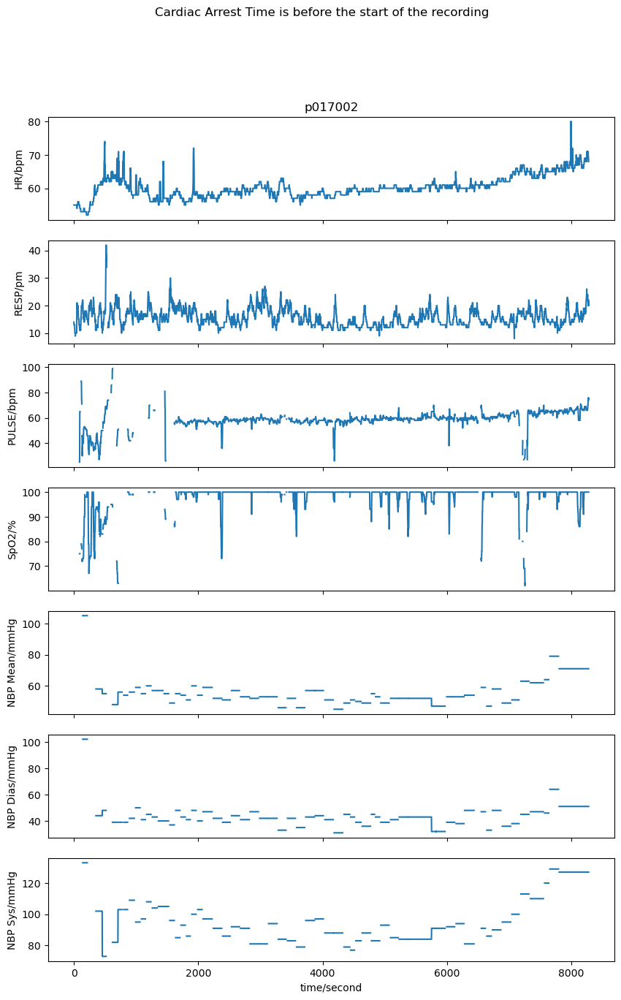

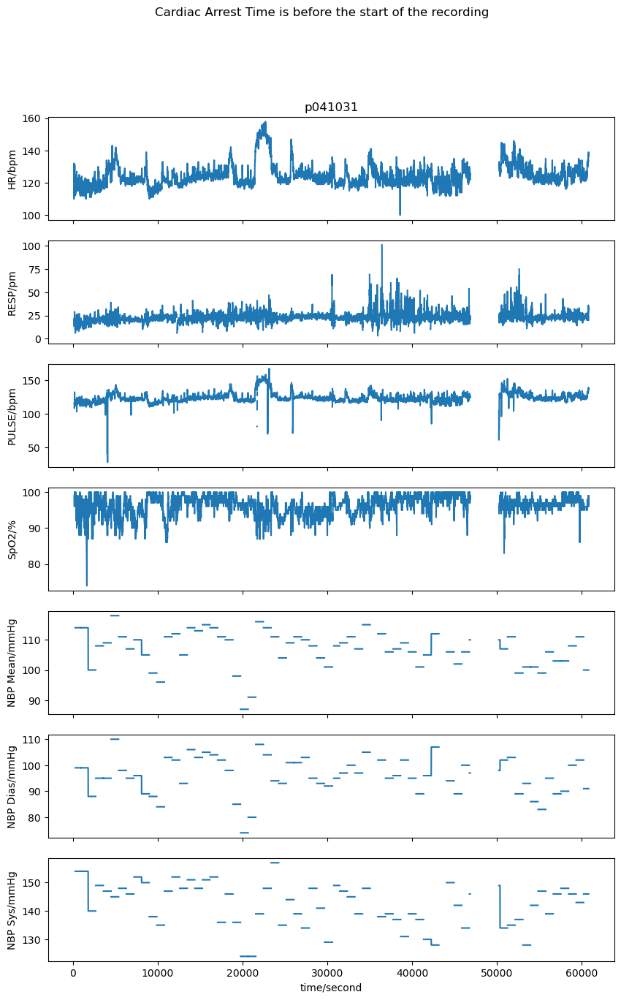

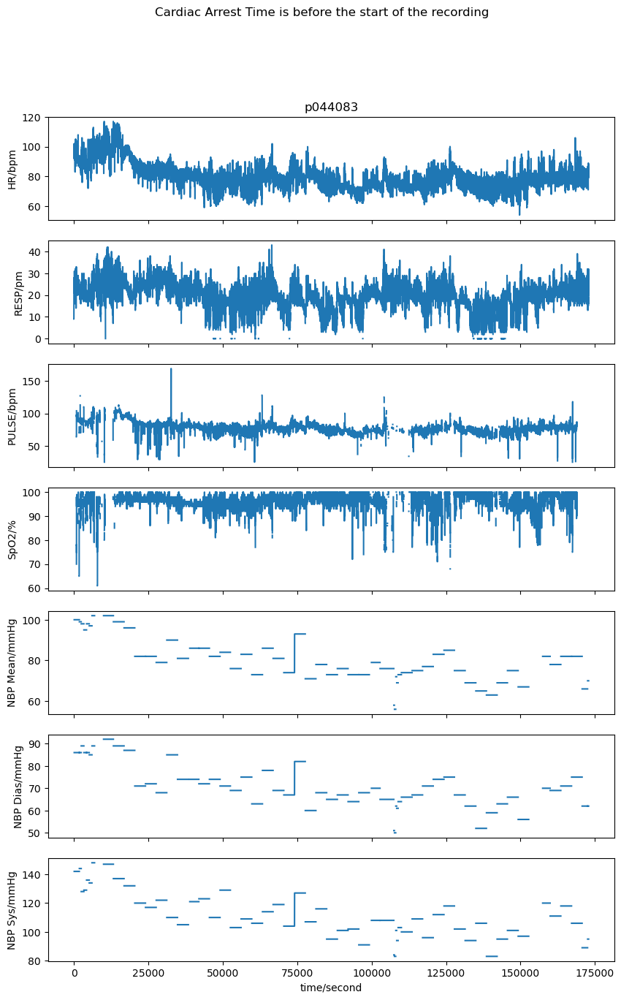

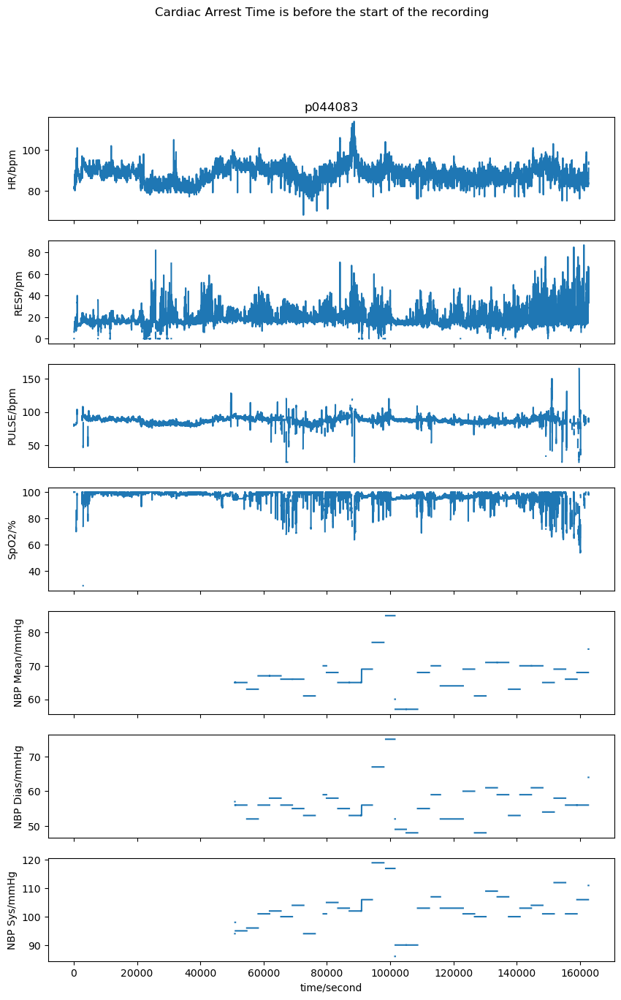

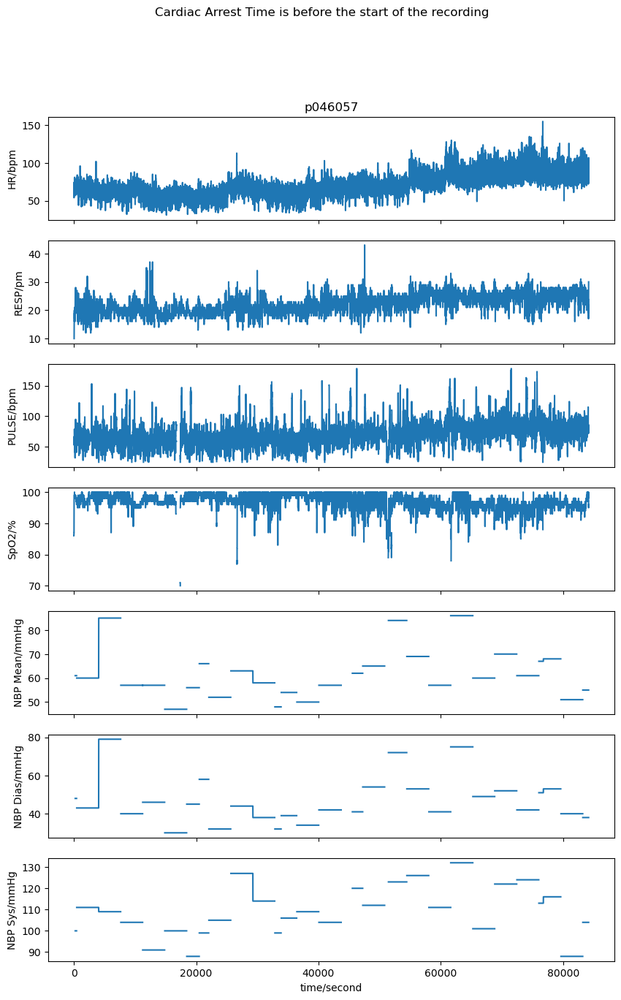

...

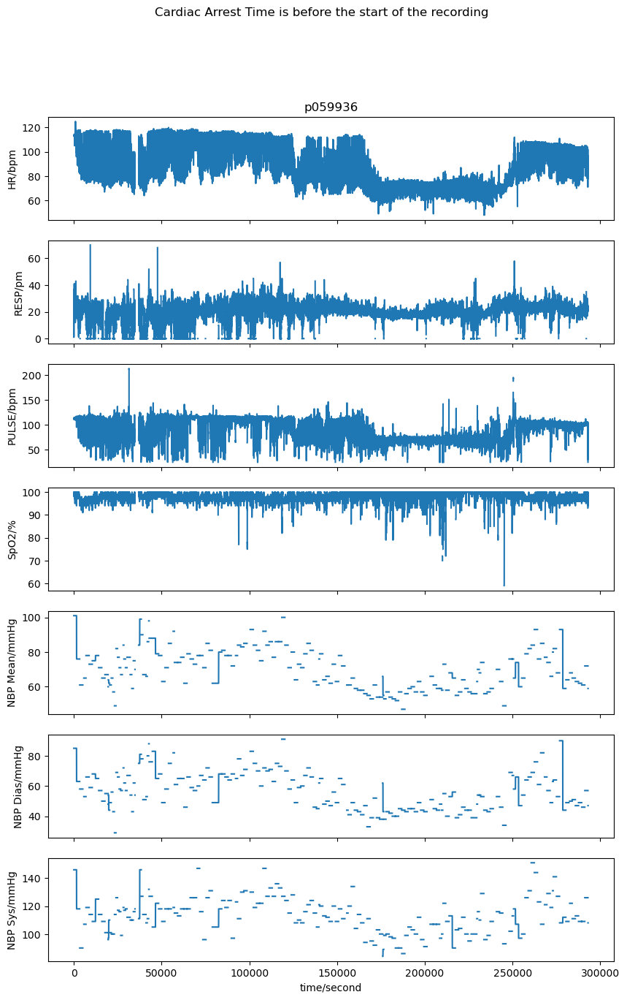

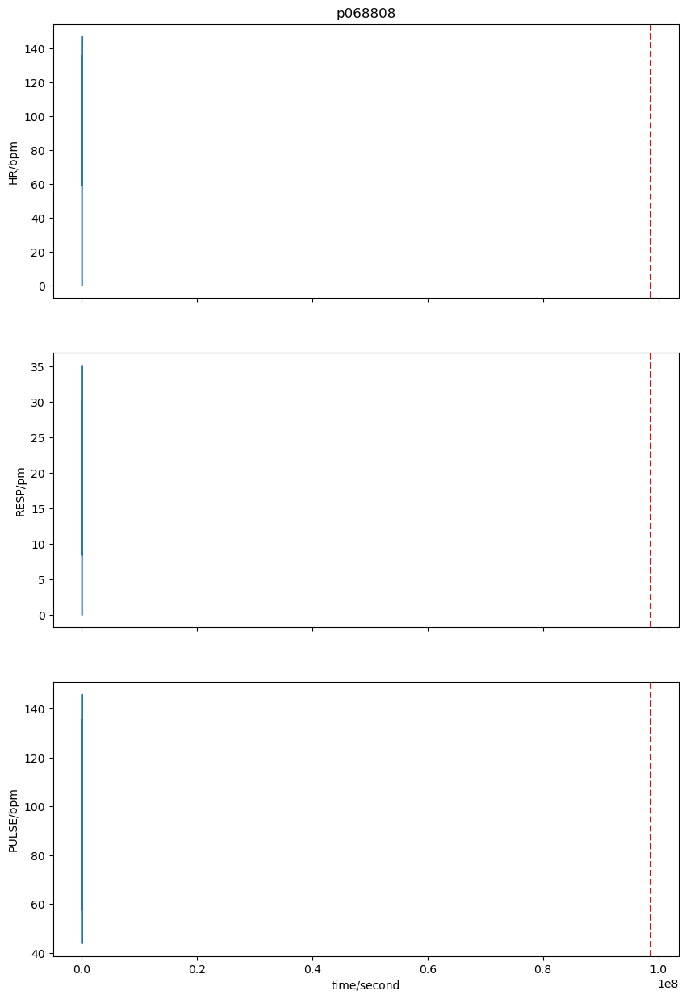

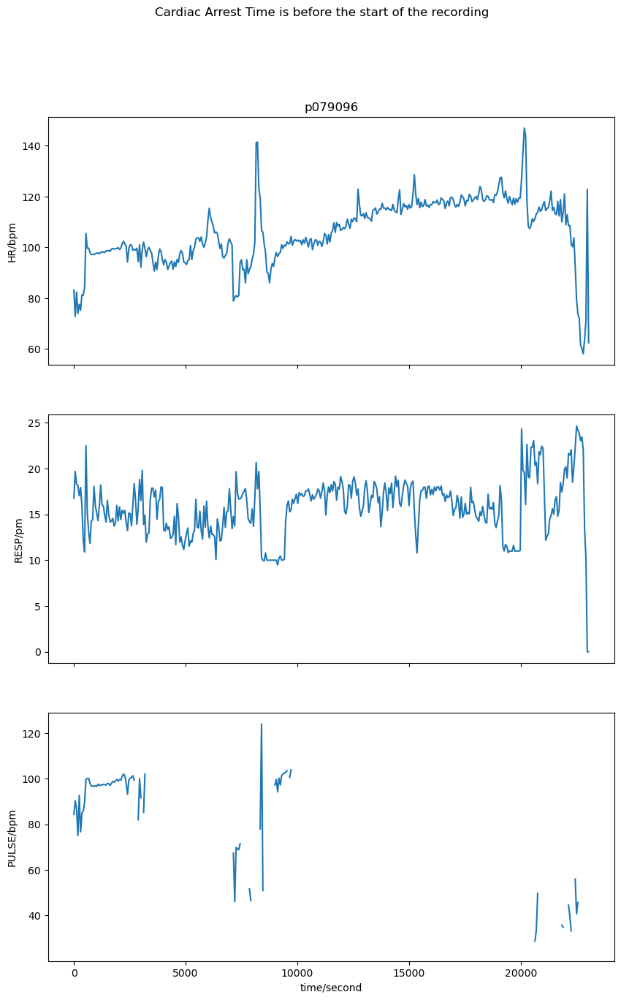

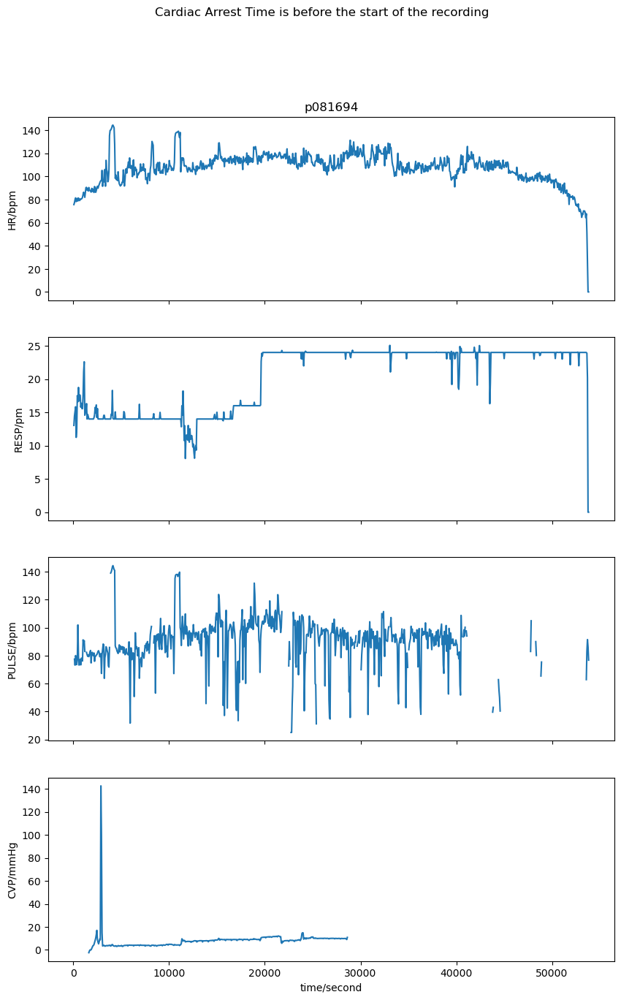

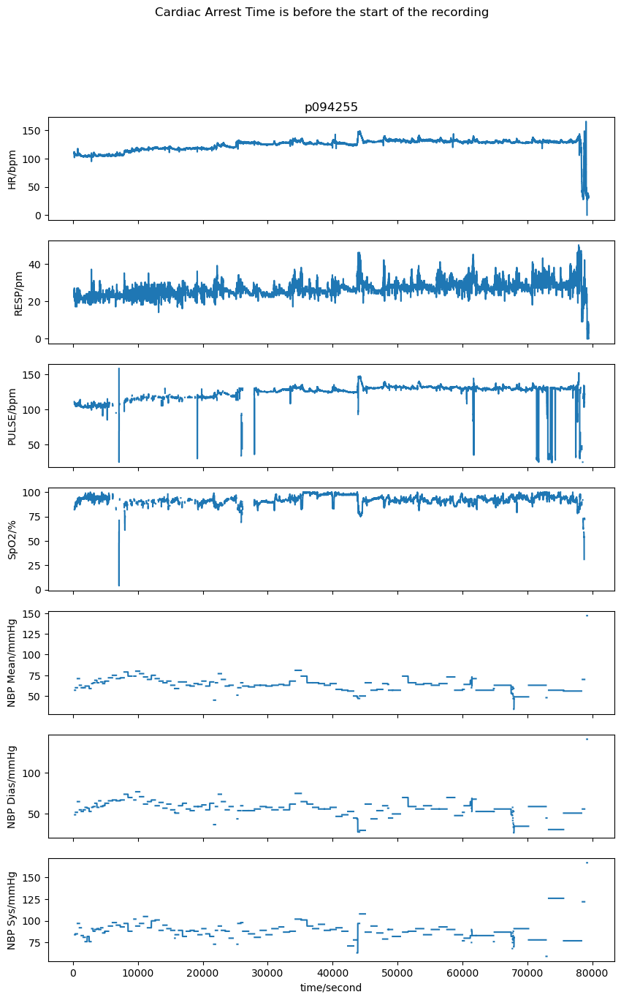

In [157]:
for patient in control_patients_list:
    patient_string = f'p{patient:06d}'
    files = glob.glob(f"/Users/michaelscott/bd4h/project/streaming-env/time-series-kafka-demo/data/waveform/physionet.org/files/mimic3wdb-matched/1.0/**/{patient_string}/**n.hea")
    for file in files:
        plot_waveform(file.split('/')[-1][:-4])

In [ ]:

eligible_patients_id = [path.split('/')[-1][0:] for path in eligible_patients_path] 

In [150]:
eligible_patients_rec

['p059936-2153-03-30-18-00n',
 'p059936-2153-03-19-14-05n',
 'p059936-2153-03-25-09-24n',
 'p059936-2153-03-25-09-23n',
 'p059936-2153-04-05-14-42n',
 'p059936-2153-04-02-05-05n',
 'p052529-2184-04-11-21-49n',
 'p052529-2184-03-26-12-26n',
 'p052529-2184-04-04-14-57n',
 'p052529-2184-03-18-15-36n',
 'p052529-2184-03-09-21-31n',
 'p052529-2184-04-08-18-45n',
 'p052529-2184-03-11-16-00n',
 'p052529-2184-03-10-11-01n',
 'p052529-2184-04-13-19-55n',
 'p052529-2184-03-10-13-16n',
 'p052529-2184-03-15-06-39n',
 'p052529-2184-04-06-21-09n',
 'p054183-2165-09-15-16-43n',
 'p054183-2165-09-13-10-39n',
 'p054183-2165-09-27-20-05n',
 'p054183-2165-09-28-21-54n',
 'p050015-2138-12-20-19-42n',
 'p056697-2164-08-25-13-43n',
 'p056697-2164-08-25-14-06n',
 'p056697-2164-08-24-16-05n',
 'p056697-2164-08-21-06-43n',
 'p056697-2164-08-16-17-54n',
 'p056697-2164-08-24-11-45n',
 'p056697-2164-08-23-18-19n',
 'p055725-2157-04-07-16-13n',
 'p026868-2163-03-25-14-16n',
 'p026868-2163-03-24-01-35n',
 'p024276-

{'record_name': 'p044083-2112-05-23-12-22n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 178095,
 'base_time': datetime.time(12, 22, 7),
 'base_date': datetime.date(2112, 5, 23),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [97., nan, nan, ..., nan, nan, nan],
        [97.,  9., nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3343009n.dat',
  '3343009n.dat',
  '3343009n.dat',
  '3343009n.dat',
  '3343009n.dat',
  '3343009n.dat',
  '3343009n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_offset

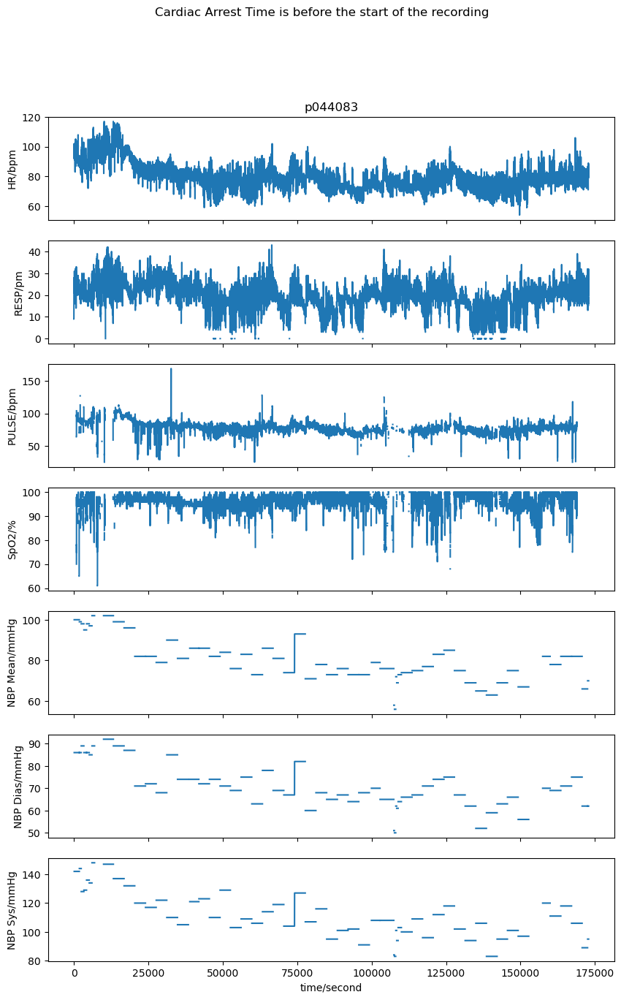

In [166]:
# plot the waveform
# this intense man. Seems like the patient is constantly just dying
plot_waveform('p044083-2112-05-23-12-22n')

## 3.2 Match procedures with notes 

In [94]:
# Find the notes of those who have cardiac arrest
# These are all the patients with cardiac arrest and their timing
procedures_matched_card_notes = spark.sql("""SELECT 
PROCEDUREEVENTS_MV.*, NOTEEVENTS.DESCRIPTION, NOTEEVENTS.CATEGORY, NOTEEVENTS.TEXT, NOTEEVENTS.CHARTDATE, NOTEEVENTS_TIME.CHARTTIME
FROM PROCEDUREEVENTS_MV 
INNER JOIN MATCHED_PATIENTS 
ON PROCEDUREEVENTS_MV.SUBJECT_ID = MATCHED_PATIENTS.SUBJECT_ID
LEFT JOIN NOTEEVENTS
ON PROCEDUREEVENTS_MV.HADM_ID = NOTEEVENTS.HADM_ID
LEFT JOIN NOTEEVENTS_TIME
ON NOTEEVENTS.ROW_ID = NOTEEVENTS_TIME.ROW_ID
WHERE PROCEDUREEVENTS_MV.ITEMID == 225466
ORDER BY PROCEDUREEVENTS_MV.SUBJECT_ID, PROCEDUREEVENTS_MV.HADM_ID, PROCEDUREEVENTS_MV.STARTTIME, NOTEEVENTS_TIME.CHARTTIME
""")
procedures_matched_card_notes.cache()
procedures_matched_card_notes.show()
procedures_matched_card_notes.drop_duplicates().coalesce(1).write.csv(f'file://{cfg["EXPLOREPATH"]}/procedures_matched_card_notes', header=True, mode='overwrite')


+------+----------+-------+----------+-------------------+-------------------+------+-----+--------+--------+----------------+-------------------+-----+-------+-----------+------------------+--------------------------+------------------------+---------+------------------+------------+-----------------+-----------------+-------------------+-------------+-----------+-----------------+--------------------+-------------------+---------+
|ROW_ID|SUBJECT_ID|HADM_ID|ICUSTAY_ID|          STARTTIME|            ENDTIME|ITEMID|VALUE|VALUEUOM|LOCATION|LOCATIONCATEGORY|          STORETIME| CGID|ORDERID|LINKORDERID| ORDERCATEGORYNAME|SECONDARYORDERCATEGORYNAME|ORDERCATEGORYDESCRIPTION|ISOPENBAG|CONTINUEINNEXTDEPT|CANCELREASON|STATUSDESCRIPTION|COMMENTS_EDITEDBY|COMMENTS_CANCELEDBY|COMMENTS_DATE|DESCRIPTION|         CATEGORY|                TEXT|          CHARTDATE|CHARTTIME|
+------+----------+-------+----------+-------------------+-------------------+------+-----+--------+--------+----------------+

In [ ]:
# Alright, let's just create a script
# We will check if the record of a patient is within 24 hour +- of the record STARTTIME of PROCEDUREEVENTS_MV

# find the record of the patient and the start time of each record
# download all the "RECORDS" file from the website

In [ ]:
spark.sql("""SELECT D_ICD_DIAGNOSES.* 
FROM D_ICD_DIAGNOSES
WHERE ICD9_CODE IN """).show()


In [59]:
# Filter 
# Filter the above icd9codes from d_icd_procedures
d_icd_procedures_filtered = d_icd_procedures.filter(d_icd_procedures.ICD9_CODE.isin(icd9_codes))

# Filter teh above icd9_codes from d_icd_diagnosis
d_icd_diagnoses_filtered = D_ICD_DIAGNOSES.filter(d_icd_diagnoses.ICD9_CODE.isin(icd9_codes))
CARD_ICD_9 =["4275", "4271", "42741", "42742", "99.60", "99.63", "99.62", "38.97", "96.04", "39.66", "39.95", "41.92", "96.70", "96.71", "96.72"]

spark.sql("""SELECT * 
FROM D_ICD_DIAGNOSES
WHERE ICD_9_CODE IN ('4275', '4271', '42741', '42742', '99.60', '99.63', '99.62', '38.97', '96.04', '39.66', '39.95', '41.92', '96.70', '96.71', '96.72')""").show()
# 
d_icd_procedures.createOrReplaceTempView('d_icd_procedures')
d_icd_diagnoses.createOrReplaceTempView('d_icd_diagnoses')
d_icd_procedures_filtered.createOrReplaceTempView('d_icd_procedures_filtered')
d_icd_diagnoses_filtered.createOrReplaceTempView('d_icd_diagnoses_filtered')
# Filter the above from d_icd_procedures


NameError: name 'd_icd_procedures' is not defined

In [57]:
spark.sql(""" 
SELECT PROCEDUREEVENTS_MV.* 
FROM PROCEDUREEVENTS_MV
INNER JOIN MATCHED_PATIENTS
ON PROCEDUREEVENTS_MV.SUBJECT_ID = MATCHED_PATIENTS.SUBJECT_ID
INNER JOIN

SyntaxError: EOF while scanning triple-quoted string literal (351411799.py, line 3)

In [29]:


NOTEEVENTS_ORIG = ps.from_pandas(NOTEEVENTS_ORIG)

/var/folders/lc/wjv2l4cd19s4276v_sgzt_q40000gn/T/ipykernel_6192/2674808026.py:2: DtypeWarning: Columns (4,5) have mixed types. Specify dtype option on import or set low_memory=False.
  NOTEEVENTS_ORIG = pd.read_csv(f'{MIMICPATH}/NOTEEVENTS_ORIG.csv.gz',usecols=['ROW_ID','CHARTTIME','STORETIME'])
/Users/michaelscott/opt/anaconda3/envs/bd4hproject/lib/python3.9/site-packages/pyspark/pandas/internal.py:1573: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  fields = [


23/04/07 14:58:46 WARN SparkSession: Using an existing Spark session; only runtime SQL configurations will take effect.


/Users/michaelscott/opt/anaconda3/envs/bd4hproject/lib/python3.9/site-packages/pyspark/sql/pandas/conversion.py:604: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  [(c, t) for (_, c), t in zip(pdf_slice.iteritems(), arrow_types)]


In [69]:
# Create schema for d_icd_procedures

# d_icd_procedures = spark.read.csv(f'{MIMICPATH}/D_ICD_PROCEDURES.csv.gz', header=True, schema=d_icd_procedures_schema)

# d_icd_procedures.createOrReplaceTempView('d_icd_procedures')

    
# datetimeevents = spark.read.csv(f'{MIMICPATH}/DATETIMEEVENTS.csv.gz', header=True, schema=datetimeevents_schema)

# datetimeevents.createOrReplaceTempView('datetimeevents')

In [90]:
# d_items_df.createOrReplaceTempView('d_items_df')

In [5]:
# # get pyspark configuration
# from pyspark import SparkConf
# conf = SparkConf()
# print(conf.getAll())

[('spark.executor.memory', '3g'), ('spark.master', 'local[*]'), ('spark.submit.pyFiles', ''), ('spark.submit.deployMode', 'client'), ('spark.app.name', 'Read CSV File into DataFrame'), ('spark.driver.memory', '1g'), ('spark.app.submitTime', '1680836239263'), ('spark.ui.showConsoleProgress', 'true'), ('spark.executor.cores', '4')]


In [5]:
# chartevents = ps.read_csv(f'{MIMICPATH}/CHARTEVENTS.csv.gz', compression='gzip')
#Create schema for chartevents.csv.gz


# chartevents = spark.read.csv(f'{MIMICPATH}/CHARTEVENTS.csv.gz', header=True, inferSchema=True).select('SUBJECT_ID','ITEMID','CHARTTIME','VALUE')

In [ ]:
# chartevents = ps.read_csv(f'{MIMICPATH}/CHARTEVENTS.csv.gz', compression='gzip')
from pyspark.sql.types import StructType, StructField, IntegerType, StringType, TimestampType
#Create schema for chartevents.csv.gz

chartevents2 = spark.read.csv(f'{cfg["MIMICPATH"]}/CHARTEVENTS.csv.gz', header=True, schema=chartevents_schema)

In [41]:
# define the modified schema for the PySpark DataFrame


noteevents = spark.read.csv(f'{cfg["MIMICPATH"]}/NOTEEVENTS.csv.gz', header=True, schema=noteevents_schema)
# make it sql readable
noteevents.createOrReplaceTempView('noteevents')


In [60]:
# define the modified schema for the PySpark DataFrame
schema = StructType([
    StructField("ROW_ID", IntegerType(), True),
    StructField("SUBJECT_ID", IntegerType(), True),
    StructField("HADM_ID", IntegerType(), True),
    StructField("CHARTDATE", TimestampType(), True),
    StructField("CHARTTIME", TimestampType(), True),
    StructField("STORETIME", TimestampType(), True),
    StructField("CATEGORY", StringType(), True),
    StructField("DESCRIPTION", StringType(), True),
    StructField("CGID", IntegerType(), True),
    StructField("ISERROR", StringType(), True),
    StructField("TEXT", StringType(), True)
])

noteevents2 = spark.read.csv(f'{cfg["MIMICPATH"]}/NOTEEVENTS.csv', header=True, schema=schema)
noteevents2.cache()

# make it sql readable
noteevents2.createOrReplaceTempView('noteevents2')


23/04/07 13:04:31 WARN CacheManager: Asked to cache already cached data.


In [87]:
d_icd_diagnoses.show()

+------+---------+--------------------+--------------------+
|ROW_ID|ICD9_CODE|         SHORT_TITLE|          LONG_TITLE|
+------+---------+--------------------+--------------------+
|   174|    01166|TB pneumonia-oth ...|Tuberculous pneum...|
|   175|    01170|TB pneumothorax-u...|Tuberculous pneum...|
|   176|    01171|TB pneumothorax-n...|Tuberculous pneum...|
|   177|    01172|TB pneumothorx-ex...|Tuberculous pneum...|
|   178|    01173|TB pneumothorax-m...|Tuberculous pneum...|
|   179|    01174|TB pneumothorax-c...|Tuberculous pneum...|
|   180|    01175|TB pneumothorax-h...|Tuberculous pneum...|
|   181|    01176|TB pneumothorax-o...|Tuberculous pneum...|
|   182|    01180|Pulmonary TB NEC-...|Other specified p...|
|   183|    01181|Pulmonary TB NEC-...|Other specified p...|
|   184|    01182|Pulmon TB NEC-exa...|Other specified p...|
|   185|    01183|Pulmon TB NEC-mic...|Other specified p...|
|   186|    01184|Pulmon TB NEC-cul...|Other specified p...|
|   187|    01185|Pulmon

In [82]:
d_icd_procedures.filter(d_icd_procedures.ICD9_CODE.isin(icd9_codes))

DataFrame[ROW_ID: int, ICD9_CODE: string, SHORT_TITLE: string, LONG_TITLE: string]

In [117]:
spark.sql("select * from d_icd_diagnoses where long_title like '%cardiac%'").show()

+------+---------+--------------------+--------------------+
|ROW_ID|ICD9_CODE|         SHORT_TITLE|          LONG_TITLE|
+------+---------+--------------------+--------------------+
|  4471|    42789|Cardiac dysrhythm...|Other specified c...|
|  4492|     4294|Hrt dis postcardi...|Functional distur...|
|  4495|    42971|Acq cardiac septl...|Acquired cardiac ...|
|  7319|     7458|Septal closure an...|Other bulbus cord...|
|  7338|    74687|Malposition of heart|Malposition of he...|
| 12276|     9720|Pois-card rhythm ...|Poisoning by card...|
|  9881|    V4500|Status cardc dvce...|Unspecified cardi...|
|  9883|    V4502|Status autm crd d...|Automatic implant...|
|  9884|    V4509|Status oth spcf c...|Other specified c...|
| 11407|    99600|Malfunc card dev/...|Mechanical compli...|
| 11408|    99601|Malfunc cardiac p...|Mechanical compli...|
| 11411|    99604|Mch cmp autm mpln...|Mechanical compli...|
| 11412|    99609|Malfunc card dev/...|Other mechanical ...|
| 11437|    99661|React-

In [118]:
spark.sql("select * from d_icd_procedures where long_title like '%cardiac%'").show()

+------+---------+--------------------+--------------------+
|ROW_ID|ICD9_CODE|         SHORT_TITLE|          LONG_TITLE|
+------+---------+--------------------+--------------------+
|   174|     0050|Impl CRT pacemake...|Implantation of c...|
|   175|     0051|Impl CRT defibril...|Implantation of c...|
|   177|     0053|Imp/rep CRT pacem...|Implantation or r...|
|   178|     0054|Imp/rep CRT defib...|Implantation or r...|
|   180|     0056|Ins/rep sens-crd/...|Insertion or repl...|
|   181|     0057|Imp/rep subcue ca...|Implantation or r...|
|   614|     3721|Rt heart cardiac ...|Right heart cardi...|
|   696|     3826|Insrt prsr snsr w...|Insertion of impl...|
|   762|     3964|Intraop cardiac p...|Intraoperative ca...|
|   805|     3722|Left heart cardia...|Left heart cardia...|
|   806|     3723|Rt/left heart car...|Combined right an...|
|   811|     3728|Intracardiac echo...|Intracardiac echo...|
|   971|     1751|Implant CCM,total...|Implantation of r...|
|   972|     1752|Implan

In [119]:
d_icd_procedures_filtered.show()

+------+---------+-----------+----------+
|ROW_ID|ICD9_CODE|SHORT_TITLE|LONG_TITLE|
+------+---------+-----------+----------+
+------+---------+-----------+----------+



In [120]:
d_icd_diagnoses_filtered.show()

+------+---------+--------------------+--------------------+
|ROW_ID|ICD9_CODE|         SHORT_TITLE|          LONG_TITLE|
+------+---------+--------------------+--------------------+
|  4460|     4271|Parox ventric tac...|Paroxysmal ventri...|
|  4464|    42741|Ventricular fibri...|Ventricular fibri...|
|  4466|     4275|      Cardiac arrest|      Cardiac arrest|
+------+---------+--------------------+--------------------+



+----------+
|SUBJECT_ID|
+----------+
|        52|
|       107|
|       109|
|       135|
|       177|
|       263|
|       292|
|       308|
|       317|
|       328|
+----------+
only showing top 10 rows



In [51]:
noteevents_matched = spark.sql(""" 
SELECT * FROM noteevents 
INNER JOIN matched_patients
ON noteevents.SUBJECT_ID = matched_patients.SUBJECT_ID""")
noteevents_matched.createOrReplaceTempView('noteevents_matched')

noteevents_matched.cache()

23/04/07 12:26:04 WARN CacheManager: Asked to cache already cached data.


DataFrame[ROW_ID: string, SUBJECT_ID: string, HADM_ID: string, CHARTDATE: string, CHARTTIME: string, STORETIME: string, CATEGORY: string, DESCRIPTION: string, CGID: string, ISERROR: string, TEXT: string, SUBJECT_ID: int]

23/04/07 14:40:02 WARN CacheManager: Asked to cache already cached data.


DataFrame[ROW_ID: int, SUBJECT_ID: int, HADM_ID: int, CHARTDATE: timestamp, CHARTTIME: timestamp, STORETIME: timestamp, CATEGORY: string, DESCRIPTION: string, CGID: int, ISERROR: string, TEXT: string, SUBJECT_ID: int]

23/04/07 14:37:30 WARN CSVHeaderChecker: Number of column in CSV header is not equal to number of fields in the schema:
 Header length: 9, schema size: 11
CSV file: file:///Users/michaelscott/bd4h/project/data/mimic3/mimic-iii-clinical-database-1.4/NOTEEVENTS.csv.gz


ERROR:root:KeyboardInterrupt while sending command.                 (0 + 1) / 1]
Traceback (most recent call last):
  File "/Users/michaelscott/opt/anaconda3/envs/bd4hproject/lib/python3.9/site-packages/py4j/java_gateway.py", line 1038, in send_command
    response = connection.send_command(command)
  File "/Users/michaelscott/opt/anaconda3/envs/bd4hproject/lib/python3.9/site-packages/py4j/clientserver.py", line 511, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/Users/michaelscott/opt/anaconda3/envs/bd4hproject/lib/python3.9/socket.py", line 704, in readinto
    return self._sock.recv_into(b)
KeyboardInterrupt


KeyboardInterrupt: 

In [43]:
noteevents_matched_cardiacarrest.coalesce(1).write.csv('../output/noteevents_matched_cardiacarrest.csv', header=True, mode='overwrite')

AnalysisException: Found duplicate column(s) when inserting into file:/Users/michaelscott/bd4h/project/output/noteevents_matched_cardiacarrest.csv: `subject_id`

In [40]:
# write some query from noteevents
# convert description to lower case and match against cardiac arrest
noteevents_matched_cardiacarrest = spark.sql("""
SELECT noteevents_matched.*
FROM noteevents_matched
WHERE lower(DESCRIPTION) LIKE '%cardiac arrest%'
""")

# print out the result
noteevents_matched_cardiacarrest.show()

# 70723 and 94255 are a match

+------+----------+-------+----------+-------------------+-------------------+----------+--------------------+-----+-------+--------------------+----------+
|ROW_ID|SUBJECT_ID|HADM_ID| CHARTDATE|          CHARTTIME|          STORETIME|  CATEGORY|         DESCRIPTION| CGID|ISERROR|                TEXT|SUBJECT_ID|
+------+----------+-------+----------+-------------------+-------------------+----------+--------------------+-----+-------+--------------------+----------+
|481809|     94255| 142254|2139-07-31|2139-07-31 14:25:00|2139-07-31 14:26:17|Physician |Code Blue, Cardia...|14462|   null|TITLE: Code Blue,...|     94255|
|651105|     70723| 181992|2163-11-18|2163-11-18 15:06:00|2163-11-18 15:06:21|Physician |ICU Event Note - ...|19692|   null|TITLE: Cardiac Ar...|     70723|
+------+----------+-------+----------+-------------------+-------------------+----------+--------------------+-----+-------+--------------------+----------+



In [61]:
# write some query from noteevents
# convert description to lower case and match against cardiac arrest
noteevents2_cardiacarrest = spark.sql("""
SELECT noteevents2.*
FROM noteevents2
WHERE lower(DESCRIPTION) LIKE '%cardiac arrest%'
""")
noteevents2_cardiacarrest.cache()

# print out the result
noteevents2_cardiacarrest.show()

# 70723 and 94255 are a match

23/04/07 13:07:23 WARN MemoryStore: Not enough space to cache rdd_306_7 in memory! (computed 27.6 MiB so far)
23/04/07 13:07:23 WARN BlockManager: Persisting block rdd_306_7 to disk instead.
23/04/07 13:07:43 WARN MemoryStore: Not enough space to cache rdd_306_5 in memory! (computed 64.5 MiB so far)
23/04/07 13:07:43 WARN BlockManager: Persisting block rdd_306_5 to disk instead.
23/04/07 13:07:45 WARN MemoryStore: Not enough space to cache rdd_306_6 in memory! (computed 48.0 MiB so far)
23/04/07 13:07:45 WARN BlockManager: Persisting block rdd_306_6 to disk instead.
23/04/07 13:07:45 WARN MemoryStore: Not enough space to cache rdd_306_8 in memory! (computed 48.0 MiB so far)
23/04/07 13:07:45 WARN BlockManager: Persisting block rdd_306_8 to disk instead.
23/04/07 13:07:45 WARN MemoryStore: Not enough space to cache rdd_306_9 in memory! (computed 48.0 MiB so far)
23/04/07 13:07:45 WARN BlockManager: Persisting block rdd_306_9 to disk instead.


23/04/07 13:08:13 WARN MemoryStore: Not enough space to cache rdd_306_12 in memory! (computed 75.2 MiB so far)
23/04/07 13:08:13 WARN BlockManager: Persisting block rdd_306_12 to disk instead.


23/04/07 13:09:04 WARN MemoryStore: Not enough space to cache rdd_306_5 in memory! (computed 64.5 MiB so far)


23/04/07 13:09:09 WARN MemoryStore: Not enough space to cache rdd_306_11 in memory! (computed 115.9 MiB so far)
23/04/07 13:09:09 WARN BlockManager: Persisting block rdd_306_11 to disk instead.


23/04/07 13:09:36 WARN MemoryStore: Not enough space to cache rdd_306_11 in memory! (computed 115.9 MiB so far)


23/04/07 13:09:38 WARN MemoryStore: Not enough space to cache rdd_306_7 in memory! (computed 48.0 MiB so far)
23/04/07 13:09:38 WARN MemoryStore: Not enough space to cache rdd_306_12 in memory! (computed 75.2 MiB so far)


23/04/07 13:09:40 WARN MemoryStore: Not enough space to cache rdd_306_9 in memory! (computed 75.2 MiB so far)
23/04/07 13:09:41 WARN MemoryStore: Not enough space to cache rdd_306_6 in memory! (computed 75.2 MiB so far)


23/04/07 13:09:41 WARN MemoryStore: Not enough space to cache rdd_306_8 in memory! (computed 27.6 MiB so far)


23/04/07 13:09:55 WARN MemoryStore: Not enough space to cache rdd_306_18 in memory! (computed 14.3 MiB so far)
23/04/07 13:09:55 WARN BlockManager: Persisting block rdd_306_18 to disk instead.
23/04/07 13:09:56 WARN MemoryStore: Not enough space to cache rdd_306_20 in memory! (computed 14.3 MiB so far)
23/04/07 13:09:56 WARN BlockManager: Persisting block rdd_306_20 to disk instead.
23/04/07 13:09:57 WARN MemoryStore: Not enough space to cache rdd_306_13 in memory! (computed 48.0 MiB so far)
23/04/07 13:09:57 WARN BlockManager: Persisting block rdd_306_13 to disk instead.
23/04/07 13:10:07 WARN MemoryStore: Not enough space to cache rdd_306_17 in memory! (computed 28.1 MiB so far)
23/04/07 13:10:07 WARN BlockManager: Persisting block rdd_306_17 to disk instead.
23/04/07 13:10:09 WARN MemoryStore: Not enough space to cache rdd_306_19 in memory! (computed 28.1 MiB so far)
23/04/07 13:10:09 WARN BlockManager: Persisting block rdd_306_19 to disk instead.
23/04/07 13:10:27 WARN MemoryStore:

23/04/07 13:10:49 WARN MemoryStore: Not enough space to cache rdd_306_14 in memory! (computed 75.2 MiB so far)
23/04/07 13:10:49 WARN BlockManager: Persisting block rdd_306_14 to disk instead.
23/04/07 13:11:13 WARN MemoryStore: Not enough space to cache rdd_306_17 in memory! (computed 48.9 MiB so far)


23/04/07 13:11:17 WARN MemoryStore: Not enough space to cache rdd_306_18 in memory! (computed 48.9 MiB so far)
23/04/07 13:11:17 WARN MemoryStore: Not enough space to cache rdd_306_19 in memory! (computed 7.4 MiB so far)
23/04/07 13:11:17 WARN MemoryStore: Not enough space to cache rdd_306_20 in memory! (computed 48.8 MiB so far)


23/04/07 13:11:28 WARN MemoryStore: Not enough space to cache rdd_306_21 in memory! (computed 14.5 MiB so far)
23/04/07 13:11:28 WARN BlockManager: Persisting block rdd_306_21 to disk instead.
23/04/07 13:11:31 WARN MemoryStore: Not enough space to cache rdd_306_23 in memory! (computed 14.3 MiB so far)
23/04/07 13:11:31 WARN BlockManager: Persisting block rdd_306_23 to disk instead.
23/04/07 13:11:44 WARN MemoryStore: Not enough space to cache rdd_306_24 in memory! (computed 23.9 MiB so far)
23/04/07 13:11:44 WARN BlockManager: Persisting block rdd_306_24 to disk instead.
23/04/07 13:11:46 WARN MemoryStore: Not enough space to cache rdd_306_13 in memory! (computed 7.2 MiB so far)


23/04/07 13:11:53 WARN MemoryStore: Not enough space to cache rdd_306_16 in memory! (computed 115.9 MiB so far)
23/04/07 13:11:53 WARN BlockManager: Persisting block rdd_306_16 to disk instead.
23/04/07 13:12:10 WARN MemoryStore: Not enough space to cache rdd_306_16 in memory! (computed 75.2 MiB so far)


23/04/07 13:12:13 WARN MemoryStore: Not enough space to cache rdd_306_14 in memory! (computed 75.2 MiB so far)


23/04/07 13:12:16 WARN MemoryStore: Not enough space to cache rdd_306_15 in memory! (computed 75.2 MiB so far)


23/04/07 13:12:22 WARN MemoryStore: Not enough space to cache rdd_306_22 in memory! (computed 76.8 MiB so far)
23/04/07 13:12:22 WARN BlockManager: Persisting block rdd_306_22 to disk instead.
23/04/07 13:12:34 WARN MemoryStore: Not enough space to cache rdd_306_21 in memory! (computed 77.5 MiB so far)


23/04/07 13:12:35 WARN MemoryStore: Not enough space to cache rdd_306_22 in memory! (computed 76.8 MiB so far)
23/04/07 13:12:35 WARN MemoryStore: Not enough space to cache rdd_306_23 in memory! (computed 28.1 MiB so far)


23/04/07 13:12:54 WARN MemoryStore: Not enough space to cache rdd_306_25 in memory! (computed 17.3 MiB so far)
23/04/07 13:12:54 WARN BlockManager: Persisting block rdd_306_25 to disk instead.
23/04/07 13:12:54 WARN MemoryStore: Not enough space to cache rdd_306_26 in memory! (computed 17.3 MiB so far)
23/04/07 13:12:54 WARN BlockManager: Persisting block rdd_306_26 to disk instead.
23/04/07 13:13:01 WARN MemoryStore: Not enough space to cache rdd_306_28 in memory! (computed 28.0 MiB so far)
23/04/07 13:13:01 WARN BlockManager: Persisting block rdd_306_28 to disk instead.
23/04/07 13:13:15 WARN MemoryStore: Not enough space to cache rdd_306_29 in memory! (computed 48.5 MiB so far)
23/04/07 13:13:15 WARN BlockManager: Persisting block rdd_306_29 to disk instead.
23/04/07 13:13:24 WARN MemoryStore: Not enough space to cache rdd_306_26 in memory! (computed 17.3 MiB so far)
23/04/07 13:13:24 WARN MemoryStore: Not enough space to cache rdd_306_25 in memory! (computed 8.9 MiB so far)


23/04/07 13:13:36 WARN MemoryStore: Not enough space to cache rdd_306_27 in memory! (computed 79.6 MiB so far)
23/04/07 13:13:36 WARN BlockManager: Persisting block rdd_306_27 to disk instead.
23/04/07 13:13:38 WARN MemoryStore: Not enough space to cache rdd_306_27 in memory! (computed 79.6 MiB so far)


23/04/07 13:13:44 WARN MemoryStore: Not enough space to cache rdd_306_28 in memory! (computed 76.3 MiB so far)


23/04/07 13:13:45 WARN MemoryStore: Not enough space to cache rdd_306_29 in memory! (computed 75.8 MiB so far)
+------+----------+-------+-------------------+-------------------+-------------------+--------------------+--------------------+-----+--------------------+--------------------+
|ROW_ID|SUBJECT_ID|HADM_ID|          CHARTDATE|          CHARTTIME|          STORETIME|            CATEGORY|         DESCRIPTION| CGID|             ISERROR|                TEXT|
+------+----------+-------+-------------------+-------------------+-------------------+--------------------+--------------------+-----+--------------------+--------------------+
|364507|     28206| 122503|2198-01-29 00:00:00|2198-01-29 04:13:00|2198-01-29 04:13:34|          Physician |ICU Event Note - ...|19692|                null|TITLE: Cardiac Ar...|
|391100|     21885| 133139|2142-09-14 00:00:00|2142-09-14 18:55:00|2142-09-14 19:18:19|             General|Cardiac Arrest Co...|18991|                null|TITLE: Cardiac Ar...|

In [45]:
cpr_chartevents_mini = chartevents.loc['ITEM_ID' == 4545, ['SUBJECT_ID', 'CHARTTIME']]

23/03/31 16:43:38 WARN MemoryStore: Not enough space to cache rdd_237_0 in memory! (computed 324.0 MiB so far)
23/03/31 16:43:38 WARN BlockManager: Persisting block rdd_237_0 to disk instead.


23/03/31 16:59:08 WARN MemoryStore: Not enough space to cache rdd_237_0 in memory! (computed 324.0 MiB so far)


/Users/michaelscott/opt/anaconda3/envs/bd4hproject/lib/python3.9/site-packages/pyspark/sql/pandas/conversion.py:248: FutureWarning: Passing unit-less datetime64 dtype to .astype is deprecated and will raise in a future version. Pass 'datetime64[ns]' instead
  series = series.astype(t, copy=False)


In [47]:
cpr_chartevents_mini #sweatsmile, there's only one?!

SUBJECT_ID                     36
CHARTTIME     2134-05-12 12:00:00
Name: 0, dtype: object

# Cross check the notes of patients for more detail

In [ ]:
# control patients
# [17002, 41031, 44083, 46057, 46651, 59936, 68808, 79096, 81694, 94255]

In [159]:
# Find patient 17002
noteevents_p17002 = spark.sql("""
SELECT noteevents.*
FROM noteevents
WHERE SUBJECT_ID = 17002
""")
noteevents_p17002.cache()

# print out the result
noteevents_p17002.collect()



[Row(ROW_ID=23178, SUBJECT_ID=17002, HADM_ID=173673, CHARTDATE=datetime.datetime(2148, 12, 26, 0, 0), CATEGORY='Discharge summary', DESCRIPTION='Report', CGID=None, ISERROR=None, TEXT='"Admission Date: [**2148-12-18**]        Discharge Date: [**2148-12-26**] Service:  CSU HISTORY OF PRESENT ILLNESS:  Mrs. [**Known lastname 1617**] is an 80 year old woman transferred from [**Hospital6 3872**] after a cardiac catheterization revealed three-vessel disease. She is transferred for evaluation for CABG. On transfer, she is pain- free on IV nitroglycerin. She has had angina and shortness of breath times 4-5 years, medically managed. Her last catheterization prior to transfer was in the year [**2144**]. PAST MEDICAL HISTORY:  Past medical history is significant for CAD, hypertension, peripheral vascular disease, diabetes mellitus type 2, obesity, GERD, cholecystectomy, bilateral cataract surgery, nephrolithiasis, osteoarthritis and bilateral total knee replacements. SOCIAL HISTORY:  Remote toba

In [160]:
# Find patient 17002
noteevents_p41031 = spark.sql("""
SELECT noteevents.*
FROM noteevents
WHERE SUBJECT_ID = 41031
""")

# print out the result
noteevents_p41031.collect()

# arrest at 2183-1-2 11:45

[Row(ROW_ID=39148, SUBJECT_ID=41031, HADM_ID=109177, CHARTDATE=datetime.datetime(2183, 1, 3, 0, 0), CATEGORY='Discharge summary', DESCRIPTION='Report', CGID=None, ISERROR=None, TEXT="Admission Date:  [**2183-1-1**]              Discharge Date:   [**2183-1-3**] Date of Birth:  [**2136-4-11**]             Sex:   M Service: SURGERY Allergies: Patient recorded as having No Known Allergies to Drugs Attending:[**First Name3 (LF) 148**] Chief Complaint: abdominal pain Major Surgical or Invasive Procedure: None History of Present Illness: Patient is a 46M who presents with a 1 week h/o worsening abdominal pain. The patient states that this pain is intermittent, primarily epigastric, sharp, with radiation to the RUQ/LUQ. He states that this pain has been getting gradually worse over the past week. He endorses early satiety and inability to move bowels. He initially believed that he was just constipated. Today, he reports his pain to be increasingly worse. He reports nausea with emesis x1 that w

In [161]:

noteevents_p44083 = spark.sql("""
SELECT noteevents.*
FROM noteevents
WHERE SUBJECT_ID = 44083
""")

# print out the result
noteevents_p44083.collect()

[Row(ROW_ID=36117, SUBJECT_ID=44083, HADM_ID=125157, CHARTDATE=datetime.datetime(2112, 5, 11, 0, 0), CATEGORY='Discharge summary', DESCRIPTION='Report', CGID=None, ISERROR=None, TEXT="Admission Date:  [**2112-5-4**]              Discharge Date:   [**2112-5-11**] Date of Birth:  [**2057-11-15**]             Sex:   M Service: CARDIOTHORACIC Allergies: Patient recorded as having No Known Allergies to Drugs Attending:[**Known firstname 4679**] Chief Complaint: Esophageal Cancer Major Surgical or Invasive Procedure: [**2112-5-4**] [**First Name9 (NamePattern2) 12351**] [**Doctor Last Name **] esophagectomy. Harvesting of intercostal muscle flap. Esophagoscopy. Past Medical History: Dyslipidemia HTN Esophageal Cancer Social History: No tobacco (Never) No ETOH Family History: Noncontributary Physical Exam: Vital Signs: T: 100.1 HR 106 BP: 110/70 O2 Sats 98% Room air General: NAD A+O x3 Cardiac: RRR ABD: Soft NT ND + BS Lungs CTA bil Wound: CD+I Extremities: No CCE Pertinent Results: [**2112-5

In [24]:
# Find patient 60659
noteevents_p44298 = spark.sql("""
SELECT noteevents.*
FROM noteevents
WHERE SUBJECT_ID = 44298
""")
noteevents_p44298.cache()

# print out the result
noteevents_p44298.collect()

23/04/14 15:53:18 WARN CacheManager: Asked to cache already cached data.


[Row(ROW_ID=34808, SUBJECT_ID=44298, HADM_ID=134239, CHARTDATE=datetime.datetime(2187, 7, 5, 0, 0), CATEGORY='Discharge summary', DESCRIPTION='Report', CGID=None, ISERROR=None, TEXT="Admission Date:  [**2187-6-24**]              Discharge Date:   [**2187-7-5**] Date of Birth:  [**2126-1-19**]             Sex:   M Service: SURGERY Allergies: No Known Allergies / Adverse Drug Reactions Attending:[**Known firstname 4748**] Chief Complaint: abdominal pain Major Surgical or Invasive Procedure: [**2187-6-24**]: Open repair of ruptured abdominal aortic aneurysm with 18 x 30 Hemashield tube graft. [**2187-6-28**]: Cardiac Cath. Thrombotic LAD stent. PCI with [**Name Prefix (Prefixes) **] [**Last Name (Prefixes) 8532**] and POBA within History of Present Illness: The patient is a 61-year-old male who originally presented to an outside hospital with complaint of increasing abdominal and back pain with CT scan performed at an outside hospital demonstrating an 8.2-cm ruptured infrarenal abdominal 

In [168]:
# Find patient 46057
noteevents_p46057 = spark.sql("""
SELECT noteevents.*
FROM noteevents
WHERE SUBJECT_ID = 46057
""")

# print out the result
noteevents_p46057.collect()

[Row(ROW_ID=11003, SUBJECT_ID=46057, HADM_ID=132465, CHARTDATE=datetime.datetime(2194, 4, 28, 0, 0), CATEGORY='Discharge summary', DESCRIPTION='Report', CGID=None, ISERROR=None, TEXT="Admission Date:  [**2194-4-28**]     Discharge Date: Date of Birth:   [**2122-12-21**]     Sex:  M Service:  Cardiothoracic Surgery HISTORY OF PRESENT ILLNESS:  Mr. [**Known lastname **] is a 72-year-old male with a past medical history significant for asthma, hypothyroidism, and aortic stenosis, who presents with acute onset of shortness of breath and wheezing.  The patient was diagnosed five years ago with aortic stenosis.  The patient states that over the last two years he has had increasing dyspnea on exertion limited to walking 150 yards at baseline. The patient was at a picnic outdoor on the night prior to admission.  After arriving home he noted mild shortness of breath which he thought was secondary to an environmental asthma flare.  The patient used meter-dosed inhalers without relief, went to sl

In [169]:

# Find patient 46651
noteevents_p46651 = spark.sql("""
SELECT noteevents.*
FROM noteevents
WHERE SUBJECT_ID = 46651
""")

# print out the result
noteevents_p46651.collect()

Exception in thread "serve-DataFrame" java.net.SocketTimeoutException: Accept timed out
	at java.net.PlainSocketImpl.socketAccept(Native Method)
	at java.net.AbstractPlainSocketImpl.accept(AbstractPlainSocketImpl.java:535)
	at java.net.ServerSocket.implAccept(ServerSocket.java:545)
	at java.net.ServerSocket.accept(ServerSocket.java:513)
	at org.apache.spark.security.SocketAuthServer$$anon$1.run(SocketAuthServer.scala:64)


[]

In [170]:

# Find patient 59936
noteevents_p59936 = spark.sql("""
SELECT noteevents.*
FROM noteevents
WHERE SUBJECT_ID = 59936
""")

# print out the result
noteevents_p59936.collect()

[Row(ROW_ID=35656, SUBJECT_ID=59936, HADM_ID=139660, CHARTDATE=datetime.datetime(2153, 1, 25, 0, 0), CATEGORY='Discharge summary', DESCRIPTION='Report', CGID=None, ISERROR=None, TEXT='"Admission Date:  [**2153-1-4**]              Discharge Date:   [**2153-1-25**] Date of Birth:  [**2080-3-15**]             Sex:   F Service: CARDIOTHORACIC Allergies: Codeine Attending:[**First Name3 (LF) 165**] Chief Complaint: Abnormal ETT, worsening shortness of breath Major Surgical or Invasive Procedure: Trach and Peg [**2153-1-24**] [**2153-1-6**] Urgent Three Vessel Coronary Artery Bypass Grafting utilizing the left internal mammary artery to left anterior descending, vein grafts to obtuse marginal and PDA(on IABP) [**2153-1-4**] Cardiac Catheterization/Placement of IABP History of Present Illness: Pt is a 72F with a history of hypertension, hyperlipidemia and COPD. She was seen in cardiac consultation with Dr. [**Last Name (STitle) 8098**] on [**10-14**] for complaints of shortness of breath. She

In [25]:
# Find patient 52529
noteevents_p52529 = spark.sql("""
SELECT noteevents.*
FROM noteevents
WHERE SUBJECT_ID = 52529
""")
noteevents_p52529.cache()

# print out the result
noteevents_p52529.collect()

[Row(ROW_ID=53800, SUBJECT_ID=52529, HADM_ID=187654, CHARTDATE=datetime.datetime(2184, 4, 2, 0, 0), CATEGORY='Discharge summary', DESCRIPTION='Report', CGID=None, ISERROR=None, TEXT="Admission Date:  [**2184-3-9**]              Discharge Date:   [**2184-4-2**] Date of Birth:  [**2112-5-28**]             Sex:   M Service: SURGERY Allergies: No Known Allergies / Adverse Drug Reactions Attending:[**First Name3 (LF) 4691**] Chief Complaint: MVC, b/l ankle fractures Major Surgical or Invasive Procedure: [**2184-3-9**] - ex-fix L ankle; closure scalp lac [**2184-3-11**] - ORIF R ankle, washout L ankle [**2184-3-18**] - Trach [**2184-3-24**] - PEG [**2184-3-26**] - Debridement L foot/heel. Longer trach History of Present Illness: 71M s/p MVC vs guard rail as unrestrained driver, swerved with significant intrusion and prolonged extrication of 45-minutes. Patient was GCS at scene with significant bleeding from scalp noted and large blood loss at scene. Patient was brought to [**Hospital1 18**] 

In [ ]:
************

In [178]:
# Find patient 52529
noteevents_p57321 = spark.sql("""
SELECT noteevents.*
FROM noteevents
WHERE SUBJECT_ID = 57321
""")

# print out the result
noteevents_p57321.collect()

[Row(ROW_ID=24168, SUBJECT_ID=57321, HADM_ID=171040, CHARTDATE=datetime.datetime(2133, 9, 2, 0, 0), CATEGORY='Discharge summary', DESCRIPTION='Report', CGID=None, ISERROR=None, TEXT="Admission Date:  [**2133-8-12**]              Discharge Date:   [**2133-9-2**] Date of Birth:  [**2080-7-23**]             Sex:   M Service: MEDICINE Allergies: Beta-Blockers (Beta-Adrenergic Blocking Agts) Attending:[**First Name3 (LF) 2736**] Chief Complaint: Chest Pain Major Surgical or Invasive Procedure: [**First Name3 (LF) 61403**] ECMO RIJ History of Present Illness: Mr [**Known lastname 61404**] is a 53 year old with a PMH significant for DM, HTN, a-fib with LV thrombus on coumadin, PHTN and non-ischemic cardiomyopathy and CHF with an EF of 15% from [**2133-6-26**], s/p cath in [**8-/2132**] that showed 80% occlusion in RCA who presented to clinic today with 2 days of chest pain to [**3-7**] with associated cough but no shortness of breath. His pain was not associated with exertion as he has been p

In [149]:
# Find noteevents_p70723
noteevents_p59936 = spark.sql("""
SELECT noteevents.*
FROM noteevents
WHERE SUBJECT_ID = 59936
""")
noteevents_p59936.cache()

# print out the result
noteevents_p59936.collect()

23/04/14 18:05:13 WARN CacheManager: Asked to cache already cached data.


[Row(ROW_ID=35656, SUBJECT_ID=59936, HADM_ID=139660, CHARTDATE=datetime.datetime(2153, 1, 25, 0, 0), CATEGORY='Discharge summary', DESCRIPTION='Report', CGID=None, ISERROR=None, TEXT='"Admission Date:  [**2153-1-4**]              Discharge Date:   [**2153-1-25**] Date of Birth:  [**2080-3-15**]             Sex:   F Service: CARDIOTHORACIC Allergies: Codeine Attending:[**First Name3 (LF) 165**] Chief Complaint: Abnormal ETT, worsening shortness of breath Major Surgical or Invasive Procedure: Trach and Peg [**2153-1-24**] [**2153-1-6**] Urgent Three Vessel Coronary Artery Bypass Grafting utilizing the left internal mammary artery to left anterior descending, vein grafts to obtuse marginal and PDA(on IABP) [**2153-1-4**] Cardiac Catheterization/Placement of IABP History of Present Illness: Pt is a 72F with a history of hypertension, hyperlipidemia and COPD. She was seen in cardiac consultation with Dr. [**Last Name (STitle) 8098**] on [**10-14**] for complaints of shortness of breath. She

In [9]:
# 2023-04-14
# Cross check the notes of one patient
# write some query from noteevents
# convert description to lower case and match against cardiac arrest

# Find patient 60659
noteevents_p60659 = spark.sql("""
SELECT noteevents.*
FROM noteevents
WHERE SUBJECT_ID = 60659
""")
noteevents_p60659.cache()

# print out the result
noteevents_p60659.show()

+-------+----------+-------+-------------------+-----------------+-----------------+----+-------+--------------------+
| ROW_ID|SUBJECT_ID|HADM_ID|          CHARTDATE|         CATEGORY|      DESCRIPTION|CGID|ISERROR|                TEXT|
+-------+----------+-------+-------------------+-----------------+-----------------+----+-------+--------------------+
|   6543|     60659| 133081|2128-05-29 00:00:00|Discharge summary|           Report|null|   null|Admission Date:  ...|
|  66240|     60659| 133081|2128-05-24 00:00:00|             Echo|           Report|null|   null|PATIENT/TEST INFO...|
| 138509|     60659| 133081|2128-05-20 00:00:00|              ECG|           Report|null|   null|Atrial flutter wi...|
| 138507|     60659| 133081|2128-05-24 00:00:00|              ECG|           Report|null|   null|Atrial fibrillati...|
| 138508|     60659| 133081|2128-05-24 00:00:00|              ECG|           Report|null|   null|Atrial fibrillati...|
|1237924|     60659| 133081|2128-05-24 00:00:00|

In [10]:
print(noteevents_p60659.collect())

[Row(ROW_ID=6543, SUBJECT_ID=60659, HADM_ID=133081, CHARTDATE=datetime.datetime(2128, 5, 29, 0, 0), CATEGORY='Discharge summary', DESCRIPTION='Report', CGID=None, ISERROR=None, TEXT="Admission Date:  [**2128-5-20**]              Discharge Date:   [**2128-5-29**] Service: MEDICINE Allergies: Cipro Attending:[**Last Name (NamePattern4) 290**] Chief Complaint: Diarrhea/hypotension Major Surgical or Invasive Procedure: None History of Present Illness: 86 y/o man with hypertension, PAF/flutter (on ASA and Carvedilol, CHADSS 2) who p/w diarrhea.  Brought to the ED by his daughter [**Name (NI) 25070**] because of multiple bowel movements the day prior presentation with abdominal pain in the lower abdominal region.  Daughter denies fevers.  Diarrhea was nonbloody per the daughter. [**Name (NI) **] recent travel and no raw food consumption. No nausea or vomiting. . In the ED, initial vitals were T 97.7, HR 110, BP 89/55, and RR 31 satting 96% on RA.  Patient triggered for hypotension and was bo

In [171]:


# Find patient 59936
noteevents_p68808 = spark.sql("""
SELECT noteevents.*
FROM noteevents
WHERE SUBJECT_ID = 68808
""")

# print out the result
noteevents_p68808.collect()

[Row(ROW_ID=42002, SUBJECT_ID=68808, HADM_ID=179336, CHARTDATE=datetime.datetime(2101, 10, 21, 0, 0), CATEGORY='Discharge summary', DESCRIPTION='Report', CGID=None, ISERROR=None, TEXT="Admission Date:  [**2101-10-20**]              Discharge Date:   [**2101-10-21**] Date of Birth:  [**2028-10-18**]             Sex:   M Service: SURGERY Allergies: No Known Allergies / Adverse Drug Reactions Attending:[**First Name3 (LF) 371**] Chief Complaint: 73M bicyclist presents with traumatic brain injury Major Surgical or Invasive Procedure: Right Frontal ICP Monitor Placement [**2101-10-20**] at 5:41 pm History of Present Illness:  75yo gentleman was bicycling today when he was found down by his friend. + helmet, + LOC. reportedly non-responsive. Pt was brought to OSH where pupils were reportedly equal and reactive. CT revealed bilateral diffuse SAH, IPH and SDH. [**Location (un) 7622**] flew patient to [**Hospital1 18**]. They report that when they picked up the patient his pupils were 5mm and 3

In [11]:
# Find noteevents_p70723
noteevents_p70723 = spark.sql("""
SELECT noteevents.*
FROM noteevents
WHERE SUBJECT_ID = 70723
""")
noteevents_p70723.cache()

# print out the result
noteevents_p70723.show()

+------+----------+-------+-------------------+-----------------+--------------------+-----+-------+--------------------+
|ROW_ID|SUBJECT_ID|HADM_ID|          CHARTDATE|         CATEGORY|         DESCRIPTION| CGID|ISERROR|                TEXT|
+------+----------+-------+-------------------+-----------------+--------------------+-----+-------+--------------------+
|  4348|     70723| 181992|2163-11-20 00:00:00|Discharge summary|              Report| null|   null|Admission Date:  ...|
|123498|     70723| 181992|2163-11-18 00:00:00|              ECG|              Report| null|   null|Sinus rhythm.  P-...|
|123499|     70723| 181992|2163-11-18 00:00:00|              ECG|              Report| null|   null|Atrial fibrillati...|
|651317|     70723| 181992|2163-11-19 00:00:00|     Respiratory |Respiratory Care ...|19950|   null|Demographics    D...|
|651374|     70723| 181992|2163-11-20 00:00:00|          Nursing|Nursing Progress ...|14213|   null|Gastrointestinal ...|
|651013|     70723| 1819

In [12]:
noteevents_p70723.collect()

[Row(ROW_ID=4348, SUBJECT_ID=70723, HADM_ID=181992, CHARTDATE=datetime.datetime(2163, 11, 20, 0, 0), CATEGORY='Discharge summary', DESCRIPTION='Report', CGID=None, ISERROR=None, TEXT="Admission Date:  [**2163-11-18**]              Discharge Date:   [**2163-11-20**] Date of Birth:  [**2106-11-4**]             Sex:   M Service: SURGERY Allergies: Patient recorded as having No Known Allergies to Drugs Attending:[**First Name3 (LF) 2836**] Chief Complaint: Massive Upper GI bleed Major Surgical or Invasive Procedure: [**2163-11-18**] Exploratory Laparotomy, suture ligation/oversewing of bleeding duodenal ulcer History of Present Illness: Per note, this is 57 y/o m went to see Dr. [**Last Name (STitle) **] calf pain ASA was prescribed, he has taken 8 tabs of ASA. transferred from OSH for dark stool four times yesterday. He has experienced diffuse intermittent abdominal pain for 1 week with one day of bloody diarrhea and dizziness.  Per report was advised by PCP office to call EMS, but pt del

In [17]:
# Find noteevents_p70723
noteevents_p63762 = spark.sql("""
SELECT noteevents.*
FROM noteevents
WHERE SUBJECT_ID = 63762
""")
noteevents_p63762.cache()

# print out the result
noteevents_p63762.collect()

23/04/14 15:35:42 WARN CacheManager: Asked to cache already cached data.


[Row(ROW_ID=310484, SUBJECT_ID=63762, HADM_ID=198006, CHARTDATE=datetime.datetime(2181, 12, 4, 0, 0), CATEGORY='ECG', DESCRIPTION='Report', CGID=None, ISERROR=None, TEXT='The patient is now in atrial fibrillation at a rate of 86.  Intraventricular conduction delay with a QRS duration of 122 milliseconds.  There are rare ventricular premature beats.  Left anterior fascicular block.  There is some baseline artifact but the patient remains in atrial fibrillation with rare ventricular premature beats and a tracing which is now similar to that seen on [**2180-10-24**]. TRACING #2 '),
 Row(ROW_ID=310485, SUBJECT_ID=63762, HADM_ID=198006, CHARTDATE=datetime.datetime(2181, 12, 3, 0, 0), CATEGORY='ECG', DESCRIPTION='Report', CGID=None, ISERROR=None, TEXT='Sinus tachycardia, rate 135.  Marked left axis deviation at minus 62 degrees. Intraventricular conduction delay with a QRS duration of 120 milliseconds. Marked T wave inversion in leads I, aVL and V2-V6.  Compared to the previous tracing of [*

In [16]:
# Find noteevents_p70723
noteevents_p82104 = spark.sql("""
SELECT noteevents.*
FROM noteevents
WHERE SUBJECT_ID = 82104
""")
noteevents_p82104.cache()

# print out the result
noteevents_p82104.collect()

Exception in thread "serve-DataFrame" java.net.SocketTimeoutException: Accept timed out
	at java.net.PlainSocketImpl.socketAccept(Native Method)
	at java.net.AbstractPlainSocketImpl.accept(AbstractPlainSocketImpl.java:535)
	at java.net.ServerSocket.implAccept(ServerSocket.java:545)
	at java.net.ServerSocket.accept(ServerSocket.java:513)
	at org.apache.spark.security.SocketAuthServer$$anon$1.run(SocketAuthServer.scala:64)


[Row(ROW_ID=47805, SUBJECT_ID=82104, HADM_ID=169095, CHARTDATE=datetime.datetime(2177, 3, 18, 0, 0), CATEGORY='Discharge summary', DESCRIPTION='Report', CGID=None, ISERROR=None, TEXT="Admission Date:  [**2177-3-14**]              Discharge Date:   [**2177-3-18**] Date of Birth:  [**2104-11-6**]             Sex:   F Service: MEDICINE Allergies: No Known Allergies / Adverse Drug Reactions Attending:[**First Name3 (LF) 2751**] Chief Complaint: respiratory distress and fever Major Surgical or Invasive Procedure: none History of Present Illness: 72F AFib, HTN, breast and thyroid CA, s/p tracheostomy several years ago after breast cancer surgery and hysterectomy presenting from [**Hospital3 **] with respiratory distress and fever. EMS crew arrived on scene to find her in respiratory distress, with a heart rate of 180, febrile although temperature not documented. Patient was in atrial flutter versus atrial fibrillation per EMS report. She was saturating at 75-80% on her trach collar without a

In [18]:
# Find noteevents_p70723
noteevents_p82512 = spark.sql("""
SELECT noteevents.*
FROM noteevents
WHERE SUBJECT_ID = 82512
""")
noteevents_p82512.cache()

# print out the result
noteevents_p82512.collect()

[Row(ROW_ID=4306, SUBJECT_ID=82512, HADM_ID=169761, CHARTDATE=datetime.datetime(2114, 12, 28, 0, 0), CATEGORY='Discharge summary', DESCRIPTION='Report', CGID=None, ISERROR=None, TEXT='"Admission Date:  [**2114-12-17**]              Discharge Date:   [**2114-12-28**] Date of Birth:  [**2044-1-28**]             Sex:   M Service: CARDIOTHORACIC Allergies: Lipitor Attending:[**First Name3 (LF) 165**] Chief Complaint: dyspnea Major Surgical or Invasive Procedure: Aortic valve replacement (27mm) [**2114-12-19**] History of Present Illness: 70 year old male with severe aortic stenosis presents with increased dyspnea on exertion x 1 week. He does report one episode of chest pain which lasted ""just a second"".  Has baseline leg swelling but unchanged from prior. He called his cardiologist who increased his lasix to 80mg (40mg [**Hospital1 **]). Patient initialy reported to [**Hospital 7188**] hospital. He was then transferred to [**Hospital1 18**] given cardiologist Dr. [**Last Name (STitle) *

In [193]:
# Find noteevents_p93360
noteevents_p93360 = spark.sql("""
SELECT noteevents.*
FROM noteevents
WHERE SUBJECT_ID = 93360
""")
# print out the result
noteevents_p93360.collect()

[Row(ROW_ID=7892, SUBJECT_ID=93360, HADM_ID=134810, CHARTDATE=datetime.datetime(2195, 10, 21, 0, 0), CATEGORY='Discharge summary', DESCRIPTION='Report', CGID=None, ISERROR=None, TEXT='Admission Date:  [**2195-10-10**]              Discharge Date:   [**2195-10-21**] Date of Birth:  [**2122-12-20**]             Sex:   F Service: MEDICINE Allergies: Amlodipine Attending:[**First Name3 (LF) 19836**] Chief Complaint: chest pain Major Surgical or Invasive Procedure: Left lower extremity below the knee amputation History of Present Illness: 72 yo with hx of DM2, HTN, HLD, Afib, dCHF (EF 70%), PVD, recent admit for LLE ulcerations to vascular service discharged on [**10-8**] p/w constant CP since 6pm after dinner. She describes CP as nonradiating gas-like bubble, mid sternal. Mylanta was [**Last Name (un) 28405**] without relief and pt vomited clear sputum. VS were 98.9, 100, 18, 188/100, 96%/RA. Nitro X3 was given without relief. . During her recent hospitalization on [**9-25**] she became ag

Exception in thread "serve-DataFrame" java.net.SocketTimeoutException: Accept timed out
	at java.net.PlainSocketImpl.socketAccept(Native Method)
	at java.net.AbstractPlainSocketImpl.accept(AbstractPlainSocketImpl.java:535)
	at java.net.ServerSocket.implAccept(ServerSocket.java:545)
	at java.net.ServerSocket.accept(ServerSocket.java:513)
	at org.apache.spark.security.SocketAuthServer$$anon$1.run(SocketAuthServer.scala:64)


In [19]:
# Find noteevents_p70723
noteevents_p94255 = spark.sql("""
SELECT noteevents.*
FROM noteevents
WHERE SUBJECT_ID = 94255
""")
noteevents_p94255.cache()

# print out the result
noteevents_p94255.collect()

[Row(ROW_ID=51877, SUBJECT_ID=94255, HADM_ID=142254, CHARTDATE=datetime.datetime(2139, 7, 31, 0, 0), CATEGORY='Discharge summary', DESCRIPTION='Report', CGID=None, ISERROR=None, TEXT="Admission Date:  [**2139-7-28**]              Discharge Date:   [**2139-7-31**] Date of Birth:  [**2084-12-24**]             Sex:   F Service: CARDIOTHORACIC Allergies: Patient recorded as having No Known Allergies to Drugs Attending:[**First Name3 (LF) 492**] Chief Complaint: Right pleural effusion Major Surgical or Invasive Procedure: [**2139-7-30**] Pleuroscopy, Right pleural effusion drainage with PleureX catheter placment. History of Present Illness: 54 year old woman with history of right breast DCIS in [**2130**] and primary peritoneal carcinoma with recurrent malignant right pleural effusion requiring multiple thoracentesis. She presented this time with progressive dyspnea and reports that she is more SOB at rest. She has also been complaining of cough that has been significat to a point where she

In [22]:
# Find noteevents_p70723
noteevents_p96060 = spark.sql("""
SELECT noteevents.*
FROM noteevents
WHERE SUBJECT_ID = 96060
""")
noteevents_p96060.cache()

# print out the result
noteevents_p96060.collect()

23/04/14 15:47:00 WARN CacheManager: Asked to cache already cached data.


[]

In [44]:
len(cpr_chartevents_mini)

ERROR:root:KeyboardInterrupt while sending command.                 (0 + 1) / 1]
Traceback (most recent call last):
  File "/Users/michaelscott/opt/anaconda3/envs/bd4hproject/lib/python3.9/site-packages/py4j/java_gateway.py", line 1038, in send_command
    response = connection.send_command(command)
  File "/Users/michaelscott/opt/anaconda3/envs/bd4hproject/lib/python3.9/site-packages/py4j/clientserver.py", line 511, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/Users/michaelscott/opt/anaconda3/envs/bd4hproject/lib/python3.9/socket.py", line 704, in readinto
    return self._sock.recv_into(b)
KeyboardInterrupt


KeyboardInterrupt: 

In [39]:
cpr_chartevents_mini

23/03/31 16:35:09 WARN MemoryStore: Not enough space to cache rdd_225_0 in memory! (computed 340.8 MiB so far)
23/03/31 16:35:09 WARN BlockManager: Persisting block rdd_225_0 to disk instead.


ERROR:root:KeyboardInterrupt while sending command.                 (0 + 1) / 1]
Traceback (most recent call last):
  File "/Users/michaelscott/opt/anaconda3/envs/bd4hproject/lib/python3.9/site-packages/py4j/java_gateway.py", line 1038, in send_command
    response = connection.send_command(command)
  File "/Users/michaelscott/opt/anaconda3/envs/bd4hproject/lib/python3.9/site-packages/py4j/clientserver.py", line 511, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/Users/michaelscott/opt/anaconda3/envs/bd4hproject/lib/python3.9/socket.py", line 704, in readinto
    return self._sock.recv_into(b)
KeyboardInterrupt


KeyboardInterrupt: 

In [ ]:
noteevents = ps.read_csv(f'{cfg["MIMICPATH"]}/NOTEEVENTS.csv.gz', compression='gzip')

In [36]:
import itertools as IT
import pandas as pd

chunksize = 10 ** 5
chunks = pd.read_csv(f'{cfg["MIMICPATH"]}/CHARTEVENTS.csv.gz', chunksize=chunksize, compression='gzip', usecols=['ROW_ID','SUBJECT_ID','HADM_ID','ICUSTAY_ID','ITEMID','CHARTTIME','VALUENUM'])
# chunks = pd.read_csv(f'/Users/michaelscott/bd4h/project/data/mimic3/mimic-iii-clinical-database-demo-1.4/CHARTEVENTS.csv', chunksize=chunksize)
def valid(chunks):
    for chunk in chunks:
        mask = chunk['ITEMID'] == 4545
        yield chunk.loc[mask]
df = pd.concat(valid(chunks))
cpr_chartevents = df


KeyboardInterrupt: 

In [33]:
df

,row_id,subject_id,hadm_id,icustay_id,itemid,charttime,storetime,cgid,value,valuenum,valueuom,warning,error,resultstatus,stopped
0,5279021,40124,126179,279554.0,223761,2130-02-04 04:00:00,2130-02-04 04:35:00,19085,95.9,95.9,?F,0.0,0.0,NaN,NaN
73,5279094,40124,126179,279554.0,223761,2130-02-04 08:00:00,2130-02-04 07:48:00,21304,96.2,96.2,?F,0.0,0.0,NaN,NaN
137,5279158,40124,126179,279554.0,223761,2130-02-04 12:00:00,2130-02-04 12:08:00,21304,95.9,95.9,?F,0.0,0.0,NaN,NaN
174,5279195,40124,126179,279554.0,223761,2130-02-04 16:00:00,2130-02-04 16:10:00,21304,95.7,95.7,?F,0.0,0.0,NaN,NaN
208,5279229,40124,126179,279554.0,223761,2130-02-04 20:00:00,2130-02-04 20:11:00,21452,96.6,96.6,?F,0.0,0.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101273,7469028,44228,103379,217992.0,223761,2170-12-19 00:00:00,2170-12-19 00:02:00,16890,99.4,99.4,?F,0.0,0.0,NaN,NaN
101324,7469079,44228,103379,217992.0,223761,2170-12-19 04:00:00,2170-12-19 04:14:00,16890,98.9,98.9,?F,0.0,0.0,NaN,NaN
101347,7469102,44228,103379,217992.0,223761,2170-12-19 08:00:00,2170-12-19 08:18:00,18602,98.6,98.6,?F,0.0,0.0,NaN,NaN
101388,7469143,44228,103379,217992.0,223761,2170-12-19 12:00:00,2170-12-19 12:15:00,18602,98.7,98.7,?F,0.0,0.0,NaN,NaN


In [13]:
chartevents2 = ps.read_csv(f'/Users/michaelscott/bd4h/project/data/mimic3/mimic-iii-clinical-database-demo-1.4/CHARTEVENTS.csv')

/Users/michaelscott/opt/anaconda3/envs/bd4hproject/lib/python3.9/site-packages/pyspark/pandas/utils.py:975: PandasAPIOnSparkAdviceWarning: If `index_col` is not specified for `read_csv`, the default index is attached which can cause additional overhead.
  warnings.warn(message, PandasAPIOnSparkAdviceWarning)


In [16]:
chartevents2.head(5)

/Users/michaelscott/opt/anaconda3/envs/bd4hproject/lib/python3.9/site-packages/pyspark/sql/pandas/conversion.py:248: FutureWarning: Passing unit-less datetime64 dtype to .astype is deprecated and will raise in a future version. Pass 'datetime64[ns]' instead
  series = series.astype(t, copy=False)
/Users/michaelscott/opt/anaconda3/envs/bd4hproject/lib/python3.9/site-packages/pyspark/sql/pandas/conversion.py:248: FutureWarning: Passing unit-less datetime64 dtype to .astype is deprecated and will raise in a future version. Pass 'datetime64[ns]' instead
  series = series.astype(t, copy=False)


,row_id,subject_id,hadm_id,icustay_id,itemid,charttime,storetime,cgid,value,valuenum,valueuom,warning,error,resultstatus,stopped
0,5279021,40124,126179,279554,223761,2130-02-04 04:00:00,2130-02-04 04:35:00,19085,95.9,95.9,?F,0,0,None,None
1,5279022,40124,126179,279554,224695,2130-02-04 04:25:00,2130-02-04 05:55:00,18999,2222221.7,2222221.7,cmH2O,0,0,None,None
2,5279023,40124,126179,279554,220210,2130-02-04 04:30:00,2130-02-04 04:43:00,21452,15,15.0,insp/min,0,0,None,None
3,5279024,40124,126179,279554,220045,2130-02-04 04:32:00,2130-02-04 04:43:00,21452,94,94.0,bpm,0,0,None,None
4,5279025,40124,126179,279554,220179,2130-02-04 04:32:00,2130-02-04 04:43:00,21452,163,163.0,mmHg,0,0,None,None


In [ ]:
chartevents2.head(5).

In [ ]:
ps.read_csv('data.csv')  

In [93]:
from pyspark.sql.functions import lower
d_items_df.selectExpr("*").where(lower("LABEL").like("%cardiac%")).show()

+------+------+--------------------+--------------------+----------+------------------+--------------------+--------+----------+---------+
|ROW_ID|ITEMID|               LABEL|        ABBREVIATION|  DBSOURCE|           LINKSTO|            CATEGORY|UNITNAME|PARAM_TYPE|CONCEPTID|
+------+------+--------------------+--------------------+----------+------------------+--------------------+--------+----------+---------+
|   121|   116|       Cardiac Index|                null|   carevue|       chartevents|                null|    null|      null|     null|
|  1470|  4449|     Cardiac consult|                null|   carevue|       chartevents|                null|    null|      null|     null|
|   966|  3352|        Cardiac Echo|                null|   carevue|       chartevents|                null|    null|      null|     null|
|   967|  3353|      Cardiac Murmur|                null|   carevue|       chartevents|                null|    null|      null|     null|
|   968|  3354|      Cardia

In [95]:
from pyspark.sql.functions import lower
d_items_df.selectExpr("*").where(lower("LABEL").like("%pulmonary%")).show()

+------+------+--------------------+--------------------+----------+--------------+-------------------+--------+----------+---------+
|ROW_ID|ITEMID|               LABEL|        ABBREVIATION|  DBSOURCE|       LINKSTO|           CATEGORY|UNITNAME|PARAM_TYPE|CONCEPTID|
+------+------+--------------------+--------------------+----------+--------------+-------------------+--------+----------+---------+
|     6|  1447| Transpulmonary Pres|                null|   carevue|   chartevents|               null|    null|      null|     null|
|  5336| 30404|    Nutren Pulmonary|                null|   carevue|inputevents_cv|               null|    null|      null|     null|
|  9597| 45151|           Pulmonary|                null|   carevue|inputevents_cv|   Free Form Intake|    null|      null|     null|
|  9614| 45176|NOVASOURCE/PULMONARY|                null|   carevue|inputevents_cv|   Free Form Intake|    null|      null|     null|
|  9725| 45323|        Pulmonary TF|                null|   ca

In [19]:
d_items_df.query('(ITEMID == 220045) OR (ITEMID == 4545)')

,ROW_ID,ITEMID,LABEL,ABBREVIATION,DBSOURCE,LINKSTO,CATEGORY,UNITNAME,PARAM_TYPE,CONCEPTID
1388,1517,4545,CPR,None,carevue,chartevents,None,None,None,None
11498,12712,220045,Heart Rate,HR,metavision,chartevents,Routine Vital Signs,bpm,Numeric,None


In [32]:
matched_waveform_patients_df = pd.read_csv(f'{cfg["WAVEFPATH"]}/RECORDS', sep = '/', names=['PATIENTID','b'])\
                                    .reset_index()\
                                    .drop(columns=['index','b'])
matched_waveform_patients_df = matched_waveform_patients_df['PATIENTID'].str.replace('p','')\
                                    .astype(int)
matched_waveform_patients_df



0           20
1           30
2           33
3           52
4           79
         ...  
10277    99955
10278    99982
10279    99983
10280    99992
10281    99999
Name: PATIENTID, Length: 10282, dtype: int64

<!-- diag_df = pd.read_csv(f'{MIMICPATH}/DIAGNOSES_ICD.csv.gz',compression='gzip') -->

Exploration of using Code to detect cardiac arrests:

- `We assessed the proportion of cardiac arrest cases from GWTG-Resuscitation that were identified in corresponding Medicare claims using International Classification of Disease, Ninth Edition, Clinical Modification (ICD-9-CM) diagnosis codes for cardiac arrest (427.5 [cardiac arrest], 427.1 [ventricular tachycardia], 427.41 [ventricular fibrillation], or 427.42 [ventricular flutter]) or procedure codes for cardiopulmonary resuscitation (ICD-9-CM codes 99.60, 99.63) or defibrillation (ICD-9-CM code 99.62).` [Source](https://jamanetwork.com/journals/jamacardiology/fullarticle/2652882)

- ICD-9-CM codes 427.5 (cardiac arrest), 99.60 (cardiopulmonary resuscitation), and 99.63 (closed chest cardiac massage) were abstracted from the electronic medical record (EMR) of patients who were discharged from any VA Medical Center between [Source](https://www.ahajournals.org/doi/10.1161/circoutcomes.8.suppl_2.281) ==> These could all be cardiac arrests.

- So, I extracted subject_id and seq_num from the Procedures_ICD table. Then, subject_id and StartTime and EndTime are extracted from the ProcedureEvents_mv table. Because seq_num is the order of operations I want to be able to match the subject_id and seq_num to get the exact operative time.[Source](https://github.com/MIT-LCP/mimic-code/issues/562)

- In the CHARTEVENTS table, the event code 4545 is associated with an episode of CPR, which typically follows an arrest (unless a patient has a DNR order). Also, in the PROCEDUREEVENTS_MV table, the codes 225475 and 224566 represent cardiac and respiratory arrests, respectively. On manual review, however, not all of these episodes appear as true arrests. On approach may be to mine the text notes to look for a reported history of arrest but I haven't tried that myself. (https://opendata.stackexchange.com/questions/6706/patient-admitted-to-icu-after-cardiac-arrest-post-cardiac-arrest-in-mimic-iii)

- Can use CPT. We compared the types of procedures performed for cardiac arrest by using available Current Procedural Terminology (CPT) or ICD-9 procedure codes used previously.22 We included cardiopulmonary resuscitation (CPR) (CPT 92950 or ICD-9 99.60 or 99.63); central venous catheterization (CPT 36555–36566 or ICD-9 38.97); endotracheal intubation (CPT 31500 or ICD-9 96.04); extracorporeal membrane oxygenation (ECMO) (ICD-9 39.65 or 39.66); hemodialysis (ICD-9 39.95); intraosseous infusion (CPT 36680 or ICD-9 41.92); and mechanical ventilation (CPT 94002–94004 or ICD-9 96.70–96.72). [Source](https://opendata.stackexchange.com/questions/7145/convenient-way-to-get-time-of-surgery-in-mimic-iii)



How other papers have identified cardiac arrests:
- The patient inclusion flowchart is presented in Fig. 1. The
specified anomalous events were first acquired by analyzing multi-
parameter waveform data with the Mindray monitoring analysis al-
gorithm [15], and then confirmed by experts. Patients with at least
one specified anomalous event were recruited in CA group. Non-
CA group was randomly selected from groups without risk of the
specified anomalous events [Source](https://reader.elsevier.com/reader/sd/pii/S0169260721006428?token=388574F86E0105EB2F69ADFB9442B8220891FEE442A9ACE8E3180FA56591722465068EDCEA00B71FF3923BF8C008620B&originRegion=eu-west-1&originCreation=20230318160407)


- The purpose of this retrospective cohort study was to predict
the occurrence of CA in adult patients with sepsis. Out of 7769
sepsis records, 127 CA cases with the registered incidence time
were found. We intended to investigate how much earlier the CA
incidence can be predicted? And can we predict the CA occurrence
earlier than 24 h? In addition, we were interested to examine the
effect of trend features on prediction performance. Therefore, we
needed several hours of patient data before the prediction time.
Considering the CA patients’ lengths of stay, In order to maximize
the number of included samples, the 30-hour interval was selected
as a minimum value for length of stay. Consequently, patients un-
der the age of 15 and those with the length of stay less than 30 h
were excluded from the dataset. In addition, due to the impor-
tance of the time in this study, only cases were selected as car-
diac arrests that the time of the occurrence was recorded and CA
occurred after the diagnosis of sepsis. Finally, 79 records were se-
lected as CA cases and 4532 records were included in the normal
group. [Source](https://www.sciencedirect.com/science/article/pii/S0169260718317401?via%3Dihub)
--> This paper states "incidence time" but did not say how it is found. But it at least tells us that it can be found.

In [5]:
 procedures_df[procedures_df.ICD9_CODE.isin([4545])]

,ROW_ID,SUBJECT_ID,HADM_ID,SEQ_NUM,ICD9_CODE


In [6]:
selected_procedures_df = procedures_df[procedures_df.ICD9_CODE.isin([9960, 9963, 9962])]
selected_procedures_df

,ROW_ID,SUBJECT_ID,HADM_ID,SEQ_NUM,ICD9_CODE
80,1024,30453,107363,4,9962
302,632,25115,153867,6,9962
415,745,10160,189548,1,9962
506,85,16178,138464,4,9962
975,554,26200,162822,2,9962
...,...,...,...,...,...
239697,222997,51327,185781,2,9960
239862,230579,95201,192304,22,9962
239868,225919,98344,170039,11,9962
239998,226049,50528,193134,13,9962


In [7]:
procedures_df[procedures_df.SUBJECT_ID == 1339]

,ROW_ID,SUBJECT_ID,HADM_ID,SEQ_NUM,ICD9_CODE
125072,113137,1339,104951,1,3321
125073,113138,1339,104951,2,9723
125074,113139,1339,104951,3,9723
128770,111283,1339,183742,1,9671
128771,111284,1339,183742,2,9656
128772,111285,1339,183742,3,966
128773,111286,1339,183742,4,3893
129303,145692,1339,158998,1,9671
129304,145693,1339,158998,2,966
141742,140749,1339,109444,1,9671


In [8]:
procedures_mv_df.columns

Index(['ROW_ID', 'SUBJECT_ID', 'HADM_ID', 'ICUSTAY_ID', 'STARTTIME', 'ENDTIME',
       'ITEMID', 'VALUE', 'VALUEUOM', 'LOCATION', 'LOCATIONCATEGORY',
       'STORETIME', 'CGID', 'ORDERID', 'LINKORDERID', 'ORDERCATEGORYNAME',
       'SECONDARYORDERCATEGORYNAME', 'ORDERCATEGORYDESCRIPTION', 'ISOPENBAG',
       'CONTINUEINNEXTDEPT', 'CANCELREASON', 'STATUSDESCRIPTION',
       'COMMENTS_EDITEDBY', 'COMMENTS_CANCELEDBY', 'COMMENTS_DATE'],
      dtype='object')

In [9]:
procedures_mv_df[procedures_mv_df['HADM_ID'].isin(selected_procedures_df['HADM_ID'])]

,ROW_ID,SUBJECT_ID,HADM_ID,ICUSTAY_ID,STARTTIME,ENDTIME,ITEMID,VALUE,VALUEUOM,LOCATION,...,ORDERCATEGORYNAME,SECONDARYORDERCATEGORYNAME,ORDERCATEGORYDESCRIPTION,ISOPENBAG,CONTINUEINNEXTDEPT,CANCELREASON,STATUSDESCRIPTION,COMMENTS_EDITEDBY,COMMENTS_CANCELEDBY,COMMENTS_DATE
140,55,18082,181163,267692.0,2156-02-24 11:30:00,2156-02-25 02:54:00,224277,924.0,min,R Wrist,...,Peripheral Lines,NaN,Task,1,0,0,FinishedRunning,NaN,NaN,NaN
141,56,18082,181163,267692.0,2156-02-24 11:35:00,2156-02-24 11:36:00,224385,1.0,None,NaN,...,Intubation/Extubation,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN
142,57,18082,181163,267692.0,2156-02-24 11:38:00,2156-02-27 14:00:00,225792,4462.0,min,NaN,...,Ventilation,NaN,Task,1,0,0,Stopped,NaN,NaN,NaN
143,58,18082,181163,267692.0,2156-02-24 11:45:00,2156-02-24 11:46:00,224385,1.0,None,NaN,...,Intubation/Extubation,NaN,Electrolytes,0,0,1,Rewritten,NaN,RN,2156-02-24 11:46:00
144,59,18082,181163,267692.0,2156-02-24 12:00:00,2156-02-25 15:14:00,224263,1634.0,min,Right Femoral.,...,Invasive Lines,NaN,Task,1,0,0,FinishedRunning,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
257900,255144,55781,186666,208138.0,2193-09-05 19:17:00,2193-09-05 19:18:00,225464,1.0,None,NaN,...,Significant Events,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN
257901,255145,55781,186666,208138.0,2193-09-05 20:30:00,2193-09-09 15:02:00,224263,5432.0,min,NaN,...,Invasive Lines,NaN,Task,1,0,0,FinishedRunning,NaN,NaN,NaN
257902,255146,55781,186666,208138.0,2193-09-05 22:58:00,2193-09-05 22:59:00,225402,1.0,None,NaN,...,Procedures,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN
257903,255147,55781,186666,208138.0,2193-09-06 09:00:00,2193-09-06 09:01:00,225432,1.0,None,NaN,...,Procedures,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN


In [10]:
procedures_mv_df.query('ITEMID == 225475')

,ROW_ID,SUBJECT_ID,HADM_ID,ICUSTAY_ID,STARTTIME,ENDTIME,ITEMID,VALUE,VALUEUOM,LOCATION,...,ORDERCATEGORYNAME,SECONDARYORDERCATEGORYNAME,ORDERCATEGORYDESCRIPTION,ISOPENBAG,CONTINUEINNEXTDEPT,CANCELREASON,STATUSDESCRIPTION,COMMENTS_EDITEDBY,COMMENTS_CANCELEDBY,COMMENTS_DATE
1817,1842,28498,154335,263708.0,2168-03-30 12:49:00,2168-03-30 12:50:00,225475,1.0,None,NaN,...,Significant Events,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN
3745,5906,29350,103877,290409.0,2133-08-25 17:19:00,2133-08-25 17:20:00,225475,1.0,None,NaN,...,Significant Events,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN
6626,7280,1339,109444,214830.0,2138-09-24 04:45:00,2138-09-24 04:46:00,225475,1.0,None,NaN,...,Significant Events,NaN,Electrolytes,0,0,2,Rewritten,RN,NaN,2138-09-24 05:28:00
6627,7281,1339,109444,214830.0,2138-09-24 04:45:00,2138-09-24 04:46:00,225475,1.0,None,NaN,...,Significant Events,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN
12619,12973,62102,180398,290349.0,2124-10-29 12:15:00,2124-10-29 12:16:00,225475,1.0,None,NaN,...,Significant Events,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
231879,232145,52529,187654,214038.0,2184-03-10 05:09:00,2184-03-10 05:10:00,225475,1.0,None,NaN,...,Significant Events,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN
232686,232001,75658,130619,291080.0,2135-05-16 16:04:00,2135-05-16 16:05:00,225475,1.0,None,NaN,...,Significant Events,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN
241783,240132,69000,111892,266192.0,2127-05-22 22:30:00,2127-05-22 22:31:00,225475,1.0,None,NaN,...,Significant Events,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN
243441,243348,90992,181692,207539.0,2198-06-06 02:40:00,2198-06-06 02:41:00,225475,1.0,None,NaN,...,Significant Events,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN


In [11]:
# These are all the patients with cardiac arrest and their timing
procedures_mv_df.query('ITEMID == 225466') # This is cardiac arrest 

# PROCEDUREEVENTS_MV can be combined with CPTEVENTS
# In some cases it would be possible to merge tables—for example, the D_ICD_PROCEDURES and CPTEVENTS tables both contain detail relating to procedures and could be combined—
# but our approach is to keep the tables independent for clarity, since the data sources are significantly different. 
# Rather than combining the tables within MIMIC data model, we suggest researchers develop database views and transforms as appropriate.

,ROW_ID,SUBJECT_ID,HADM_ID,ICUSTAY_ID,STARTTIME,ENDTIME,ITEMID,VALUE,VALUEUOM,LOCATION,...,ORDERCATEGORYNAME,SECONDARYORDERCATEGORYNAME,ORDERCATEGORYDESCRIPTION,ISOPENBAG,CONTINUEINNEXTDEPT,CANCELREASON,STATUSDESCRIPTION,COMMENTS_EDITEDBY,COMMENTS_CANCELEDBY,COMMENTS_DATE
5005,5608,32725,131525,294087.0,2193-09-22 14:25:00,2193-09-22 14:26:00,225466,1.0,None,NaN,...,Significant Events,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN
5562,4160,29801,188410,240483.0,2145-07-22 23:32:00,2145-07-22 23:33:00,225466,1.0,None,NaN,...,Significant Events,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN
6034,4849,32497,150117,232608.0,2200-07-03 20:27:00,2200-07-03 20:28:00,225466,1.0,None,NaN,...,Significant Events,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN
7078,7513,30505,188649,257466.0,2111-08-05 01:40:00,2111-08-05 01:41:00,225466,1.0,None,NaN,...,Significant Events,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN
8507,6612,73695,108174,226403.0,2193-09-22 04:40:00,2193-09-22 04:41:00,225466,1.0,None,NaN,...,Significant Events,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
251693,250209,75138,180499,253821.0,2174-07-02 21:35:00,2174-07-02 21:36:00,225466,1.0,None,NaN,...,Significant Events,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN
252515,253841,46154,163315,252848.0,2196-07-29 06:00:00,2196-07-29 06:01:00,225466,1.0,None,NaN,...,Significant Events,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN
253013,253538,75350,171975,278208.0,2193-07-20 17:30:00,2193-07-20 17:31:00,225466,1.0,None,NaN,...,Significant Events,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN
255093,252937,54183,150129,237758.0,2165-09-27 21:01:00,2165-09-27 21:02:00,225466,1.0,None,NaN,...,Significant Events,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN


In [33]:
# FOUND PATIENTS PRESENT IN CARDIAC ARREST IN THE MATCHED WAVEFORM DATASET!!!
# NOW WE JUST NEED TO DOWNLOAD THEM 
ca_patients = procedures_mv_df.query('ITEMID == 225466').merge(matched_waveform_patients_df, left_on='SUBJECT_ID', right_on='PATIENTID')
ca_patients

,ROW_ID,SUBJECT_ID,HADM_ID,ICUSTAY_ID,STARTTIME,ENDTIME,ITEMID,VALUE,VALUEUOM,LOCATION,...,SECONDARYORDERCATEGORYNAME,ORDERCATEGORYDESCRIPTION,ISOPENBAG,CONTINUEINNEXTDEPT,CANCELREASON,STATUSDESCRIPTION,COMMENTS_EDITEDBY,COMMENTS_CANCELEDBY,COMMENTS_DATE,PATIENTID
0,13557,29299,120896,265578.0,2192-11-21 07:38:00,2192-11-21 07:39:00,225466,1.0,None,NaN,...,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN,29299
1,13560,29299,120896,265578.0,2192-11-21 08:13:00,2192-11-21 08:14:00,225466,1.0,None,NaN,...,NaN,Electrolytes,0,0,2,Rewritten,RN,NaN,2192-11-21 18:37:00,29299
2,16226,87675,134632,294150.0,2104-12-05 08:40:00,2104-12-05 08:41:00,225466,1.0,None,NaN,...,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN,87675
3,19351,21580,160948,226059.0,2132-09-30 05:40:00,2132-09-30 05:41:00,225466,1.0,None,NaN,...,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN,21580
4,19572,49037,137569,209051.0,2178-10-20 17:42:00,2178-10-20 17:43:00,225466,1.0,None,NaN,...,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN,49037
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94,244941,52620,112966,241629.0,2198-05-29 07:00:00,2198-05-29 07:01:00,225466,1.0,None,NaN,...,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN,52620
95,250209,75138,180499,253821.0,2174-07-02 21:35:00,2174-07-02 21:36:00,225466,1.0,None,NaN,...,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN,75138
96,253841,46154,163315,252848.0,2196-07-29 06:00:00,2196-07-29 06:01:00,225466,1.0,None,NaN,...,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN,46154
97,253538,75350,171975,278208.0,2193-07-20 17:30:00,2193-07-20 17:31:00,225466,1.0,None,NaN,...,NaN,Electrolytes,0,0,0,FinishedRunning,NaN,NaN,NaN,75350


In [60]:
ca_patients = ca_patients.sort_values(by = ['SUBJECT_ID','STARTTIME'])
print(ca_patients[['SUBJECT_ID','STARTTIME']].to_string())

    SUBJECT_ID            STARTTIME
74        9575  2174-03-05 06:00:00
46       16560  2113-02-06 14:55:00
15       17002  2153-04-22 11:15:00
3        21580  2132-09-30 05:40:00
23       24276  2191-08-29 08:10:00
31       26868  2164-11-27 00:11:00
38       27800  2161-07-15 20:10:00
86       28061  2189-04-07 20:50:00
0        29299  2192-11-21 07:38:00
1        29299  2192-11-21 08:13:00
66       30661  2173-02-07 18:16:00
24       31942  2126-09-20 03:45:00
39       32421  2136-08-08 19:49:00
34       41031  2183-01-03 00:30:00
67       41035  2135-02-06 16:27:00
75       41897  2144-03-30 18:35:00
10       42075  2166-02-15 20:20:00
11       42075  2166-02-15 20:23:00
12       42075  2166-02-17 14:35:00
16       42525  2125-02-06 19:32:00
22       42995  2178-08-23 04:15:00
35       43673  2133-02-11 02:30:00
83       43926  2197-05-14 17:28:00
50       44298  2187-06-28 19:00:00
51       44298  2187-06-28 19:10:00
20       46057  2202-06-09 22:02:00
96       46154  2196-07-29 0

In [ ]:
os.system(f"cd .. && ls")

BD4H Group Registration (1).pdf
BD4H Project Proposal - Google Docs.pdf
Makefile
README.md
data
environment.yaml
exploration
paper
streaming-env


0

In [186]:
# def patientid_to_path(patientid):
#     "Convert 20 to p00/p000020/"
#     return f'p{patientid:06d}'

# cmd = f"cd .. "
# for subject in ca_patients['SUBJECT_ID']:
#     patient = patientid_to_path(subject)
#     print(patient)
#     cmd += f"&& /Users/michaelscott/opt/anaconda3/bin/wget -r -N -c -np https://physionet.org/files/mimic3wdb-matched/1.0/{patient[0:3]}/{patient}/ -P data/waveform"
    
#     # print(cmd)
#     # use bash to call the command "make PATIENTID=print PATIENTID_SUB=print download_waveform"
#     # os.system(f"cd .. && make PATIENTID={patient} PATIENTID_SUB={patient[0:3]} download_waveform")
    
#     # break
# print(cmd)
# os.system(cmd)

In [13]:
d_items_df.query("(ITEMID == 224566) | (ITEMID ==225466)")

,ROW_ID,ITEMID,LABEL,ABBREVIATION,DBSOURCE,LINKSTO,CATEGORY,UNITNAME,PARAM_TYPE,CONCEPTID
9367,13926,225466,Cardiac Arrest,Cardiac Arrest,metavision,procedureevents_mv,3-Significant Events,None,Process,NaN
11301,13402,224566,14 Gauge,14 Gauge,metavision,procedureevents_mv,Access Lines - Peripheral,None,Process,NaN


In [14]:
# All cardiac related items
d_items_df.dropna(subset='LABEL')[d_items_df.dropna(subset='LABEL').LABEL.str.lower().str.contains('cardiac')]

,ROW_ID,ITEMID,LABEL,ABBREVIATION,DBSOURCE,LINKSTO,CATEGORY,UNITNAME,PARAM_TYPE,CONCEPTID
384,121,116,Cardiac Index,NaN,carevue,chartevents,NaN,NaN,NaN,NaN
1341,1470,4449,Cardiac consult,NaN,carevue,chartevents,NaN,NaN,NaN,NaN
1785,966,3352,Cardiac Echo,NaN,carevue,chartevents,NaN,NaN,NaN,NaN
1786,967,3353,Cardiac Murmur,NaN,carevue,chartevents,NaN,NaN,NaN,NaN
1787,968,3354,Cardiac Rhythm,NaN,carevue,chartevents,NaN,NaN,NaN,NaN
2291,1745,5637,LeadII cardiac strip,NaN,carevue,chartevents,NaN,NaN,NaN,NaN
4527,4721,7610,cardiac index o,NaN,carevue,chartevents,NaN,NaN,NaN,NaN
5876,6148,41562,cardiac output fluid,NaN,carevue,outputevents,Free Form Intake,NaN,NaN,NaN
6037,6454,42165,CARDIAC OUTPUT FLUSH,NaN,carevue,outputevents,Free Form Intake,NaN,NaN,NaN
6592,8441,44920,Cardiac output,NaN,carevue,outputevents,Free Form Intake,NaN,NaN,NaN


In [12]:
diag_df = diag_df.query('ICD9_CODE=="4275"')

In [13]:
diag_df

,ROW_ID,SUBJECT_ID,HADM_ID,SEQ_NUM,ICD9_CODE
569,798,101,175533,6.0,4275
593,822,103,133550,4.0,4275
614,7,3,145834,4.0,4275
664,57,12,112213,4.0,4275
1859,2417,194,124794,5.0,4275
...,...,...,...,...,...
649222,650668,99899,188409,12.0,4275
650136,640448,97599,135263,22.0,4275
650167,640479,97609,166990,4.0,4275
650465,630639,95561,152354,4.0,4275


In [14]:
sample_patient_id = 194
display(patients_df.query(f"SUBJECT_ID == {sample_patient_id}"))
display(icu_df.query(f"SUBJECT_ID == {sample_patient_id}"))
display(admissions_df.query(f"SUBJECT_ID == {sample_patient_id}"))

,ROW_ID,SUBJECT_ID,GENDER,DOB,DOD,DOD_HOSP,DOD_SSN,EXPIRE_FLAG
405,184,194,M,2065-03-29 00:00:00,NaN,NaN,NaN,0


,ROW_ID,SUBJECT_ID,HADM_ID,ICUSTAY_ID,DBSOURCE,FIRST_CAREUNIT,LAST_CAREUNIT,FIRST_WARDID,LAST_WARDID,INTIME,OUTTIME,LOS
310,270,194,124794,231286,carevue,CCU,CCU,57,57,2112-05-23 14:32:00,2112-05-24 15:45:00,1.0507


,ROW_ID,SUBJECT_ID,HADM_ID,ADMITTIME,DISCHTIME,DEATHTIME,ADMISSION_TYPE,ADMISSION_LOCATION,DISCHARGE_LOCATION,INSURANCE,LANGUAGE,RELIGION,MARITAL_STATUS,ETHNICITY,EDREGTIME,EDOUTTIME,DIAGNOSIS,HOSPITAL_EXPIRE_FLAG,HAS_CHARTEVENTS_DATA
477,258,194,124794,2112-05-23 10:27:00,2112-05-26 18:43:00,NaN,EMERGENCY,TRANSFER FROM HOSP/EXTRAM,HOME,Private,NaN,UNOBTAINABLE,MARRIED,BLACK/AFRICAN AMERICAN,NaN,NaN,ACUTE MYOCARDIAL INFARCTION\CATH LAB,0,1


We need to find the time to match the waveform and the time of diagnostics.

Here's [some information](https://github.com/MIT-LCP/mimic-code/issues/438)
The semi-strict approach is reasonable as the admission/discharge times are entered administratively - there's no guarantee they are precise down to the minute. It's worthwhile to correlate clinical data with waveform data (e.g. numerics blood pressure with charted blood pressure) just to verify that the data is sensibly matched, as the matching process was non-trivial. You can read more about the waveform matching process in this CinC article available on DSpace.

In [15]:
diag_df

,ROW_ID,SUBJECT_ID,HADM_ID,SEQ_NUM,ICD9_CODE
569,798,101,175533,6.0,4275
593,822,103,133550,4.0,4275
614,7,3,145834,4.0,4275
664,57,12,112213,4.0,4275
1859,2417,194,124794,5.0,4275
...,...,...,...,...,...
649222,650668,99899,188409,12.0,4275
650136,640448,97599,135263,22.0,4275
650167,640479,97609,166990,4.0,4275
650465,630639,95561,152354,4.0,4275


Exploring chart events. 

In [ ]:
chartevents.head()

/var/folders/lc/wjv2l4cd19s4276v_sgzt_q40000gn/T/ipykernel_20431/404053340.py:36: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


{'record_name': 'p029299-2192-12-06-20-01n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 68056,
 'base_time': datetime.time(20, 1, 33),
 'base_date': datetime.date(2192, 12, 6),
 'comments': ['Location: ccu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3364831n.dat',
  '3364831n.dat',
  '3364831n.dat',
  '3364831n.dat',
  '3364831n.dat',
  '3364831n.dat',
  '3364831n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_offset'

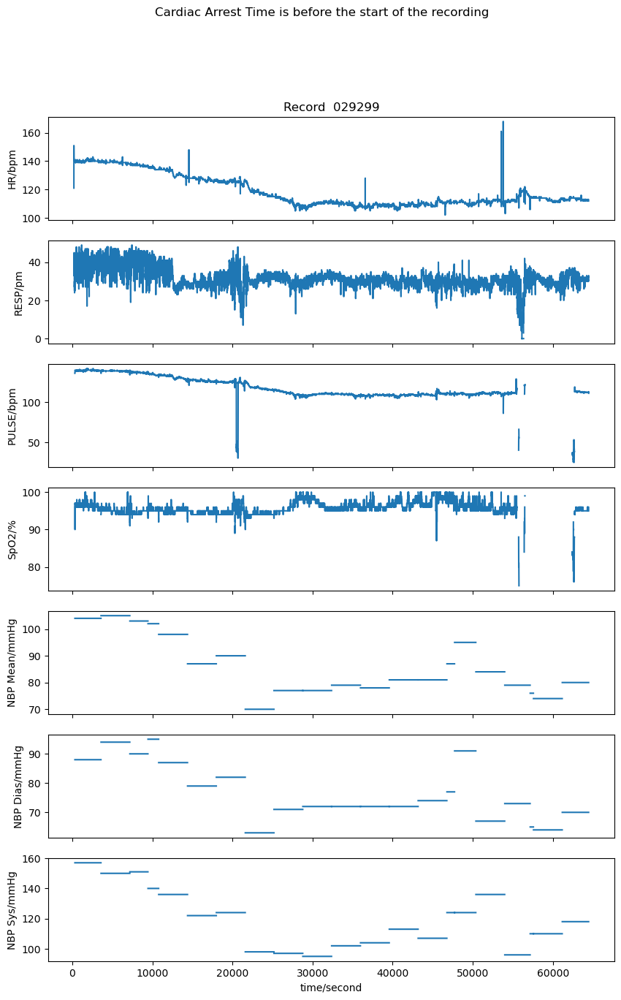

In [50]:
# This is a patient with cardiac arrest
patient_path = get_waveform_path('p029299', 'p029299-2192-12-06-20-01n')

# select only HR from patient path using wfdb
record = wfdb.rdrecord(patient_path, channel_names=CHANNEL_NAMES)
# record = wfdb.rdrecord(patient_path) 

# wfdb.plot_wfdb(record=record, title='Record  029299') 
# increase the size of the plot please
# wfdb.plot_wfdb(record=record, title='Record  029299', figsize=(10,15))

# Select only HR from the plots, not with the channels parameter
fig = wfdb.plot_wfdb(record=record, title='Record  029299', figsize=(10,15), return_fig=True)
ax_list = fig.axes

import datetime 

base_time = datetime.datetime.combine(record.__dict__['base_date'], 
                          record.__dict__['base_time'])

# Create datetime using strptime
ca_time = datetime.datetime.strptime('2192-11-21 07:38:00', '%Y-%m-%d %H:%M:%S')

# find time delta between base_time and ca_time
# Convert it to an int that represents the number of seconds
time_delta = int((ca_time - base_time).total_seconds())

# Plot a vertical line at time_delta
if time_delta > 0:
    for ax in ax_list:
        ax.axvline(x=time_delta, color='red', linestyle='--',)
else:
    # change title of fig
    fig.suptitle('Cardiac Arrest Time is before the start of the recording')

fig.show()

display(record.__dict__)

/var/folders/lc/wjv2l4cd19s4276v_sgzt_q40000gn/T/ipykernel_20431/798923300.py:35: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


{'record_name': 'p087675-2104-12-05-03-53n',
 'n_sig': 7,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 137280,
 'base_time': datetime.time(3, 53, 10),
 'base_date': datetime.date(2104, 12, 5),
 'comments': ['Location: sicu'],
 'sig_name': ['HR',
  'RESP',
  'PULSE',
  'SpO2',
  'NBP Mean',
  'NBP Dias',
  'NBP Sys'],
 'p_signal': array([[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3591887n.dat',
  '3591887n.dat',
  '3591887n.dat',
  '3591887n.dat',
  '3591887n.dat',
  '3591887n.dat',
  '3591887n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None, None, None],
 'byte_offse

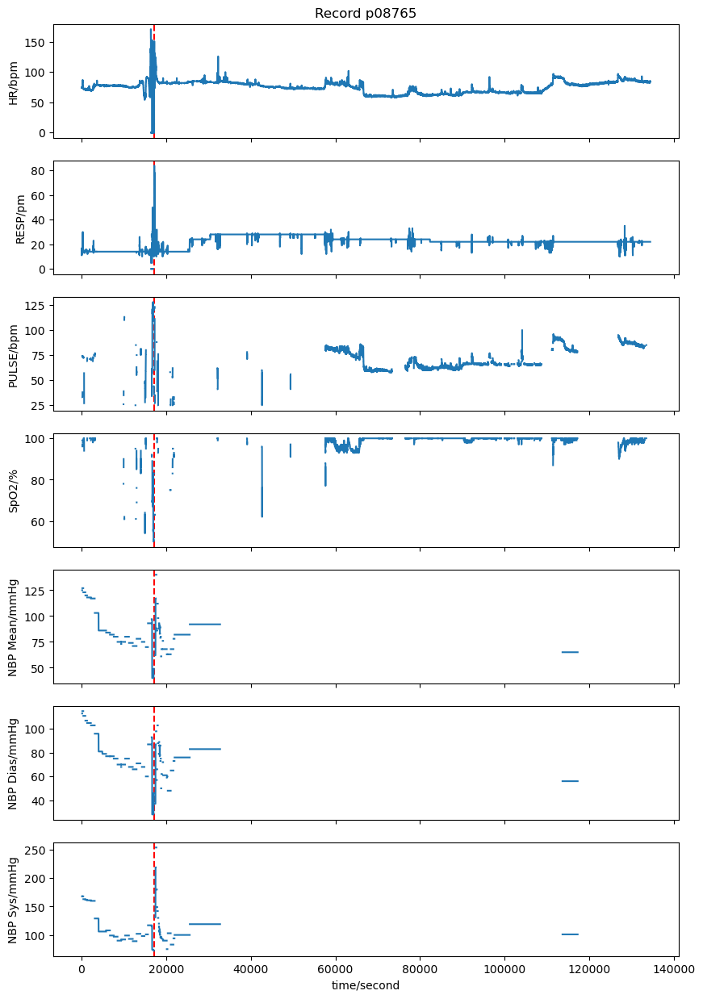

In [54]:
# This is a patient with cardiac arrest
patient_path = get_waveform_path('p087675', 'p087675-2104-12-05-03-53n')
# select only HR from patient path using wfdb
record = wfdb.rdrecord(patient_path, channel_names=CHANNEL_NAMES)
# record = wfdb.rdrecord(patient_path) 

# wfdb.plot_wfdb(record=record, title='Record  029299') 
# increase the size of the plot please
# wfdb.plot_wfdb(record=record, title='Record  029299', figsize=(10,15))

# Select only HR from the plots, not with the channels parameter
fig = wfdb.plot_wfdb(record=record, title='Record p08765', figsize=(10,15), return_fig=True)
ax_list = fig.axes

import datetime 

base_time = datetime.datetime.combine(record.__dict__['base_date'], 
                          record.__dict__['base_time'])

# Create datetime using strptime
ca_time = datetime.datetime.strptime('2104-12-05 08:40:00', '%Y-%m-%d %H:%M:%S')

# find time delta between base_time and ca_time
# Convert it to an int that represents the number of seconds
time_delta = int((ca_time - base_time).total_seconds())

# Plot a vertical line at time_delta
if time_delta > 0:
    for ax in ax_list:
        ax.axvline(x=time_delta, color='red', linestyle='--',)
else:
    # change title of fig
    fig.suptitle('Cardiac Arrest Time is before the start of the recording')

fig.show()

display(record.__dict__)

/var/folders/lc/wjv2l4cd19s4276v_sgzt_q40000gn/T/ipykernel_34028/1474199477.py:35: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


{'record_name': 'p070723-2163-11-18-16-28n',
 'n_sig': 5,
 'fs': 1,
 'counter_freq': None,
 'base_counter': None,
 'sig_len': 158241,
 'base_time': datetime.time(16, 28, 34),
 'base_date': datetime.date(2163, 11, 18),
 'comments': ['Location: micu/sicu'],
 'sig_name': ['HR', 'RESP', 'PULSE', 'SpO2', 'CVP'],
 'p_signal': array([[nan, nan, nan, nan, nan],
        [nan, nan, nan, nan, nan],
        [nan, nan, nan, nan, nan],
        ...,
        [nan, nan, nan, nan, nan],
        [nan, nan, nan, nan, nan],
        [nan, nan, nan, nan, nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3476173n.dat',
  '3476173n.dat',
  '3476173n.dat',
  '3476173n.dat',
  '3476173n.dat'],
 'fmt': ['16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1],
 'skew': [None, None, None, None, None],
 'byte_offset': [None, None, None, None, None],
 'adc_gain': [1.0, 1.0, 1.0, 1.0, 1.0],
 'baseline': [0, 0, 0, 0, 0],
 'units': ['bpm', 'pm', 'bpm', '%', 'mmHg'],
 'adc_re

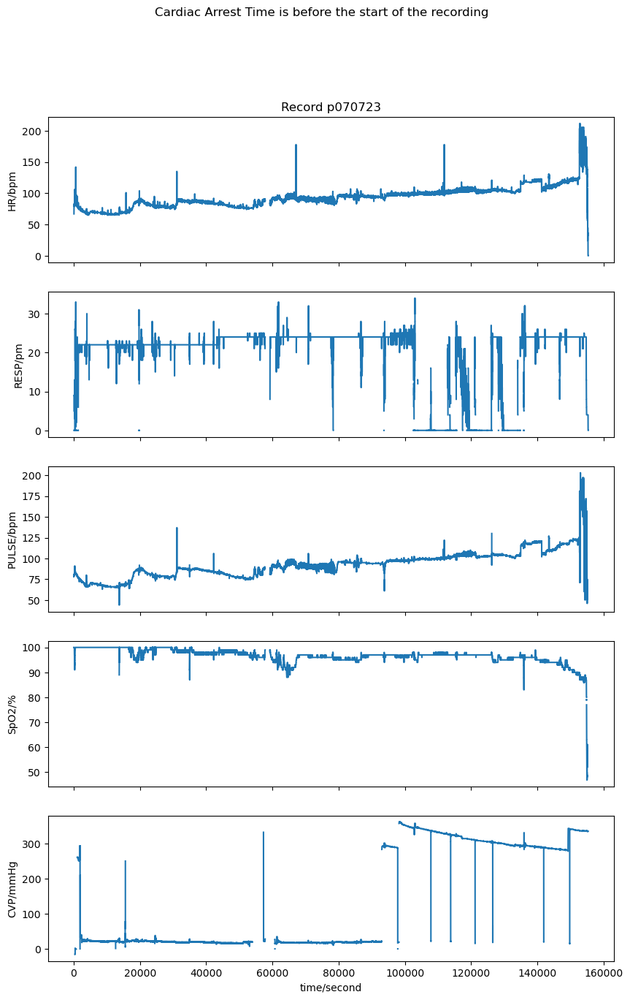

In [60]:

# This is a patient with cardiac arrest
patient_path = get_waveform_path('p070723', 'p070723-2163-11-18-16-28n')
# select only HR from patient path using wfdb
record = wfdb.rdrecord(patient_path, channel_names=CHANNEL_NAMES)
# record = wfdb.rdrecord(patient_path) 

# wfdb.plot_wfdb(record=record, title='Record  029299') 
# increase the size of the plot please
# wfdb.plot_wfdb(record=record, title='Record  029299', figsize=(10,15))

# Select only HR from the plots, not with the channels parameter
fig = wfdb.plot_wfdb(record=record, title='Record p070723', figsize=(10,15), return_fig=True)
ax_list = fig.axes

import datetime 

base_time = datetime.datetime.combine(record.__dict__['base_date'], 
                          record.__dict__['base_time'])

# Create datetime using strptime
ca_time = datetime.datetime.strptime('2163-11-18 10:40:00', '%Y-%m-%d %H:%M:%S')

# find time delta between base_time and ca_time
# Convert it to an int that represents the number of seconds
time_delta = int((ca_time - base_time).total_seconds())

# Plot a vertical line at time_delta
if time_delta > 0:
    for ax in ax_list:
        ax.axvline(x=time_delta, color='red', linestyle='--',)
else:
    # change title of fig
    fig.suptitle('Cardiac Arrest Time is before the start of the recording')

fig.show()

display(record.__dict__)

In [73]:

record_df = record.to_dataframe()

# Given a dataframe record_df that has datetimeindex, 
# write code that create numpy arrays with a sliding window of 10 minutes with a stride of 1 minute.
# The output should be a list of numpy arrays, each numpy array is a 10 minute window of the record_df
# The first numpy array should start at the beginning of the record_df
# The last numpy array should end at the end of the record_df
# The length of the list should be the number of 10 minute windows in the record_df
# Write code below:
# Take 5 seconds of every datettimeindex
record_df = record_df.iloc[::5, :]

# Which means that each should have 120 records
record_arr = np.stack([record_df.iloc[i:i+int(600/5), :].values for i in range(0, len(record_df)-int(600/5), int(60/5))])
record_arr

array([[[ nan,  nan,  nan,  nan,  nan],
        [ nan,  nan,  nan,  nan,  nan],
        [ nan,  nan,  nan,  nan,  nan],
        ...,
        [ 82.,  18.,  82., 100.,   0.],
        [124.,  17.,  82., 100.,   0.],
        [124.,  18.,  82., 100.,   0.]],

       [[ nan,  nan,  79., 100.,  nan],
        [ nan,  nan,  79., 100.,  nan],
        [ nan,  nan,  79., 100.,  nan],
        ...,
        [ 82.,  nan,  82., 100.,   0.],
        [ 82.,   0.,  82., 100.,   0.],
        [ 82.,  nan,  82., 100.,   0.]],

       [[ 79.,   0.,  80., 100.,  nan],
        [ 79.,   0.,  79., 100.,  nan],
        [ 79.,   0.,  79., 100.,  nan],
        ...,
        [ 82.,   0.,  82., 100.,   0.],
        [ 82.,   0.,  82., 100.,   0.],
        [ 82.,   0.,  81., 100.,   0.]],

       ...,

       [[ nan,  nan,  nan,  nan,  nan],
        [ nan,  nan,  nan,  nan,  nan],
        [ nan,  nan,  nan,  nan,  nan],
        ...,
        [ nan,  nan,  nan,  nan,  nan],
        [ nan,  nan,  nan,  nan,  nan],
        [

In [65]:
record_df

,HR,RESP,PULSE,SpO2,CVP
2163-11-18 16:28:34,NaN,NaN,NaN,NaN,NaN
2163-11-18 16:28:39,NaN,NaN,NaN,NaN,NaN
2163-11-18 16:28:44,NaN,NaN,NaN,NaN,NaN
2163-11-18 16:28:49,NaN,NaN,NaN,NaN,NaN
2163-11-18 16:28:54,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2163-11-20 12:25:34,NaN,NaN,NaN,NaN,NaN
2163-11-20 12:25:39,NaN,NaN,NaN,NaN,NaN
2163-11-20 12:25:44,NaN,NaN,NaN,NaN,NaN
2163-11-20 12:25:49,NaN,NaN,NaN,NaN,NaN


In [74]:
record_arr.shape

(2628, 120, 5)

In [75]:
record_arr.reshape(120,5,2628)

array([[[ nan,  nan,  nan, ...,  84.,   0.,  84.],
        [100.,   0.,  84., ..., 100.,  nan,  80.],
        [ 22.,  80., 100., ...,  nan,  80., 100.],
        [ nan,  97.,  nan, ..., 257.,  78.,  nan],
        [ 78., 100., 257., ...,  76., 100., 252.]],

       [[ 76.,  22.,  76., ...,  76.,  22.,  76.],
        [100., 253.,  76., ..., 100.,  31.,  74.],
        [ 22.,  74., 100., ...,  22.,  74., 100.],
        [ nan,  74.,  22., ...,  23.,  72.,  22.],
        [ 72., 100.,  23., ...,  70., 100.,  23.]],

       [[ 70.,  22.,  71., ...,  71.,  22.,  71.],
        [100.,  24.,  71., ..., 100.,  22.,  69.],
        [ 20.,  68., 100., ...,  21.,  68., 100.],
        [ 21.,  69.,  22., ...,  23.,  69.,  22.],
        [ 67., 100.,  24., ...,  67., 100.,  24.]],

       ...,

       [[176.,  24., 183., ..., 154.,  24., 106.],
        [ 88., 336., 152., ...,  88., 336., 162.],
        [ 24.,  88.,  88., ...,  13., 131.,  87.],
        [336., 174.,  13., ..., 335.,  39.,   4.],
        [ na

Reading a waveform
From demo https://github.com/MIT-LCP/wfdb-python/blob/main/demo.ipynb

- Matching waveforms to hospital admissions: I am currently trying to match specific waveforms from the Matched Waveform subset to hospital admission ids (HADM_ID) in the admissions table. Currently, I am iterating through and comparing admission times and discharge times of a subject with the time that the waveform began recording (extracted from the filename). [Source](https://github.com/MIT-LCP/mimic-code/issues/438)

In [15]:
patient_path = get_waveform_path('p000194', 'p000194-2112-05-23-14-34')

record = wfdb.rdrecord(patient_path) 

wfdb.plot_wfdb(record=record, title='Record a103l from PhysioNet Challenge 2015') 
display(record.__dict__)

FileNotFoundError: [Errno 2] No such file or directory: '/Users/michaelscott/bd4h/project/data/waveform/physionet.org/files/mimic3wdb-matched/1.0/p00/p000194/p029299-2192-12-06-20-01n.hea'

In [17]:
record_df = record.to_dataframe()
record_df

,II
2112-05-23 14:34:23.221,NaN
2112-05-23 14:34:23.229,NaN
2112-05-23 14:34:23.237,NaN
2112-05-23 14:34:23.245,NaN
2112-05-23 14:34:23.253,NaN
...,...
2112-05-24 17:40:05.349,0.0
2112-05-24 17:40:05.357,0.0
2112-05-24 17:40:05.365,0.0
2112-05-24 17:40:05.373,0.0


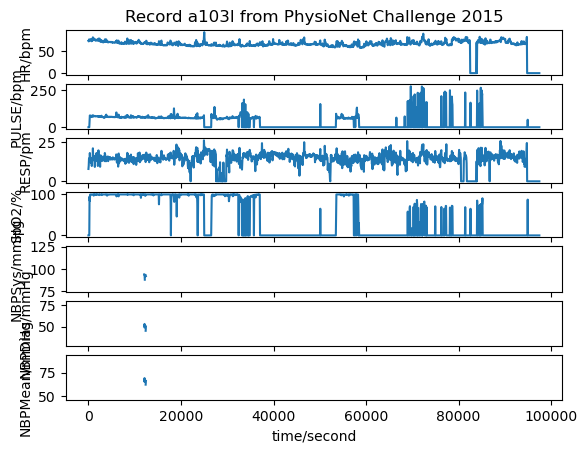

{'record_name': 'p000194-2112-05-23-14-34n',
 'n_sig': 7,
 'fs': 0.0166666666667,
 'counter_freq': 125.0,
 'base_counter': None,
 'sig_len': 1625,
 'base_time': datetime.time(14, 34, 23, 221000),
 'base_date': datetime.date(2112, 5, 23),
 'comments': [],
 'sig_name': ['HR', 'PULSE', 'RESP', 'SpO2', 'NBPSys', 'NBPDias', 'NBPMean'],
 'p_signal': array([[ 73.6,   0. ,   7.9, ...,   nan,   nan,   nan],
        [ 72.3,   0. ,  10. , ..., 120. ,  66. ,  86. ],
        [ 76.8,   0. ,  14.4, ...,   nan,   nan,   nan],
        ...,
        [  0. ,   0. ,   0. , ...,   nan,   nan,   nan],
        [  0. ,   0. ,   0. , ...,   nan,   nan,   nan],
        [  0. ,   0. ,   0. , ...,   nan,   nan,   nan]]),
 'd_signal': None,
 'e_p_signal': None,
 'e_d_signal': None,
 'file_name': ['3400942n.dat',
  '3400942n.dat',
  '3400942n.dat',
  '3400942n.dat',
  '3400942n.dat',
  '3400942n.dat',
  '3400942n.dat'],
 'fmt': ['16', '16', '16', '16', '16', '16', '16'],
 'samps_per_frame': [1, 1, 1, 1, 1, 1, 1],
 '

In [18]:
patient_path = get_waveform_path('p000194', 'p000194-2112-05-23-14-34n')

record = wfdb.rdrecord(patient_path) 

wfdb.plot_wfdb(record=record, title='Record a103l from PhysioNet Challenge 2015') 
display(record.__dict__)

In [19]:
record.__dict__['p_signal']


array([[ 73.6,   0. ,   7.9, ...,   nan,   nan,   nan],
       [ 72.3,   0. ,  10. , ..., 120. ,  66. ,  86. ],
       [ 76.8,   0. ,  14.4, ...,   nan,   nan,   nan],
       ...,
       [  0. ,   0. ,   0. , ...,   nan,   nan,   nan],
       [  0. ,   0. ,   0. , ...,   nan,   nan,   nan],
       [  0. ,   0. ,   0. , ...,   nan,   nan,   nan]])

In [20]:
record.fs

0.0166666666667

In [21]:
record.to_dataframe() # Verified that the data is indeed coming in at 0.0166666666667 s apart

,HR,PULSE,RESP,SpO2,NBPSys,NBPDias,NBPMean
2112-05-23 14:34:23.221000000,73.6,0.0,7.9,0.0,NaN,NaN,NaN
2112-05-23 14:35:23.220999999,72.3,0.0,10.0,0.0,120.0,66.0,86.0
2112-05-23 14:36:23.220999998,76.8,0.0,14.4,0.0,NaN,NaN,NaN
2112-05-23 14:37:23.220999997,74.9,0.0,14.8,0.0,NaN,NaN,NaN
2112-05-23 14:38:23.220999996,75.3,41.6,14.0,94.8,NaN,NaN,NaN
...,...,...,...,...,...,...,...
2112-05-24 17:34:23.220998380,0.0,0.0,0.0,0.0,NaN,NaN,NaN
2112-05-24 17:35:23.220998379,0.0,0.0,0.0,0.0,NaN,NaN,NaN
2112-05-24 17:36:23.220998378,0.0,0.0,0.0,0.0,NaN,NaN,NaN
2112-05-24 17:37:23.220998377,0.0,0.0,0.0,0.0,NaN,NaN,NaN


<!-- diag_df = pd.read_csv(f'{MIMICPATH}/DIAGNOSES_ICD.csv.gz',compression='gzip') -->

In [22]:
record_df = record.to_dataframe()
record_df
record_df = spark.createDataFrame(record_df.reset_index())

/Users/michaelscott/opt/anaconda3/envs/bd4hproject/lib/python3.9/site-packages/pyspark/sql/pandas/conversion.py:474: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column, series in pdf.iteritems():
/Users/michaelscott/opt/anaconda3/envs/bd4hproject/lib/python3.9/site-packages/pyspark/sql/pandas/conversion.py:486: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column, series in pdf.iteritems():


In [23]:
record_df

DataFrame[index: timestamp, HR: double, PULSE: double, RESP: double, SpO2: double, NBPSys: double, NBPDias: double, NBPMean: double]

In [ ]:
record_df = spark.createDataFrame(record_df.reset_index())

In [24]:
record_df

DataFrame[index: timestamp, HR: double, PULSE: double, RESP: double, SpO2: double, NBPSys: double, NBPDias: double, NBPMean: double]

In [25]:
# from pyspark.streaming import StreamingContext
# ssc = StreamingContext(sc, 1)
# inputStream = ssc.socketTextStream("localhost", 9999)

# outputStream = inputStream.flatMap(lambda line: line.split(" "))
# # inputStream = ssc.queueStream([record_df])
# # outputStream = inputStream
# inputStream.pprint()

# ssc.start()